In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

%matplotlib inline


bif_c = 0.2
num_iter_max=200000


# alpha=0.1
# alpha=0.2
alpha=0.3
# alpha=0.5


# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
figfilenamehead = "fig_policy_evaluation_"

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



c = 0.21455680991172585
2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [ ]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
             "bamdp_policy":None,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt
load vi_base_ckpt


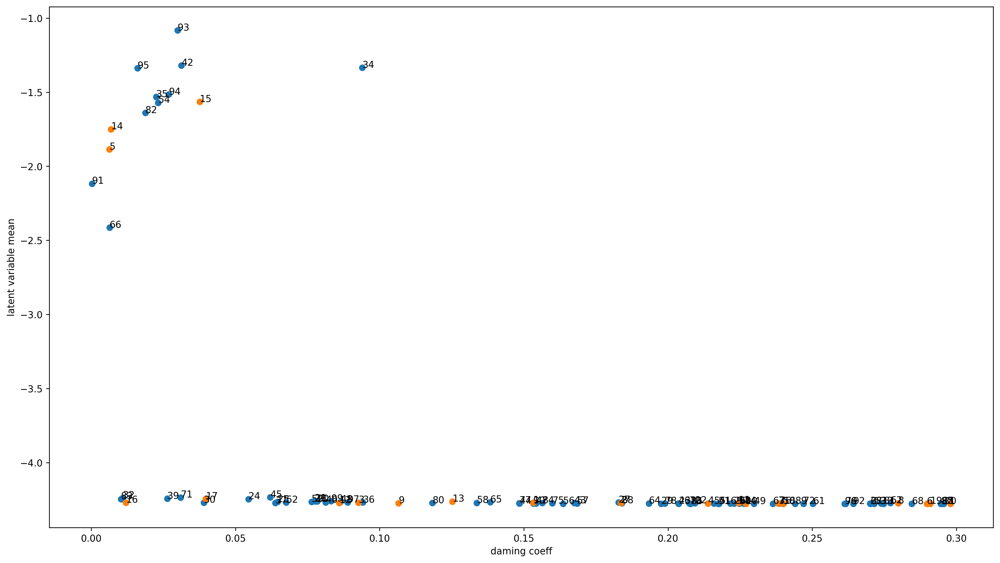

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_iter0.eps")
plt.savefig(figfilenamehead+"damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  c = 0.16346495489906906
1  c = 0.175923049855898
2  c = 0.213101048692264
3  c = 0.14501806056071762
4  c = 0.004052611988015664
5  c = 0.120134560420777


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

6  c = 0.25697024030079035
7  c = 0.09642657758269942
8  c = 0.05526129195564814
9  c = 0.11417486037608537
10  c = 0.25864988011260814
11  c = 0.020876132555705383
12  c = 0.2613891486606151
13  c = 0.10624180953664825
14  c = 0.03203027777652895
15  c = 0.1622476552961531
16  c = 0.1618277342655034
17  c = 0.055320312028603325
18  c = 0.09391364165595244
19  c = 0.11885913261799258
20  c = 0.11403897859981632
21  c = 0.09912067121474619
22  c = 0.06488189030041151
23  c = 0.03506631058301788
24  c = 0.19965083813641546
25  c = 0.08571604451747712
26  c = 0.1514796791677473
27  c = 0.04546713757372708
28  c = 0.13733918450179566
29  c = 0.1522597624567635
30  c = 0.02389789952996266
31  c = 0.0638122346167221
32  c = 0.28146488121321594
33  c = 0.2259386184773079
34  c = 0.28977259206899
35  c = 0.15402135084365112
36  c = 0.14479756250669107
37  c = 0.013467426965231165
38  c = 0.28867430773725383
39  c = 0.13289400919772665
40  c = 0.25571722661756824
41  c = 0.12667222437581357
42 

In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  c = 0.20021770810986864
1  c = 0.1983582812192558
2  c = 0.022555950291700478
3  c = 0.20541677419620874
4  c = 0.10100278390403257
5  c = 0.18626578567738697
6  c = 0.05051976271514567
7  c = 0.047219332290270255
8  c = 0.1703964189334006
9  c = 0.14840815680292022
10  c = 0.24494872822400177
11  c = 0.025342155733352467
12  c = 0.29120495159551035
13  c = 0.1062823595846313
14  c = 0.2005682341251094
15  c = 0.2575002131665844
16  c = 0.2478069086585581
17  c = 0.10556652164894924
18  c = 0.1263102409001565
19  c = 0.06421935796424785
20  c = 0.162199131307732
21  c = 0.2946662208960819
22  c = 0.07020726813281049
23  c = 0.15752760672287627
24  c = 0.08439030047625135
25  c = 0.07330712053657978
26  c = 0.1016651025954488
27  c = 0.006908891882512702
28  c = 0.1901597193331265
29  c = 0.1863173542495256
30  c = 0.15759887301895484
31  c = 0.0308689768266279
32  c = 0.24135050248338633
33  c = 0.2181328493603175
34  c = 0.10463073088503207
35  c = 0.04975650100345974
36  c = 0.179

95  c = 0.2501007404391354
predict diverge [ 10.74036884 774.70859349]
96  c = 0.03765543221993569
97  c = 0.1447889054074812
98  c = 0.03610528656962901
99  c = 0.2376621125429203
 
実環境方策rollout vs Sim環境方策rollout


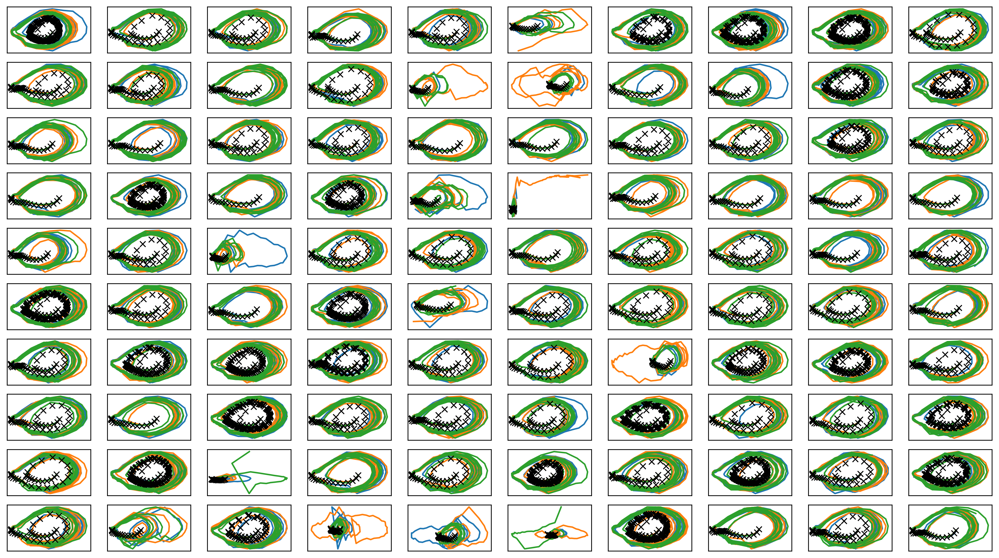

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter0.png")
plt.savefig(figfilenamehead+"joint_iter0.eps")
plt.savefig(figfilenamehead+"joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-04-04 01:35:17.885901


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.21173578446774205
c = 0.29613616116266267
c = 0.14261381247187307
c = 0.03134266417929309
c = 0.18768298619818488
c = 0.22746078515527657
c = 0.008477972314120097
1  c = 0.13479512447911798
c = 0.06128484916266449
c = 0.05153926393648715
c = 0.014095977336605158
c = 0.18640047639474708
c = 0.06696579973468546
c = 0.07418226119295034
c = 0.09801626505407315
c = 0.18738733329715648
2  c = 0.27552350639993944
c = 0.08638976355194454
c = 0.28650721828062853
c = 0.16757616581017884
c = 0.036303648522769905
c = 0.01886908811769725
c = 0.054504068698648656
c = 0.048511950143705636
c = 0.20357742157999598
c = 0.10243203801547246
c = 0.2009294802726103
c = 0.03233228597029623
3  c = 0.21626150878014552
c = 0.29526741876491275
c = 0.06555089226877321
c = 0.032139462474833076
c = 0.014239526318916906
c = 0.030234364519274526
c = 0.06154806697686888
4  c = 0.13527723677806278
c = 0.17707470996570454
c = 0.16786738404595006
c = 0.2476335009210234
c = 0.04045709864191702
c = 0.2238645530952

38  c = 0.05414976646955378
c = 0.19474931128722503
c = 0.28029962292362426
39  c = 0.017552532603062696
c = 0.06880490477533516
c = 0.03636056027400455
c = 0.016740400240395147
c = 0.20328694319617366
c = 0.08732037994367649
c = 0.10160571740539676
c = 0.06244627098091553
c = 0.1607209741667111
c = 0.1673849010506581
c = 0.2547219131447462
c = 0.10949415099267686
40  c = 0.1438521778683718
c = 0.11683210178109851
c = 0.07363771733319534
c = 0.03502177363594132
c = 0.24164893644104615
c = 0.17990015746807014
c = 0.24630547771384065
c = 0.0793861288033493
c = 0.28167872419885537
41  c = 0.2842304703941272
c = 0.2453951911476671
c = 0.10380060900923867
c = 0.2917185138651958
c = 0.16991292318500875
c = 0.02388665906696481
c = 0.05869218720214346
c = 0.10752058174220852
c = 0.23570631462068609
c = 0.16870487119724586
c = 0.09648756250162162
c = 0.2294975425219668
c = 0.18106195108554904
c = 0.059564674381799465
c = 0.029802557763132842
42  c = 0.11323842452961597
c = 0.20464121823317646
c

c = 0.0919508737174415
c = 0.024145069642529316
c = 0.2431324367519625
c = 0.09773301119473328
c = 0.044703275130937026
c = 0.2231620948552856
c = 0.09451066633017778
c = 0.23423703993439537
75  c = 0.003457988384497879
c = 0.1004404104132788
c = 0.16212949223361264
c = 0.012434899568175239
c = 0.2230944350080472
c = 0.2267456976119428
c = 0.07216053077786413
c = 0.06829734616621834
c = 0.15405752470080883
c = 0.11914490706706528
76  c = 0.2518869850810772
c = 0.0067099979865313355
c = 0.03663865137166565
c = 0.1471720822141774
c = 0.12929540079698054
c = 0.23082251192246242
c = 0.0876400526682163
77  c = 0.21375367840521042
c = 0.18405974814048967
c = 0.10988467442475998
c = 0.18790349518310207
c = 0.08961451462666815
c = 0.2771888968951758
c = 0.2987503474678797
c = 0.03529722839723291
c = 0.2584529873719788
c = 0.0010379018920250616
c = 0.2805684681792523
c = 0.05237333121805956
c = 0.026822237455981533
78  c = 0.2388796244338437
c = 0.10626539922124115
c = 0.20555535694285587
c = 0

In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.35902  validloss 1.40042±0.00000  bestvalidloss 1.40042  last_update 0
train: iter 1  trainloss 1.20719  validloss 1.31225±0.00000  bestvalidloss 1.31225  last_update 0
train: iter 2  trainloss 0.98563  validloss 1.08707±0.00000  bestvalidloss 1.08707  last_update 0
train: iter 3  trainloss 0.86266  validloss 0.91184±0.00000  bestvalidloss 0.91184  last_update 0
train: iter 4  trainloss 0.79597  validloss 0.82961±0.00000  bestvalidloss 0.82961  last_update 0
train: iter 5  trainloss 0.74478  validloss 0.77549±0.00000  bestvalidloss 0.77549  last_update 0
train: iter 6  trainloss 0.69136  validloss 0.72425±0.00000  bestvalidloss 0.72425  last_update 0
train: iter 7  trainloss 0.64599  validloss 0.67672±0.00000  bestvalidloss 0.67672  last_update 0
train: iter 8  trainloss 0.61455  validloss 0.64781±0.00000  bestvalidloss 0.64781  last_update 0
train: iter 9  trainloss 0.58455  validloss 0.61555±0.00000  bestvalidloss 0.61555  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.30306  validloss 0.34135±0.00000  bestvalidloss 0.33330  last_update 1
train: iter 85  trainloss 0.30445  validloss 0.33357±0.00000  bestvalidloss 0.33330  last_update 2
train: iter 86  trainloss 0.30121  validloss 0.33151±0.00000  bestvalidloss 0.33151  last_update 0
train: iter 87  trainloss 0.29956  validloss 0.33094±0.00000  bestvalidloss 0.33094  last_update 0
train: iter 88  trainloss 0.29839  validloss 0.33226±0.00000  bestvalidloss 0.33094  last_update 1
train: iter 89  trainloss 0.30211  validloss 0.32908±0.00000  bestvalidloss 0.32908  last_update 0
train: iter 90  trainloss 0.30087  validloss 0.34043±0.00000  bestvalidloss 0.32908  last_update 1
train: iter 91  trainloss 0.29728  validloss 0.32799±0.00000  bestvalidloss 0.32799  last_update 0
train: iter 92  trainloss 0.29523  validloss 0.32726±0.00000  bestvalidloss 0.32726  last_update 0
train: iter 93  trainloss 0.29528  validloss 0.32482±0.00000  bestvalidloss 0.32482  last_update 0
train: ite

train: iter 167  trainloss 0.26305  validloss 0.30870±0.00000  bestvalidloss 0.29703  last_update 1
train: iter 168  trainloss 0.26585  validloss 0.30270±0.00000  bestvalidloss 0.29703  last_update 2
train: iter 169  trainloss 0.26121  validloss 0.29766±0.00000  bestvalidloss 0.29703  last_update 3
train: iter 170  trainloss 0.26343  validloss 0.30245±0.00000  bestvalidloss 0.29703  last_update 4
train: iter 171  trainloss 0.26119  validloss 0.30838±0.00000  bestvalidloss 0.29703  last_update 5
train: iter 172  trainloss 0.26263  validloss 0.30006±0.00000  bestvalidloss 0.29703  last_update 6
train: iter 173  trainloss 0.26323  validloss 0.31125±0.00000  bestvalidloss 0.29703  last_update 7
train: iter 174  trainloss 0.25907  validloss 0.29881±0.00000  bestvalidloss 0.29703  last_update 8
train: iter 175  trainloss 0.26110  validloss 0.30515±0.00000  bestvalidloss 0.29703  last_update 9
train: iter 176  trainloss 0.26143  validloss 0.30040±0.00000  bestvalidloss 0.29703  last_update 10

train: iter 250  trainloss 0.24706  validloss 0.28484±0.00000  bestvalidloss 0.28174  last_update 4
train: iter 251  trainloss 0.24611  validloss 0.28262±0.00000  bestvalidloss 0.28174  last_update 5
train: iter 252  trainloss 0.24575  validloss 0.28577±0.00000  bestvalidloss 0.28174  last_update 6
train: iter 253  trainloss 0.24553  validloss 0.28348±0.00000  bestvalidloss 0.28174  last_update 7
train: iter 254  trainloss 0.24450  validloss 0.28373±0.00000  bestvalidloss 0.28174  last_update 8
train: iter 255  trainloss 0.24520  validloss 0.28145±0.00000  bestvalidloss 0.28145  last_update 0
train: iter 256  trainloss 0.24703  validloss 0.28631±0.00000  bestvalidloss 0.28145  last_update 1
train: iter 257  trainloss 0.24363  validloss 0.28364±0.00000  bestvalidloss 0.28145  last_update 2
train: iter 258  trainloss 0.24349  validloss 0.28098±0.00000  bestvalidloss 0.28098  last_update 0
train: iter 259  trainloss 0.24450  validloss 0.28204±0.00000  bestvalidloss 0.28098  last_update 1


train: iter 333  trainloss 0.23880  validloss 0.29067±0.00000  bestvalidloss 0.27364  last_update 5
train: iter 334  trainloss 0.23997  validloss 0.27477±0.00000  bestvalidloss 0.27364  last_update 6
train: iter 335  trainloss 0.23512  validloss 0.27383±0.00000  bestvalidloss 0.27364  last_update 7
train: iter 336  trainloss 0.23418  validloss 0.27332±0.00000  bestvalidloss 0.27332  last_update 0
train: iter 337  trainloss 0.23715  validloss 0.27423±0.00000  bestvalidloss 0.27332  last_update 1
train: iter 338  trainloss 0.24270  validloss 0.28487±0.00000  bestvalidloss 0.27332  last_update 2
train: iter 339  trainloss 0.23626  validloss 0.27711±0.00000  bestvalidloss 0.27332  last_update 3
train: iter 340  trainloss 0.23691  validloss 0.27568±0.00000  bestvalidloss 0.27332  last_update 4
train: iter 341  trainloss 0.23557  validloss 0.27346±0.00000  bestvalidloss 0.27332  last_update 5
train: iter 342  trainloss 0.23541  validloss 0.27263±0.00000  bestvalidloss 0.27263  last_update 0


train: iter 416  trainloss 0.22781  validloss 0.26696±0.00000  bestvalidloss 0.26677  last_update 7
train: iter 417  trainloss 0.22907  validloss 0.26904±0.00000  bestvalidloss 0.26677  last_update 8
train: iter 418  trainloss 0.23221  validloss 0.26711±0.00000  bestvalidloss 0.26677  last_update 9
train: iter 419  trainloss 0.22884  validloss 0.26635±0.00000  bestvalidloss 0.26635  last_update 0
train: iter 420  trainloss 0.22831  validloss 0.26904±0.00000  bestvalidloss 0.26635  last_update 1
train: iter 421  trainloss 0.22773  validloss 0.26788±0.00000  bestvalidloss 0.26635  last_update 2
train: iter 422  trainloss 0.23152  validloss 0.26896±0.00000  bestvalidloss 0.26635  last_update 3
train: iter 423  trainloss 0.22856  validloss 0.26755±0.00000  bestvalidloss 0.26635  last_update 4
train: iter 424  trainloss 0.23267  validloss 0.27722±0.00000  bestvalidloss 0.26635  last_update 5
train: iter 425  trainloss 0.22822  validloss 0.26763±0.00000  bestvalidloss 0.26635  last_update 6


train: iter 500  trainloss 0.22321  validloss 0.26246±0.00000  bestvalidloss 0.26034  last_update 7
train: iter 501  trainloss 0.22088  validloss 0.26101±0.00000  bestvalidloss 0.26034  last_update 8
train: iter 502  trainloss 0.22300  validloss 0.26313±0.00000  bestvalidloss 0.26034  last_update 9
train: iter 503  trainloss 0.22299  validloss 0.26260±0.00000  bestvalidloss 0.26034  last_update 10
train: iter 504  trainloss 0.22483  validloss 0.26945±0.00000  bestvalidloss 0.26034  last_update 11
train: iter 505  trainloss 0.22224  validloss 0.26662±0.00000  bestvalidloss 0.26034  last_update 12
train: iter 506  trainloss 0.22336  validloss 0.26067±0.00000  bestvalidloss 0.26034  last_update 13
train: iter 507  trainloss 0.22278  validloss 0.26255±0.00000  bestvalidloss 0.26034  last_update 14
train: iter 508  trainloss 0.22335  validloss 0.26355±0.00000  bestvalidloss 0.26034  last_update 15
train: iter 509  trainloss 0.22294  validloss 0.26340±0.00000  bestvalidloss 0.26034  last_upd

train: iter 585  trainloss 0.21710  validloss 0.25707±0.00000  bestvalidloss 0.25553  last_update 8
train: iter 586  trainloss 0.21718  validloss 0.25707±0.00000  bestvalidloss 0.25553  last_update 9
train: iter 587  trainloss 0.21850  validloss 0.25898±0.00000  bestvalidloss 0.25553  last_update 10
train: iter 588  trainloss 0.21764  validloss 0.25670±0.00000  bestvalidloss 0.25553  last_update 11
train: iter 589  trainloss 0.21666  validloss 0.25655±0.00000  bestvalidloss 0.25553  last_update 12
train: iter 590  trainloss 0.21820  validloss 0.25686±0.00000  bestvalidloss 0.25553  last_update 13
train: iter 591  trainloss 0.21639  validloss 0.25426±0.00000  bestvalidloss 0.25426  last_update 0
train: iter 592  trainloss 0.21804  validloss 0.25669±0.00000  bestvalidloss 0.25426  last_update 1
train: iter 593  trainloss 0.21706  validloss 0.25467±0.00000  bestvalidloss 0.25426  last_update 2
train: iter 594  trainloss 0.21585  validloss 0.25487±0.00000  bestvalidloss 0.25426  last_updat

train: iter 668  trainloss 0.21382  validloss 0.25282±0.00000  bestvalidloss 0.25172  last_update 10
train: iter 669  trainloss 0.21359  validloss 0.25683±0.00000  bestvalidloss 0.25172  last_update 11
train: iter 670  trainloss 0.21183  validloss 0.25268±0.00000  bestvalidloss 0.25172  last_update 12
train: iter 671  trainloss 0.21381  validloss 0.25457±0.00000  bestvalidloss 0.25172  last_update 13
train: iter 672  trainloss 0.21297  validloss 0.25148±0.00000  bestvalidloss 0.25148  last_update 0
train: iter 673  trainloss 0.21329  validloss 0.25842±0.00000  bestvalidloss 0.25148  last_update 1
train: iter 674  trainloss 0.21162  validloss 0.25213±0.00000  bestvalidloss 0.25148  last_update 2
train: iter 675  trainloss 0.21290  validloss 0.25292±0.00000  bestvalidloss 0.25148  last_update 3
train: iter 676  trainloss 0.21205  validloss 0.26219±0.00000  bestvalidloss 0.25148  last_update 4
train: iter 677  trainloss 0.21257  validloss 0.25295±0.00000  bestvalidloss 0.25148  last_updat

train: iter 751  trainloss 0.20927  validloss 0.25031±0.00000  bestvalidloss 0.24842  last_update 2
train: iter 752  trainloss 0.20886  validloss 0.25211±0.00000  bestvalidloss 0.24842  last_update 3
train: iter 753  trainloss 0.21258  validloss 0.25236±0.00000  bestvalidloss 0.24842  last_update 4
train: iter 754  trainloss 0.20854  validloss 0.24846±0.00000  bestvalidloss 0.24842  last_update 5
train: iter 755  trainloss 0.20848  validloss 0.24864±0.00000  bestvalidloss 0.24842  last_update 6
train: iter 756  trainloss 0.20823  validloss 0.24836±0.00000  bestvalidloss 0.24836  last_update 0
train: iter 757  trainloss 0.20796  validloss 0.24860±0.00000  bestvalidloss 0.24836  last_update 1
train: iter 758  trainloss 0.21070  validloss 0.25554±0.00000  bestvalidloss 0.24836  last_update 2
train: iter 759  trainloss 0.21242  validloss 0.25104±0.00000  bestvalidloss 0.24836  last_update 3
train: iter 760  trainloss 0.20779  validloss 0.24996±0.00000  bestvalidloss 0.24836  last_update 4


train: iter 835  trainloss 0.20695  validloss 0.24689±0.00000  bestvalidloss 0.24572  last_update 3
train: iter 836  trainloss 0.20917  validloss 0.24706±0.00000  bestvalidloss 0.24572  last_update 4
train: iter 837  trainloss 0.20492  validloss 0.25386±0.00000  bestvalidloss 0.24572  last_update 5
train: iter 838  trainloss 0.20604  validloss 0.24765±0.00000  bestvalidloss 0.24572  last_update 6
train: iter 839  trainloss 0.20668  validloss 0.24858±0.00000  bestvalidloss 0.24572  last_update 7
train: iter 840  trainloss 0.20703  validloss 0.25022±0.00000  bestvalidloss 0.24572  last_update 8
train: iter 841  trainloss 0.20899  validloss 0.24625±0.00000  bestvalidloss 0.24572  last_update 9
train: iter 842  trainloss 0.20571  validloss 0.25582±0.00000  bestvalidloss 0.24572  last_update 10
train: iter 843  trainloss 0.20474  validloss 0.24773±0.00000  bestvalidloss 0.24572  last_update 11
train: iter 844  trainloss 0.20728  validloss 0.25682±0.00000  bestvalidloss 0.24572  last_update 

train: iter 920  trainloss 0.20401  validloss 0.24708±0.00000  bestvalidloss 0.24410  last_update 4
train: iter 921  trainloss 0.20317  validloss 0.24931±0.00000  bestvalidloss 0.24410  last_update 5
train: iter 922  trainloss 0.20337  validloss 0.24526±0.00000  bestvalidloss 0.24410  last_update 6
train: iter 923  trainloss 0.20424  validloss 0.24482±0.00000  bestvalidloss 0.24410  last_update 7
train: iter 924  trainloss 0.20389  validloss 0.24455±0.00000  bestvalidloss 0.24410  last_update 8
train: iter 925  trainloss 0.20285  validloss 0.24395±0.00000  bestvalidloss 0.24395  last_update 0
train: iter 926  trainloss 0.20205  validloss 0.24508±0.00000  bestvalidloss 0.24395  last_update 1
train: iter 927  trainloss 0.20572  validloss 0.24357±0.00000  bestvalidloss 0.24357  last_update 0
train: iter 928  trainloss 0.20373  validloss 0.24618±0.00000  bestvalidloss 0.24357  last_update 1
train: iter 929  trainloss 0.20217  validloss 0.24705±0.00000  bestvalidloss 0.24357  last_update 2


train: iter 1004  trainloss 0.20035  validloss 0.24508±0.00000  bestvalidloss 0.24244  last_update 13
train: iter 1005  trainloss 0.20126  validloss 0.24452±0.00000  bestvalidloss 0.24244  last_update 14
train: iter 1006  trainloss 0.20150  validloss 0.25474±0.00000  bestvalidloss 0.24244  last_update 15
train: iter 1007  trainloss 0.20309  validloss 0.24582±0.00000  bestvalidloss 0.24244  last_update 16
train: iter 1008  trainloss 0.19931  validloss 0.24367±0.00000  bestvalidloss 0.24244  last_update 17
train: iter 1009  trainloss 0.19962  validloss 0.24339±0.00000  bestvalidloss 0.24244  last_update 18
train: iter 1010  trainloss 0.20248  validloss 0.24793±0.00000  bestvalidloss 0.24244  last_update 19
train: iter 1011  trainloss 0.19981  validloss 0.24529±0.00000  bestvalidloss 0.24244  last_update 20
train: iter 1012  trainloss 0.20174  validloss 0.24751±0.00000  bestvalidloss 0.24244  last_update 21
train: iter 1013  trainloss 0.20030  validloss 0.25172±0.00000  bestvalidloss 0.24

train: iter 1088  trainloss 0.20224  validloss 0.24030±0.00000  bestvalidloss 0.24030  last_update 0
train: iter 1089  trainloss 0.19967  validloss 0.24898±0.00000  bestvalidloss 0.24030  last_update 1
train: iter 1090  trainloss 0.19803  validloss 0.24178±0.00000  bestvalidloss 0.24030  last_update 2
train: iter 1091  trainloss 0.19987  validloss 0.24183±0.00000  bestvalidloss 0.24030  last_update 3
train: iter 1092  trainloss 0.19896  validloss 0.24209±0.00000  bestvalidloss 0.24030  last_update 4
train: iter 1093  trainloss 0.19788  validloss 0.24457±0.00000  bestvalidloss 0.24030  last_update 5
train: iter 1094  trainloss 0.19790  validloss 0.24029±0.00000  bestvalidloss 0.24029  last_update 0
train: iter 1095  trainloss 0.19825  validloss 0.24038±0.00000  bestvalidloss 0.24029  last_update 1
train: iter 1096  trainloss 0.20412  validloss 0.24275±0.00000  bestvalidloss 0.24029  last_update 2
train: iter 1097  trainloss 0.19930  validloss 0.24317±0.00000  bestvalidloss 0.24029  last

train: iter 1169  trainloss 0.19519  validloss 0.25269±0.00000  bestvalidloss 0.23866  last_update 27
train: iter 1170  trainloss 0.19623  validloss 0.24499±0.00000  bestvalidloss 0.23866  last_update 28
train: iter 1171  trainloss 0.19762  validloss 0.23965±0.00000  bestvalidloss 0.23866  last_update 29
train: iter 1172  trainloss 0.19578  validloss 0.23920±0.00000  bestvalidloss 0.23866  last_update 30
train: iter 1173  trainloss 0.19540  validloss 0.23912±0.00000  bestvalidloss 0.23866  last_update 31
train: iter 1174  trainloss 0.19777  validloss 0.23878±0.00000  bestvalidloss 0.23866  last_update 32
train: iter 1175  trainloss 0.19517  validloss 0.24628±0.00000  bestvalidloss 0.23866  last_update 33
train: iter 1176  trainloss 0.19563  validloss 0.23893±0.00000  bestvalidloss 0.23866  last_update 34
train: iter 1177  trainloss 0.19835  validloss 0.24671±0.00000  bestvalidloss 0.23866  last_update 35
train: iter 1178  trainloss 0.19572  validloss 0.23983±0.00000  bestvalidloss 0.23

train: iter 1253  trainloss 0.19352  validloss 0.23865±0.00000  bestvalidloss 0.23702  last_update 3
train: iter 1254  trainloss 0.19596  validloss 0.23848±0.00000  bestvalidloss 0.23702  last_update 4
train: iter 1255  trainloss 0.19652  validloss 0.23816±0.00000  bestvalidloss 0.23702  last_update 5
train: iter 1256  trainloss 0.19465  validloss 0.23915±0.00000  bestvalidloss 0.23702  last_update 6
train: iter 1257  trainloss 0.19454  validloss 0.23761±0.00000  bestvalidloss 0.23702  last_update 7
train: iter 1258  trainloss 0.19322  validloss 0.23899±0.00000  bestvalidloss 0.23702  last_update 8
train: iter 1259  trainloss 0.19395  validloss 0.23686±0.00000  bestvalidloss 0.23686  last_update 0
train: iter 1260  trainloss 0.19391  validloss 0.23774±0.00000  bestvalidloss 0.23686  last_update 1
train: iter 1261  trainloss 0.19514  validloss 0.23799±0.00000  bestvalidloss 0.23686  last_update 2
train: iter 1262  trainloss 0.19544  validloss 0.23634±0.00000  bestvalidloss 0.23634  last

train: iter 1337  trainloss 0.19291  validloss 0.23673±0.00000  bestvalidloss 0.23589  last_update 22
train: iter 1338  trainloss 0.19134  validloss 0.24118±0.00000  bestvalidloss 0.23589  last_update 23
train: iter 1339  trainloss 0.19126  validloss 0.23982±0.00000  bestvalidloss 0.23589  last_update 24
train: iter 1340  trainloss 0.19440  validloss 0.24043±0.00000  bestvalidloss 0.23589  last_update 25
train: iter 1341  trainloss 0.19337  validloss 0.23785±0.00000  bestvalidloss 0.23589  last_update 26
train: iter 1342  trainloss 0.19240  validloss 0.23714±0.00000  bestvalidloss 0.23589  last_update 27
train: iter 1343  trainloss 0.19151  validloss 0.24101±0.00000  bestvalidloss 0.23589  last_update 28
train: iter 1344  trainloss 0.19353  validloss 0.23961±0.00000  bestvalidloss 0.23589  last_update 29
train: iter 1345  trainloss 0.19263  validloss 0.23682±0.00000  bestvalidloss 0.23589  last_update 30
train: iter 1346  trainloss 0.19416  validloss 0.23676±0.00000  bestvalidloss 0.23

train: iter 1422  trainloss 0.19006  validloss 0.23603±0.00000  bestvalidloss 0.23450  last_update 9
train: iter 1423  trainloss 0.19276  validloss 0.23513±0.00000  bestvalidloss 0.23450  last_update 10
train: iter 1424  trainloss 0.18989  validloss 0.23535±0.00000  bestvalidloss 0.23450  last_update 11
train: iter 1425  trainloss 0.18920  validloss 0.23559±0.00000  bestvalidloss 0.23450  last_update 12
train: iter 1426  trainloss 0.19142  validloss 0.23808±0.00000  bestvalidloss 0.23450  last_update 13
train: iter 1427  trainloss 0.18870  validloss 0.23531±0.00000  bestvalidloss 0.23450  last_update 14
train: iter 1428  trainloss 0.19027  validloss 0.23595±0.00000  bestvalidloss 0.23450  last_update 15
train: iter 1429  trainloss 0.18924  validloss 0.23493±0.00000  bestvalidloss 0.23450  last_update 16
train: iter 1430  trainloss 0.19156  validloss 0.23832±0.00000  bestvalidloss 0.23450  last_update 17
train: iter 1431  trainloss 0.18969  validloss 0.23486±0.00000  bestvalidloss 0.234

train: iter 1507  trainloss 0.19192  validloss 0.23489±0.00000  bestvalidloss 0.23340  last_update 23
train: iter 1508  trainloss 0.19282  validloss 0.23710±0.00000  bestvalidloss 0.23340  last_update 24
train: iter 1509  trainloss 0.19052  validloss 0.23465±0.00000  bestvalidloss 0.23340  last_update 25
train: iter 1510  trainloss 0.18924  validloss 0.23762±0.00000  bestvalidloss 0.23340  last_update 26
train: iter 1511  trainloss 0.18766  validloss 0.23463±0.00000  bestvalidloss 0.23340  last_update 27
train: iter 1512  trainloss 0.19229  validloss 0.23453±0.00000  bestvalidloss 0.23340  last_update 28
train: iter 1513  trainloss 0.18727  validloss 0.23382±0.00000  bestvalidloss 0.23340  last_update 29
train: iter 1514  trainloss 0.18766  validloss 0.23436±0.00000  bestvalidloss 0.23340  last_update 30
train: iter 1515  trainloss 0.18814  validloss 0.23648±0.00000  bestvalidloss 0.23340  last_update 31
train: iter 1516  trainloss 0.18996  validloss 0.24456±0.00000  bestvalidloss 0.23

train: iter 1592  trainloss 0.18648  validloss 0.23592±0.00000  bestvalidloss 0.23264  last_update 15
train: iter 1593  trainloss 0.18634  validloss 0.23294±0.00000  bestvalidloss 0.23264  last_update 16
train: iter 1594  trainloss 0.18781  validloss 0.23842±0.00000  bestvalidloss 0.23264  last_update 17
train: iter 1595  trainloss 0.18694  validloss 0.23225±0.00000  bestvalidloss 0.23225  last_update 0
train: iter 1596  trainloss 0.18921  validloss 0.23431±0.00000  bestvalidloss 0.23225  last_update 1
train: iter 1597  trainloss 0.18905  validloss 0.24016±0.00000  bestvalidloss 0.23225  last_update 2
train: iter 1598  trainloss 0.18963  validloss 0.23362±0.00000  bestvalidloss 0.23225  last_update 3
train: iter 1599  trainloss 0.18848  validloss 0.23995±0.00000  bestvalidloss 0.23225  last_update 4
train: iter 1600  trainloss 0.18679  validloss 0.23449±0.00000  bestvalidloss 0.23225  last_update 5
train: iter 1601  trainloss 0.18643  validloss 0.23436±0.00000  bestvalidloss 0.23225  l

train: iter 1677  trainloss 0.18567  validloss 0.23240±0.00000  bestvalidloss 0.23212  last_update 74
train: iter 1678  trainloss 0.18568  validloss 0.23671±0.00000  bestvalidloss 0.23212  last_update 75
train: iter 1679  trainloss 0.18634  validloss 0.23495±0.00000  bestvalidloss 0.23212  last_update 76
train: iter 1680  trainloss 0.18726  validloss 0.23506±0.00000  bestvalidloss 0.23212  last_update 77
train: iter 1681  trainloss 0.18521  validloss 0.23617±0.00000  bestvalidloss 0.23212  last_update 78
train: iter 1682  trainloss 0.18837  validloss 0.23197±0.00000  bestvalidloss 0.23197  last_update 0
train: iter 1683  trainloss 0.18471  validloss 0.23378±0.00000  bestvalidloss 0.23197  last_update 1
train: iter 1684  trainloss 0.18811  validloss 0.25238±0.00000  bestvalidloss 0.23197  last_update 2
train: iter 1685  trainloss 0.18618  validloss 0.23660±0.00000  bestvalidloss 0.23197  last_update 3
train: iter 1686  trainloss 0.18739  validloss 0.23745±0.00000  bestvalidloss 0.23197 

train: iter 1762  trainloss 0.18482  validloss 0.23994±0.00000  bestvalidloss 0.23062  last_update 18
train: iter 1763  trainloss 0.18433  validloss 0.23620±0.00000  bestvalidloss 0.23062  last_update 19
train: iter 1764  trainloss 0.18555  validloss 0.23136±0.00000  bestvalidloss 0.23062  last_update 20
train: iter 1765  trainloss 0.18417  validloss 0.23421±0.00000  bestvalidloss 0.23062  last_update 21
train: iter 1766  trainloss 0.18338  validloss 0.23265±0.00000  bestvalidloss 0.23062  last_update 22
train: iter 1767  trainloss 0.18455  validloss 0.23445±0.00000  bestvalidloss 0.23062  last_update 23
train: iter 1768  trainloss 0.18291  validloss 0.23207±0.00000  bestvalidloss 0.23062  last_update 24
train: iter 1769  trainloss 0.18553  validloss 0.23531±0.00000  bestvalidloss 0.23062  last_update 25
train: iter 1770  trainloss 0.18317  validloss 0.23300±0.00000  bestvalidloss 0.23062  last_update 26
train: iter 1771  trainloss 0.18333  validloss 0.23291±0.00000  bestvalidloss 0.23

train: iter 1847  trainloss 0.18324  validloss 0.23179±0.00000  bestvalidloss 0.23037  last_update 11
train: iter 1848  trainloss 0.18416  validloss 0.23225±0.00000  bestvalidloss 0.23037  last_update 12
train: iter 1849  trainloss 0.18063  validloss 0.23092±0.00000  bestvalidloss 0.23037  last_update 13
train: iter 1850  trainloss 0.18473  validloss 0.23219±0.00000  bestvalidloss 0.23037  last_update 14
train: iter 1851  trainloss 0.18371  validloss 0.23179±0.00000  bestvalidloss 0.23037  last_update 15
train: iter 1852  trainloss 0.18270  validloss 0.23364±0.00000  bestvalidloss 0.23037  last_update 16
train: iter 1853  trainloss 0.18501  validloss 0.23304±0.00000  bestvalidloss 0.23037  last_update 17
train: iter 1854  trainloss 0.18268  validloss 0.23885±0.00000  bestvalidloss 0.23037  last_update 18
train: iter 1855  trainloss 0.18322  validloss 0.23231±0.00000  bestvalidloss 0.23037  last_update 19
train: iter 1856  trainloss 0.18313  validloss 0.23183±0.00000  bestvalidloss 0.23

train: iter 1932  trainloss 0.18389  validloss 0.23086±0.00000  bestvalidloss 0.22924  last_update 54
train: iter 1933  trainloss 0.18391  validloss 0.23723±0.00000  bestvalidloss 0.22924  last_update 55
train: iter 1934  trainloss 0.18446  validloss 0.23343±0.00000  bestvalidloss 0.22924  last_update 56
train: iter 1935  trainloss 0.18126  validloss 0.23446±0.00000  bestvalidloss 0.22924  last_update 57
train: iter 1936  trainloss 0.17993  validloss 0.23202±0.00000  bestvalidloss 0.22924  last_update 58
train: iter 1937  trainloss 0.18297  validloss 0.23036±0.00000  bestvalidloss 0.22924  last_update 59
train: iter 1938  trainloss 0.18230  validloss 0.23253±0.00000  bestvalidloss 0.22924  last_update 60
train: iter 1939  trainloss 0.18115  validloss 0.23382±0.00000  bestvalidloss 0.22924  last_update 61
train: iter 1940  trainloss 0.18133  validloss 0.23263±0.00000  bestvalidloss 0.22924  last_update 62
train: iter 1941  trainloss 0.18176  validloss 0.23083±0.00000  bestvalidloss 0.22

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -180.37591284632683
valid_loss:  -244.51012485504148
train_loss:  -133.19309454888105
valid_loss:  -135.09718634605412


1e-08 1000.0


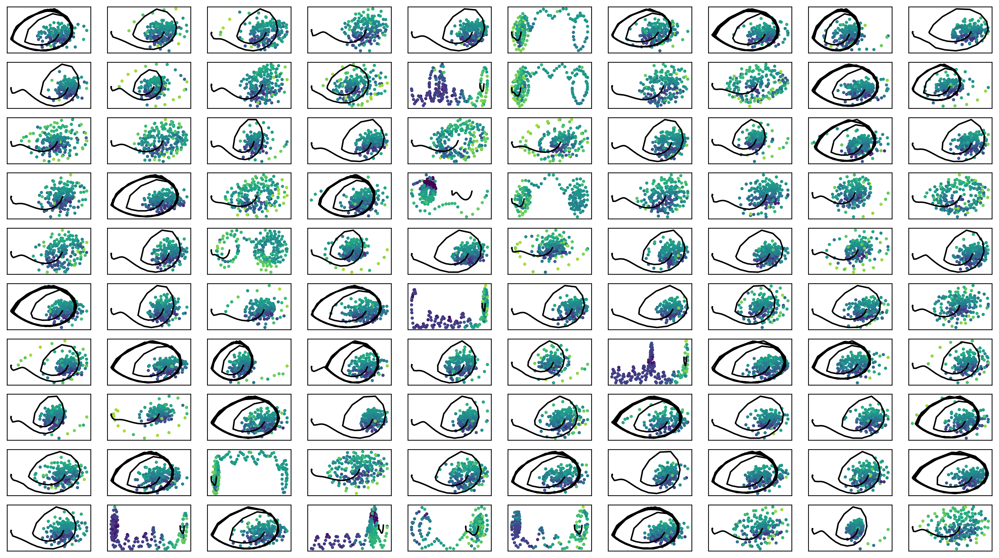

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -124.68544  validloss -135.19810±0.00000  bestvalidloss -135.19810  last_update 0
train: iter 1  trainloss -112.59759  validloss -107.58818±0.00000  bestvalidloss -135.19810  last_update 1
train: iter 2  trainloss -105.20643  validloss -105.57059±0.00000  bestvalidloss -135.19810  last_update 2
train: iter 3  trainloss -133.34340  validloss -103.65334±0.00000  bestvalidloss -135.19810  last_update 3
train: iter 4  trainloss -133.00977  validloss -109.13579±0.00000  bestvalidloss -135.19810  last_update 4
train: iter 5  trainloss -133.58394  validloss -99.86193±0.00000  bestvalidloss -135.19810  last_update 5
train: iter 6  trainloss -134.10394  validloss -106.73666±0.00000  bestvalidloss -135.19810  last_update 6
train: iter 7  trainloss -134.30368  validloss -96.80350±0.00000  bestvalidloss -135.19810  last_update 7
train: iter 8  trainloss -134.80359  validloss -94.88501±0.00000  bestvalidloss -135.19810  last_update 8
train: iter 

train: iter 78  trainloss -183.15610  validloss -170.48594±0.00000  bestvalidloss -176.96239  last_update 13
train: iter 79  trainloss -181.90514  validloss -162.27660±0.00000  bestvalidloss -176.96239  last_update 14
train: iter 80  trainloss -185.38298  validloss -168.26986±0.00000  bestvalidloss -176.96239  last_update 15
train: iter 81  trainloss -185.83951  validloss -141.76913±0.00000  bestvalidloss -176.96239  last_update 16
train: iter 82  trainloss -187.96762  validloss -158.30441±0.00000  bestvalidloss -176.96239  last_update 17
train: iter 83  trainloss -186.82541  validloss -150.34337±0.00000  bestvalidloss -176.96239  last_update 18
train: iter 84  trainloss -189.48251  validloss -142.16010±0.00000  bestvalidloss -176.96239  last_update 19
train: iter 85  trainloss -183.05109  validloss -148.56077±0.00000  bestvalidloss -176.96239  last_update 20
train: iter 86  trainloss -185.73430  validloss -158.89305±0.00000  bestvalidloss -176.96239  last_update 21
train: iter 87  tra

train: iter 153  trainloss -215.13011  validloss -184.23404±0.00000  bestvalidloss -211.04921  last_update 5
train: iter 154  trainloss -218.21449  validloss -210.24447±0.00000  bestvalidloss -211.04921  last_update 6
train: iter 155  trainloss -218.88293  validloss -207.00191±0.00000  bestvalidloss -211.04921  last_update 7
train: iter 156  trainloss -215.49397  validloss -185.21848±0.00000  bestvalidloss -211.04921  last_update 8
train: iter 157  trainloss -216.79384  validloss -187.74820±0.00000  bestvalidloss -211.04921  last_update 9
train: iter 158  trainloss -216.88815  validloss -203.87670±0.00000  bestvalidloss -211.04921  last_update 10
train: iter 159  trainloss -212.95830  validloss -156.15647±0.00000  bestvalidloss -211.04921  last_update 11
train: iter 160  trainloss -216.56859  validloss -192.59834±0.00000  bestvalidloss -211.04921  last_update 12
train: iter 161  trainloss -214.11102  validloss -180.61603±0.00000  bestvalidloss -211.04921  last_update 13
train: iter 162

train: iter 228  trainloss -235.68054  validloss -202.03832±0.00000  bestvalidloss -226.89653  last_update 10
train: iter 229  trainloss -236.09971  validloss -203.91668±0.00000  bestvalidloss -226.89653  last_update 11
train: iter 230  trainloss -234.33790  validloss -213.06436±0.00000  bestvalidloss -226.89653  last_update 12
train: iter 231  trainloss -232.83903  validloss -216.67324±0.00000  bestvalidloss -226.89653  last_update 13
train: iter 232  trainloss -238.70638  validloss -204.86870±0.00000  bestvalidloss -226.89653  last_update 14
train: iter 233  trainloss -235.89311  validloss -216.68096±0.00000  bestvalidloss -226.89653  last_update 15
train: iter 234  trainloss -233.34365  validloss -208.63307±0.00000  bestvalidloss -226.89653  last_update 16
train: iter 235  trainloss -240.85410  validloss -212.99400±0.00000  bestvalidloss -226.89653  last_update 17
train: iter 236  trainloss -238.79336  validloss -217.07707±0.00000  bestvalidloss -226.89653  last_update 18
train: ite

train: iter 303  trainloss -252.85969  validloss -212.24501±0.00000  bestvalidloss -241.27374  last_update 28
train: iter 304  trainloss -248.10087  validloss -196.61919±0.00000  bestvalidloss -241.27374  last_update 29
train: iter 305  trainloss -244.51105  validloss -234.19041±0.00000  bestvalidloss -241.27374  last_update 30
train: iter 306  trainloss -252.66238  validloss -199.22173±0.00000  bestvalidloss -241.27374  last_update 31
train: iter 307  trainloss -253.60632  validloss -194.15271±0.00000  bestvalidloss -241.27374  last_update 32
train: iter 308  trainloss -252.61879  validloss -204.52411±0.00000  bestvalidloss -241.27374  last_update 33
train: iter 309  trainloss -255.41407  validloss -184.40225±0.00000  bestvalidloss -241.27374  last_update 34
train: iter 310  trainloss -251.68857  validloss -195.04974±0.00000  bestvalidloss -241.27374  last_update 35
train: iter 311  trainloss -255.26024  validloss -156.89611±0.00000  bestvalidloss -241.27374  last_update 36
train: ite

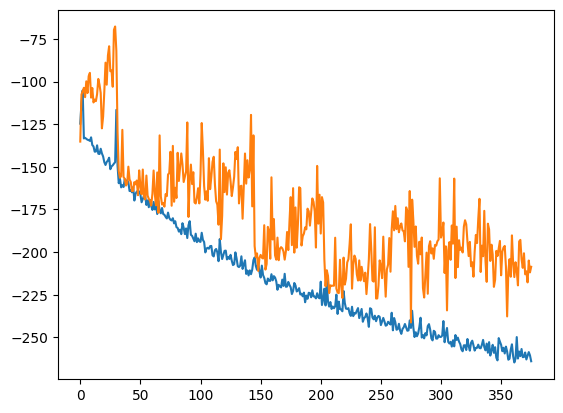

train_weighted_vae: enc
train: iter 0  trainloss -265.51348  validloss -204.72964±0.00000  bestvalidloss -204.72964  last_update 0
train: iter 1  trainloss -261.64092  validloss -212.08925±0.00000  bestvalidloss -212.08925  last_update 0
train: iter 2  trainloss -261.62641  validloss -195.88478±0.00000  bestvalidloss -212.08925  last_update 1
train: iter 3  trainloss -268.13567  validloss -221.32438±0.00000  bestvalidloss -221.32438  last_update 0
train: iter 4  trainloss -268.45532  validloss -223.20644±0.00000  bestvalidloss -223.20644  last_update 0
train: iter 5  trainloss -266.97865  validloss -216.20339±0.00000  bestvalidloss -223.20644  last_update 1
train: iter 6  trainloss -267.82102  validloss -215.10154±0.00000  bestvalidloss -223.20644  last_update 2
train: iter 7  trainloss -268.15226  validloss -216.74492±0.00000  bestvalidloss -223.20644  last_update 3
train: iter 8  trainloss -268.06036  validloss -217.68203±0.00000  bestvalidloss -223.20644  last_update 4
train: iter 9

train: iter 76  trainloss -266.55363  validloss -219.84098±0.00000  bestvalidloss -254.06048  last_update 36
train: iter 77  trainloss -267.67680  validloss -216.99809±0.00000  bestvalidloss -254.06048  last_update 37
train: iter 78  trainloss -267.40086  validloss -205.39297±0.00000  bestvalidloss -254.06048  last_update 38
train: iter 79  trainloss -268.51395  validloss -213.84228±0.00000  bestvalidloss -254.06048  last_update 39
train: iter 80  trainloss -267.95215  validloss -214.32776±0.00000  bestvalidloss -254.06048  last_update 40
train: iter 81  trainloss -267.12227  validloss -208.50230±0.00000  bestvalidloss -254.06048  last_update 41
train: iter 82  trainloss -267.63270  validloss -217.38059±0.00000  bestvalidloss -254.06048  last_update 42
train: iter 83  trainloss -268.12125  validloss -219.92800±0.00000  bestvalidloss -254.06048  last_update 43
train: iter 84  trainloss -265.87657  validloss -211.05754±0.00000  bestvalidloss -254.06048  last_update 44
train: iter 85  tra

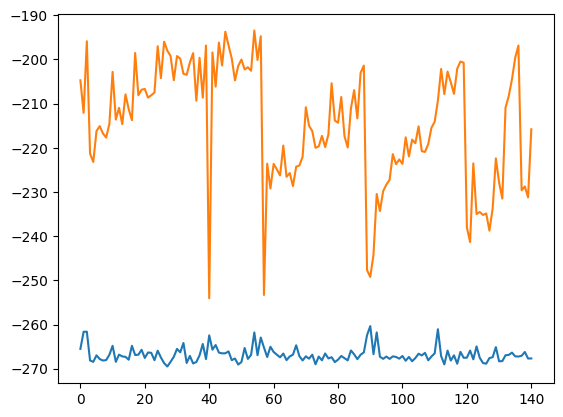

train_weighted_vae: dec
train: iter 0  trainloss -262.14134  validloss -205.16910±0.00000  bestvalidloss -205.16910  last_update 0
train: iter 1  trainloss -265.93616  validloss -210.21202±0.00000  bestvalidloss -210.21202  last_update 0
train: iter 2  trainloss -264.94615  validloss -202.80901±0.00000  bestvalidloss -210.21202  last_update 1
train: iter 3  trainloss -263.41030  validloss -211.54182±0.00000  bestvalidloss -211.54182  last_update 0
train: iter 4  trainloss -264.70290  validloss -210.36866±0.00000  bestvalidloss -211.54182  last_update 1
train: iter 5  trainloss -263.50312  validloss -212.31189±0.00000  bestvalidloss -212.31189  last_update 0
train: iter 6  trainloss -264.17871  validloss -208.74107±0.00000  bestvalidloss -212.31189  last_update 1
train: iter 7  trainloss -261.85907  validloss -206.32346±0.00000  bestvalidloss -212.31189  last_update 2
train: iter 8  trainloss -266.34562  validloss -206.65123±0.00000  bestvalidloss -212.31189  last_update 3
train: iter 9

train: iter 77  trainloss -266.38280  validloss -205.41381±0.00000  bestvalidloss -222.86825  last_update 42
train: iter 78  trainloss -264.41602  validloss -204.29252±0.00000  bestvalidloss -222.86825  last_update 43
train: iter 79  trainloss -261.53176  validloss -205.74630±0.00000  bestvalidloss -222.86825  last_update 44
train: iter 80  trainloss -264.98809  validloss -218.99730±0.00000  bestvalidloss -222.86825  last_update 45
train: iter 81  trainloss -260.64311  validloss -209.29522±0.00000  bestvalidloss -222.86825  last_update 46
train: iter 82  trainloss -267.54028  validloss -209.85443±0.00000  bestvalidloss -222.86825  last_update 47
train: iter 83  trainloss -263.47347  validloss -211.14395±0.00000  bestvalidloss -222.86825  last_update 48
train: iter 84  trainloss -266.45611  validloss -201.18525±0.00000  bestvalidloss -222.86825  last_update 49
train: iter 85  trainloss -264.23797  validloss -207.89292±0.00000  bestvalidloss -222.86825  last_update 50
train: iter 86  tra

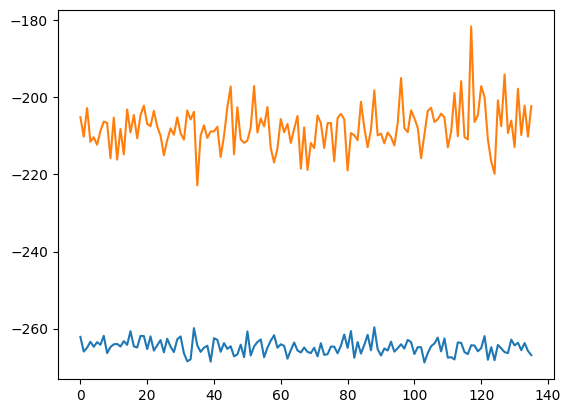

alpha 0.3 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.10780750544926214
1  c = 0.05361323702923205
2  c = 0.19764554837286233
3  c = 0.20246128209665962
4  c = 0.2107757711094295
5  c = 0.2314928041754737
6  c = 0.21635556291806676
7  c = 0.14681172432254921
8  c = 0.27550552673325857
9  c = 0.008092364228762305
10  c = 0.2666787732538002
11  c = 0.04432081026490795
12  c = 0.1491059702150909
13  c = 0.24674094083521114
14  c = 0.15764571970958927
15  c = 0.15532656906646228
16  c = 0.25811426790197894
17  c = 0.22144857277333524
18  c = 0.2222543209063424
19  c = 0.08960691618694173
20  c = 0.24437179205144263
21  c = 0.012123590701840792
22  c = 0.2225460714834801
23  c = 0.25153004796657985
24  c = 0.019667437919540308
25  c = 0.21289794961256786
26  c = 0.00025935195242183796
27  c = 0.08973875982870229
28  c = 0.13097149005832748
29  c = 0.10965987077869149
30  c = 0.0922328284662331
31  c = 0.05425354399680864
32  c = 0.15249989164190625
33  c = 0.07645793702711332
34  c = 0.10265718764957521
35  c = 0.17834730886221678
36 

95  c = 0.22705241659432404
96  c = 0.06521182909686735
97  c = 0.1129182816187404
98  c = 0.02720983536626226
99  c = 0.24884493950188355
 
実環境方策rollout vs Sim環境方策rollout


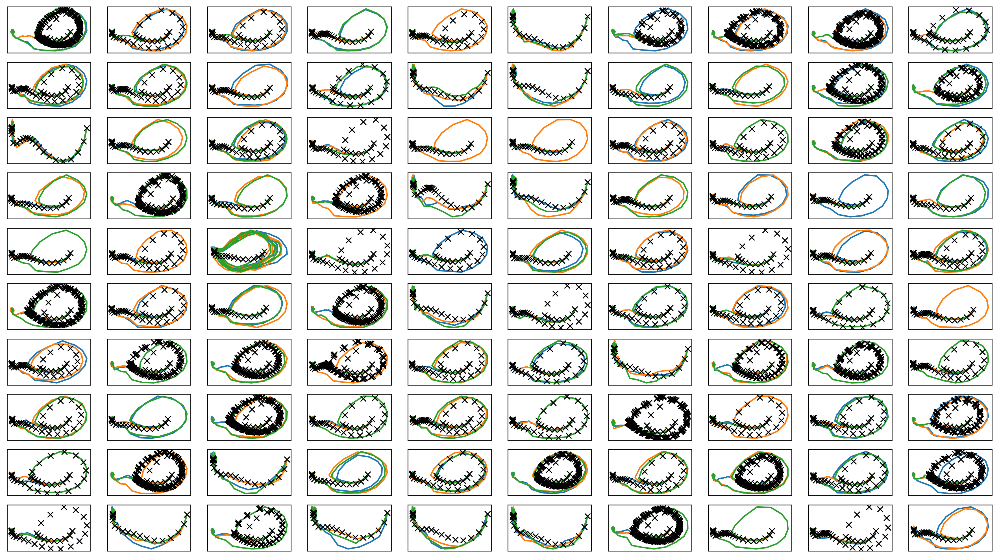

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter1.png")
plt.savefig(figfilenamehead+"joint_iter1.eps")
plt.savefig(figfilenamehead+"joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

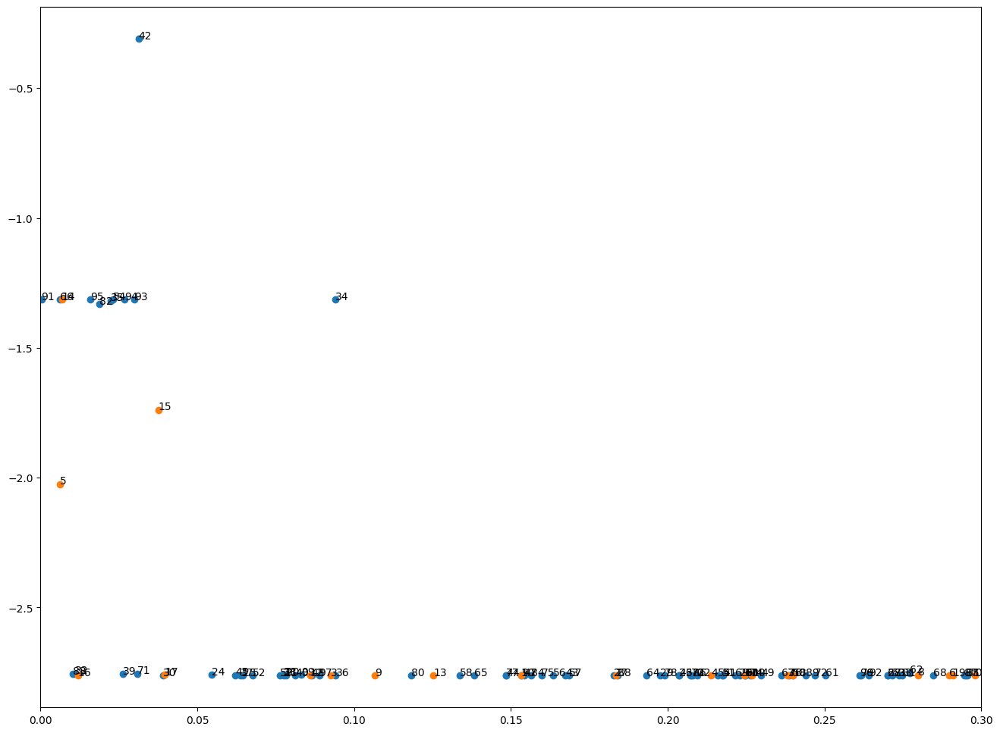

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-04-04 01:39:37.421145


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.017789121185744106
c = 0.15728493024358875
c = 0.20128857730578814
c = 0.23651613497639734
c = 0.013356600498728177
c = 0.2810008804477273
c = 0.1687080363093486
c = 0.056799511289809285
c = 0.07447560619211525
c = 0.22497114305496585
c = 0.14004370313887313
c = 0.16921599063242704
c = 0.0027244361930470417
c = 0.27260919259851757
c = 0.10690563914738363
1  c = 0.21911413004471123
c = 0.07886887903868657
c = 0.005971300632675103
c = 0.27183085816470665
2  c = 0.29958992997957096
c = 0.2398629688890358
c = 0.15519454625788334
c = 0.20816113361244196
c = 0.27337276571907954
c = 0.22158797992957263
3  c = 0.006987434735666309
c = 0.17530668203562488
c = 0.20990346306623167
c = 0.21569280547918301
c = 0.2639934893785429
c = 0.08464929107174227
4  c = 0.07138507255200867
c = 0.12514116583598944
c = 0.2657057806905572
c = 0.04406613557823589
c = 0.20020602382576488
c = 0.20177327205434253
c = 0.25859213756801963
c = 0.25960292079363617
c = 0.13961283560869103
c = 0.02061133489971476

c = 0.1168055112663542
c = 0.2734997669475278
39  c = 0.06017892870963808
c = 0.18582922528785986
c = 0.0586415514562544
c = 0.24685027065603246
c = 0.28189793079241154
c = 0.11934085155200469
c = 0.0014966017943751075
c = 0.13899069979142406
c = 0.1410909130905604
c = 0.07675548216864828
c = 0.05742820838723486
c = 0.040733249643258196
40  c = 0.09261197115058797
c = 0.019597573791621636
c = 0.04447866789600632
c = 0.2367129724322132
c = 0.1485979623295579
c = 0.018204194908814274
c = 0.29226289846408426
c = 0.12127565030875094
c = 0.27375294133100975
c = 0.13269261914372246
41  c = 0.2049241158715802
c = 0.03253550793843752
c = 0.13422335244982597
c = 0.27714882641928335
c = 0.15023203068526633
c = 0.12903885878137267
42  c = 0.16020439925832436
c = 0.24007467897503382
c = 0.0329173324183437
c = 0.2145263194125776
c = 0.1396721410464431
c = 0.2494198488576726
c = 0.21404096340977471
c = 0.25408000776316175
43  c = 0.13872671036286513
c = 0.13271686561659682
c = 0.021967020834603668
c

c = 0.2947909979428053
76  c = 0.2212426613126436
c = 0.07696796340469128
c = 0.10348930485268294
c = 0.027157437627772407
c = 0.26168316755701676
77  c = 0.13798840038756108
c = 0.19499760976064492
c = 0.04415091184576183
c = 0.05011385586612027
78  c = 0.24876990432620819
c = 0.27804158627855907
c = 0.15460740196396255
c = 0.24626380894916572
c = 0.08704602726570147
c = 0.037960689345891085
79  c = 0.25136611900366373
c = 0.2200146338271745
c = 0.15116250777015908
c = 0.22826367077952917
c = 0.21009663982804316
c = 0.14553196581851682
c = 0.2390158507118595
c = 0.2880242294526057
c = 0.08895379363933936
c = 0.07375723564005249
80  c = 0.20822839319762476
c = 0.26822210409066183
c = 0.2608341016019983
c = 0.01477042047049336
c = 0.1745542835979431
c = 0.2543036007510837
c = 0.2807644531523845
c = 0.2770901108398531
c = 0.19062194636673846
c = 0.09927164107798263
81  c = 0.13410946871246224
c = 0.1953121717101066
c = 0.2013896151335297
82  c = 0.2117959669506514
c = 0.24365884852411748

In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.17039  validloss 0.25423±0.00000  bestvalidloss 0.25423  last_update 0
train: iter 1  trainloss 0.15889  validloss 0.19361±0.00000  bestvalidloss 0.19361  last_update 0
train: iter 2  trainloss 0.15675  validloss 0.19065±0.00000  bestvalidloss 0.19065  last_update 0
train: iter 3  trainloss 0.15564  validloss 0.18911±0.00000  bestvalidloss 0.18911  last_update 0
train: iter 4  trainloss 0.15453  validloss 0.18852±0.00000  bestvalidloss 0.18852  last_update 0
train: iter 5  trainloss 0.15399  validloss 0.18721±0.00000  bestvalidloss 0.18721  last_update 0
train: iter 6  trainloss 0.15443  validloss 0.18747±0.00000  bestvalidloss 0.18721  last_update 1
train: iter 7  trainloss 0.15389  validloss 0.18674±0.00000  bestvalidloss 0.18674  last_update 0
train: iter 8  trainloss 0.15195  validloss 0.18727±0.00000  bestvalidloss 0.18674  last_update 1
train: iter 9  trainloss 0.15245  validloss 0.18662±0.00000  bestvalidloss 0.18662  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.14742  validloss 0.18329±0.00000  bestvalidloss 0.17772  last_update 4
train: iter 84  trainloss 0.14608  validloss 0.17795±0.00000  bestvalidloss 0.17772  last_update 5
train: iter 85  trainloss 0.14463  validloss 0.17764±0.00000  bestvalidloss 0.17764  last_update 0
train: iter 86  trainloss 0.14430  validloss 0.18097±0.00000  bestvalidloss 0.17764  last_update 1
train: iter 87  trainloss 0.14558  validloss 0.17850±0.00000  bestvalidloss 0.17764  last_update 2
train: iter 88  trainloss 0.14673  validloss 0.17934±0.00000  bestvalidloss 0.17764  last_update 3
train: iter 89  trainloss 0.14413  validloss 0.18063±0.00000  bestvalidloss 0.17764  last_update 4
train: iter 90  trainloss 0.14482  validloss 0.17924±0.00000  bestvalidloss 0.17764  last_update 5
train: iter 91  trainloss 0.14480  validloss 0.17718±0.00000  bestvalidloss 0.17718  last_update 0
train: iter 92  trainloss 0.14499  validloss 0.17891±0.00000  bestvalidloss 0.17718  last_update 1
train: ite

train: iter 166  trainloss 0.14057  validloss 0.17281±0.00000  bestvalidloss 0.17224  last_update 8
train: iter 167  trainloss 0.14146  validloss 0.17598±0.00000  bestvalidloss 0.17224  last_update 9
train: iter 168  trainloss 0.14186  validloss 0.17176±0.00000  bestvalidloss 0.17176  last_update 0
train: iter 169  trainloss 0.14092  validloss 0.17384±0.00000  bestvalidloss 0.17176  last_update 1
train: iter 170  trainloss 0.14052  validloss 0.17408±0.00000  bestvalidloss 0.17176  last_update 2
train: iter 171  trainloss 0.14153  validloss 0.17555±0.00000  bestvalidloss 0.17176  last_update 3
train: iter 172  trainloss 0.14175  validloss 0.17681±0.00000  bestvalidloss 0.17176  last_update 4
train: iter 173  trainloss 0.14095  validloss 0.17314±0.00000  bestvalidloss 0.17176  last_update 5
train: iter 174  trainloss 0.14187  validloss 0.17559±0.00000  bestvalidloss 0.17176  last_update 6
train: iter 175  trainloss 0.14238  validloss 0.17328±0.00000  bestvalidloss 0.17176  last_update 7


train: iter 250  trainloss 0.13864  validloss 0.16932±0.00000  bestvalidloss 0.16929  last_update 3
train: iter 251  trainloss 0.13861  validloss 0.17001±0.00000  bestvalidloss 0.16929  last_update 4
train: iter 252  trainloss 0.13953  validloss 0.17545±0.00000  bestvalidloss 0.16929  last_update 5
train: iter 253  trainloss 0.13895  validloss 0.17073±0.00000  bestvalidloss 0.16929  last_update 6
train: iter 254  trainloss 0.14044  validloss 0.16983±0.00000  bestvalidloss 0.16929  last_update 7
train: iter 255  trainloss 0.13856  validloss 0.17362±0.00000  bestvalidloss 0.16929  last_update 8
train: iter 256  trainloss 0.13811  validloss 0.16934±0.00000  bestvalidloss 0.16929  last_update 9
train: iter 257  trainloss 0.13950  validloss 0.16928±0.00000  bestvalidloss 0.16928  last_update 0
train: iter 258  trainloss 0.13933  validloss 0.17360±0.00000  bestvalidloss 0.16928  last_update 1
train: iter 259  trainloss 0.13821  validloss 0.17055±0.00000  bestvalidloss 0.16928  last_update 2


train: iter 334  trainloss 0.13927  validloss 0.17015±0.00000  bestvalidloss 0.16743  last_update 11
train: iter 335  trainloss 0.13703  validloss 0.17181±0.00000  bestvalidloss 0.16743  last_update 12
train: iter 336  trainloss 0.13788  validloss 0.16959±0.00000  bestvalidloss 0.16743  last_update 13
train: iter 337  trainloss 0.14005  validloss 0.17155±0.00000  bestvalidloss 0.16743  last_update 14
train: iter 338  trainloss 0.13682  validloss 0.16886±0.00000  bestvalidloss 0.16743  last_update 15
train: iter 339  trainloss 0.13698  validloss 0.17717±0.00000  bestvalidloss 0.16743  last_update 16
train: iter 340  trainloss 0.13806  validloss 0.17129±0.00000  bestvalidloss 0.16743  last_update 17
train: iter 341  trainloss 0.13664  validloss 0.16804±0.00000  bestvalidloss 0.16743  last_update 18
train: iter 342  trainloss 0.13695  validloss 0.16755±0.00000  bestvalidloss 0.16743  last_update 19
train: iter 343  trainloss 0.13804  validloss 0.16782±0.00000  bestvalidloss 0.16743  last_

train: iter 416  trainloss 0.13567  validloss 0.16883±0.00000  bestvalidloss 0.16687  last_update 7
train: iter 417  trainloss 0.13534  validloss 0.16819±0.00000  bestvalidloss 0.16687  last_update 8
train: iter 418  trainloss 0.13628  validloss 0.16786±0.00000  bestvalidloss 0.16687  last_update 9
train: iter 419  trainloss 0.13516  validloss 0.16657±0.00000  bestvalidloss 0.16657  last_update 0
train: iter 420  trainloss 0.13593  validloss 0.16980±0.00000  bestvalidloss 0.16657  last_update 1
train: iter 421  trainloss 0.13649  validloss 0.16940±0.00000  bestvalidloss 0.16657  last_update 2
train: iter 422  trainloss 0.13709  validloss 0.16917±0.00000  bestvalidloss 0.16657  last_update 3
train: iter 423  trainloss 0.13506  validloss 0.16758±0.00000  bestvalidloss 0.16657  last_update 4
train: iter 424  trainloss 0.13584  validloss 0.16807±0.00000  bestvalidloss 0.16657  last_update 5
train: iter 425  trainloss 0.13642  validloss 0.17155±0.00000  bestvalidloss 0.16657  last_update 6


train: iter 498  trainloss 0.13410  validloss 0.16773±0.00000  bestvalidloss 0.16607  last_update 8
train: iter 499  trainloss 0.13384  validloss 0.16763±0.00000  bestvalidloss 0.16607  last_update 9
train: iter 500  trainloss 0.13435  validloss 0.17040±0.00000  bestvalidloss 0.16607  last_update 10
train: iter 501  trainloss 0.13533  validloss 0.16679±0.00000  bestvalidloss 0.16607  last_update 11
train: iter 502  trainloss 0.13490  validloss 0.16790±0.00000  bestvalidloss 0.16607  last_update 12
train: iter 503  trainloss 0.13416  validloss 0.16736±0.00000  bestvalidloss 0.16607  last_update 13
train: iter 504  trainloss 0.13551  validloss 0.16795±0.00000  bestvalidloss 0.16607  last_update 14
train: iter 505  trainloss 0.13525  validloss 0.16571±0.00000  bestvalidloss 0.16571  last_update 0
train: iter 506  trainloss 0.13441  validloss 0.16757±0.00000  bestvalidloss 0.16571  last_update 1
train: iter 507  trainloss 0.13370  validloss 0.16873±0.00000  bestvalidloss 0.16571  last_upda

train: iter 581  trainloss 0.13187  validloss 0.16704±0.00000  bestvalidloss 0.16510  last_update 18
train: iter 582  trainloss 0.13367  validloss 0.16826±0.00000  bestvalidloss 0.16510  last_update 19
train: iter 583  trainloss 0.13490  validloss 0.17046±0.00000  bestvalidloss 0.16510  last_update 20
train: iter 584  trainloss 0.13606  validloss 0.16692±0.00000  bestvalidloss 0.16510  last_update 21
train: iter 585  trainloss 0.13312  validloss 0.16522±0.00000  bestvalidloss 0.16510  last_update 22
train: iter 586  trainloss 0.13433  validloss 0.17002±0.00000  bestvalidloss 0.16510  last_update 23
train: iter 587  trainloss 0.13260  validloss 0.16884±0.00000  bestvalidloss 0.16510  last_update 24
train: iter 588  trainloss 0.13222  validloss 0.16739±0.00000  bestvalidloss 0.16510  last_update 25
train: iter 589  trainloss 0.13292  validloss 0.16680±0.00000  bestvalidloss 0.16510  last_update 26
train: iter 590  trainloss 0.13218  validloss 0.16629±0.00000  bestvalidloss 0.16510  last_

train: fin


In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -104.0489618742466
valid_loss:  -138.91641774892807
train_loss:  -143.8048587441444
valid_loss:  -118.97357841491699


1e-08 1000.0


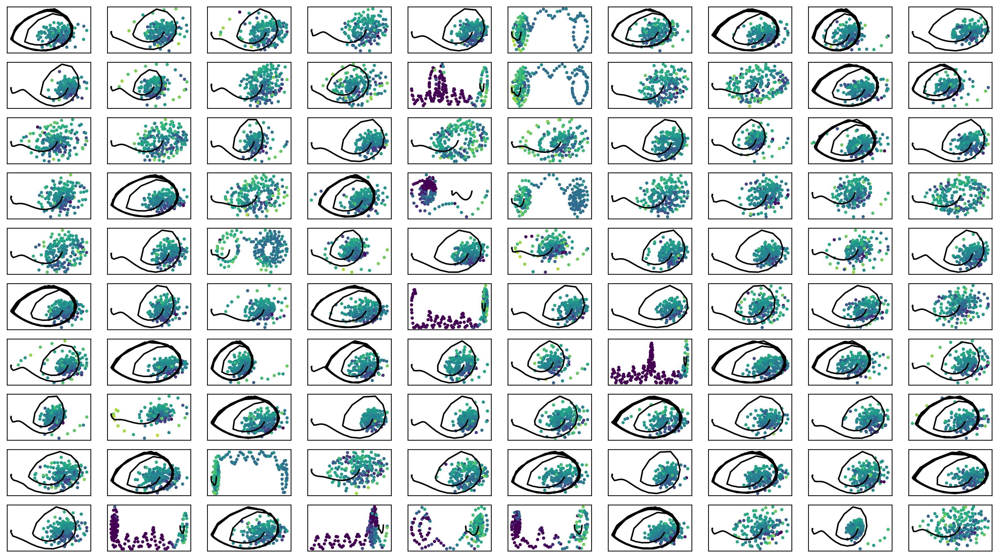

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -141.83882  validloss -120.85347±0.00000  bestvalidloss -120.85347  last_update 0
train: iter 1  trainloss -145.63564  validloss -127.82669±0.00000  bestvalidloss -127.82669  last_update 0
train: iter 2  trainloss -144.63047  validloss -114.00315±0.00000  bestvalidloss -127.82669  last_update 1
train: iter 3  trainloss -146.37181  validloss -132.08059±0.00000  bestvalidloss -132.08059  last_update 0
train: iter 4  trainloss -146.75549  validloss -129.67963±0.00000  bestvalidloss -132.08059  last_update 1
train: iter 5  trainloss -144.33615  validloss -122.12918±0.00000  bestvalidloss -132.08059  last_update 2
train: iter 6  trainloss -144.23135  validloss -127.65179±0.00000  bestvalidloss -132.08059  last_update 3
train: iter 7  trainloss -145.61848  validloss -127.64923±0.00000  bestvalidloss -132.08059  last_update 4
train: iter 8  trainloss -147.03825  validloss -115.10141±0.00000  bestvalidloss -132.08059  last_update 5
train: it

train: iter 76  trainloss -163.38242  validloss -163.80400±0.00000  bestvalidloss -163.80400  last_update 0
train: iter 77  trainloss -165.00398  validloss -158.16397±0.00000  bestvalidloss -163.80400  last_update 1
train: iter 78  trainloss -161.87887  validloss -153.76124±0.00000  bestvalidloss -163.80400  last_update 2
train: iter 79  trainloss -163.81008  validloss -154.64968±0.00000  bestvalidloss -163.80400  last_update 3
train: iter 80  trainloss -165.01143  validloss -151.10493±0.00000  bestvalidloss -163.80400  last_update 4
train: iter 81  trainloss -163.90834  validloss -143.16105±0.00000  bestvalidloss -163.80400  last_update 5
train: iter 82  trainloss -165.42880  validloss -147.04994±0.00000  bestvalidloss -163.80400  last_update 6
train: iter 83  trainloss -166.57553  validloss -150.77680±0.00000  bestvalidloss -163.80400  last_update 7
train: iter 84  trainloss -165.70774  validloss -140.98574±0.00000  bestvalidloss -163.80400  last_update 8
train: iter 85  trainloss -1

train: iter 151  trainloss -181.09135  validloss -158.36030±0.00000  bestvalidloss -171.57038  last_update 17
train: iter 152  trainloss -179.26714  validloss -144.62167±0.00000  bestvalidloss -171.57038  last_update 18
train: iter 153  trainloss -179.90473  validloss -157.70043±0.00000  bestvalidloss -171.57038  last_update 19
train: iter 154  trainloss -178.66279  validloss -152.36187±0.00000  bestvalidloss -171.57038  last_update 20
train: iter 155  trainloss -180.95402  validloss -160.56362±0.00000  bestvalidloss -171.57038  last_update 21
train: iter 156  trainloss -180.56181  validloss -157.20692±0.00000  bestvalidloss -171.57038  last_update 22
train: iter 157  trainloss -181.15054  validloss -166.56656±0.00000  bestvalidloss -171.57038  last_update 23
train: iter 158  trainloss -182.76641  validloss -161.43841±0.00000  bestvalidloss -171.57038  last_update 24
train: iter 159  trainloss -179.58035  validloss -147.76911±0.00000  bestvalidloss -171.57038  last_update 25
train: ite

train: iter 226  trainloss -191.18441  validloss -181.06796±0.00000  bestvalidloss -189.81847  last_update 9
train: iter 227  trainloss -193.29141  validloss -187.14904±0.00000  bestvalidloss -189.81847  last_update 10
train: iter 228  trainloss -193.80466  validloss -179.13141±0.00000  bestvalidloss -189.81847  last_update 11
train: iter 229  trainloss -191.80689  validloss -178.97677±0.00000  bestvalidloss -189.81847  last_update 12
train: iter 230  trainloss -192.57182  validloss -173.12517±0.00000  bestvalidloss -189.81847  last_update 13
train: iter 231  trainloss -190.72821  validloss -171.91792±0.00000  bestvalidloss -189.81847  last_update 14
train: iter 232  trainloss -194.59549  validloss -176.64612±0.00000  bestvalidloss -189.81847  last_update 15
train: iter 233  trainloss -192.54719  validloss -173.78146±0.00000  bestvalidloss -189.81847  last_update 16
train: iter 234  trainloss -195.15275  validloss -174.68280±0.00000  bestvalidloss -189.81847  last_update 17
train: iter

train: iter 301  trainloss -202.56205  validloss -192.45399±0.00000  bestvalidloss -205.17621  last_update 12
train: iter 302  trainloss -202.65495  validloss -181.47201±0.00000  bestvalidloss -205.17621  last_update 13
train: iter 303  trainloss -204.33536  validloss -185.29099±0.00000  bestvalidloss -205.17621  last_update 14
train: iter 304  trainloss -204.57563  validloss -177.32353±0.00000  bestvalidloss -205.17621  last_update 15
train: iter 305  trainloss -204.73553  validloss -186.56646±0.00000  bestvalidloss -205.17621  last_update 16
train: iter 306  trainloss -205.49048  validloss -186.69779±0.00000  bestvalidloss -205.17621  last_update 17
train: iter 307  trainloss -203.89583  validloss -170.53710±0.00000  bestvalidloss -205.17621  last_update 18
train: iter 308  trainloss -206.94883  validloss -187.06703±0.00000  bestvalidloss -205.17621  last_update 19
train: iter 309  trainloss -205.48831  validloss -196.56886±0.00000  bestvalidloss -205.17621  last_update 20
train: ite

train: iter 376  trainloss -214.23406  validloss -195.08722±0.00000  bestvalidloss -208.77353  last_update 37
train: iter 377  trainloss -214.22452  validloss -189.74777±0.00000  bestvalidloss -208.77353  last_update 38
train: iter 378  trainloss -213.72468  validloss -187.46875±0.00000  bestvalidloss -208.77353  last_update 39
train: iter 379  trainloss -215.53657  validloss -195.42825±0.00000  bestvalidloss -208.77353  last_update 40
train: iter 380  trainloss -213.72108  validloss -201.13516±0.00000  bestvalidloss -208.77353  last_update 41
train: iter 381  trainloss -215.76775  validloss -196.46960±0.00000  bestvalidloss -208.77353  last_update 42
train: iter 382  trainloss -215.97340  validloss -193.64877±0.00000  bestvalidloss -208.77353  last_update 43
train: iter 383  trainloss -217.63358  validloss -194.82458±0.00000  bestvalidloss -208.77353  last_update 44
train: iter 384  trainloss -213.32072  validloss -198.48537±0.00000  bestvalidloss -208.77353  last_update 45
train: ite

train: iter 452  trainloss -223.62060  validloss -212.81394±0.00000  bestvalidloss -220.94785  last_update 6
train: iter 453  trainloss -226.98995  validloss -219.75171±0.00000  bestvalidloss -220.94785  last_update 7
train: iter 454  trainloss -225.39801  validloss -222.15101±0.00000  bestvalidloss -222.15101  last_update 0
train: iter 455  trainloss -227.27936  validloss -213.11320±0.00000  bestvalidloss -222.15101  last_update 1
train: iter 456  trainloss -229.30636  validloss -222.48359±0.00000  bestvalidloss -222.48359  last_update 0
train: iter 457  trainloss -226.55645  validloss -217.51665±0.00000  bestvalidloss -222.48359  last_update 1
train: iter 458  trainloss -227.35507  validloss -222.95626±0.00000  bestvalidloss -222.95626  last_update 0
train: iter 459  trainloss -227.54354  validloss -227.12713±0.00000  bestvalidloss -227.12713  last_update 0
train: iter 460  trainloss -227.94344  validloss -216.11126±0.00000  bestvalidloss -227.12713  last_update 1
train: iter 461  tr

train: iter 529  trainloss -268.49538  validloss -256.92669±0.00000  bestvalidloss -264.44767  last_update 1
train: iter 530  trainloss -272.83946  validloss -262.03072±0.00000  bestvalidloss -264.44767  last_update 2
train: iter 531  trainloss -265.60734  validloss -254.62230±0.00000  bestvalidloss -264.44767  last_update 3
train: iter 532  trainloss -269.42541  validloss -260.25410±0.00000  bestvalidloss -264.44767  last_update 4
train: iter 533  trainloss -277.92834  validloss -270.09989±0.00000  bestvalidloss -270.09989  last_update 0
train: iter 534  trainloss -271.96115  validloss -252.80215±0.00000  bestvalidloss -270.09989  last_update 1
train: iter 535  trainloss -266.73773  validloss -239.18980±0.00000  bestvalidloss -270.09989  last_update 2
train: iter 536  trainloss -269.82802  validloss -244.63158±0.00000  bestvalidloss -270.09989  last_update 3
train: iter 537  trainloss -274.78229  validloss -239.81057±0.00000  bestvalidloss -270.09989  last_update 4
train: iter 538  tr

train: iter 605  trainloss -273.80760  validloss -273.66859±0.00000  bestvalidloss -283.45618  last_update 9
train: iter 606  trainloss -279.25962  validloss -280.98108±0.00000  bestvalidloss -283.45618  last_update 10
train: iter 607  trainloss -279.14989  validloss -267.34758±0.00000  bestvalidloss -283.45618  last_update 11
train: iter 608  trainloss -280.86984  validloss -276.15924±0.00000  bestvalidloss -283.45618  last_update 12
train: iter 609  trainloss -280.57328  validloss -273.11348±0.00000  bestvalidloss -283.45618  last_update 13
train: iter 610  trainloss -276.68889  validloss -260.44259±0.00000  bestvalidloss -283.45618  last_update 14
train: iter 611  trainloss -282.87820  validloss -275.01142±0.00000  bestvalidloss -283.45618  last_update 15
train: iter 612  trainloss -282.14833  validloss -273.35109±0.00000  bestvalidloss -283.45618  last_update 16
train: iter 613  trainloss -279.80526  validloss -282.77459±0.00000  bestvalidloss -283.45618  last_update 17
train: iter

train: iter 681  trainloss -284.06126  validloss -277.97296±0.00000  bestvalidloss -295.13791  last_update 4
train: iter 682  trainloss -287.44025  validloss -284.64761±0.00000  bestvalidloss -295.13791  last_update 5
train: iter 683  trainloss -287.86101  validloss -295.70839±0.00000  bestvalidloss -295.70839  last_update 0
train: iter 684  trainloss -290.32924  validloss -284.93776±0.00000  bestvalidloss -295.70839  last_update 1
train: iter 685  trainloss -293.03699  validloss -292.92243±0.00000  bestvalidloss -295.70839  last_update 2
train: iter 686  trainloss -281.40843  validloss -292.16925±0.00000  bestvalidloss -295.70839  last_update 3
train: iter 687  trainloss -291.54768  validloss -288.83772±0.00000  bestvalidloss -295.70839  last_update 4
train: iter 688  trainloss -291.77196  validloss -294.85803±0.00000  bestvalidloss -295.70839  last_update 5
train: iter 689  trainloss -291.82833  validloss -293.96047±0.00000  bestvalidloss -295.70839  last_update 6
train: iter 690  tr

train: iter 756  trainloss -301.07679  validloss -272.58147±0.00000  bestvalidloss -306.74693  last_update 3
train: iter 757  trainloss -296.87237  validloss -286.59156±0.00000  bestvalidloss -306.74693  last_update 4
train: iter 758  trainloss -297.92440  validloss -307.37543±0.00000  bestvalidloss -307.37543  last_update 0
train: iter 759  trainloss -299.31966  validloss -303.56364±0.00000  bestvalidloss -307.37543  last_update 1
train: iter 760  trainloss -296.15601  validloss -305.43515±0.00000  bestvalidloss -307.37543  last_update 2
train: iter 761  trainloss -298.77475  validloss -300.41619±0.00000  bestvalidloss -307.37543  last_update 3
train: iter 762  trainloss -297.61194  validloss -295.82970±0.00000  bestvalidloss -307.37543  last_update 4
train: iter 763  trainloss -299.02452  validloss -291.02988±0.00000  bestvalidloss -307.37543  last_update 5
train: iter 764  trainloss -296.66094  validloss -301.50978±0.00000  bestvalidloss -307.37543  last_update 6
train: iter 765  tr

train: iter 831  trainloss -306.91714  validloss -301.95463±0.00000  bestvalidloss -308.55257  last_update 23
train: iter 832  trainloss -305.37973  validloss -308.85945±0.00000  bestvalidloss -308.85945  last_update 0
train: iter 833  trainloss -303.46234  validloss -309.24372±0.00000  bestvalidloss -309.24372  last_update 0
train: iter 834  trainloss -302.96742  validloss -308.61598±0.00000  bestvalidloss -309.24372  last_update 1
train: iter 835  trainloss -306.50941  validloss -274.44876±0.00000  bestvalidloss -309.24372  last_update 2
train: iter 836  trainloss -307.45224  validloss -304.86376±0.00000  bestvalidloss -309.24372  last_update 3
train: iter 837  trainloss -304.50464  validloss -276.33220±0.00000  bestvalidloss -309.24372  last_update 4
train: iter 838  trainloss -308.24858  validloss -304.34751±0.00000  bestvalidloss -309.24372  last_update 5
train: iter 839  trainloss -298.25788  validloss -262.00949±0.00000  bestvalidloss -309.24372  last_update 6
train: iter 840  t

train: iter 907  trainloss -309.52942  validloss -283.79318±0.00000  bestvalidloss -318.87730  last_update 64
train: iter 908  trainloss -309.44539  validloss -289.60398±0.00000  bestvalidloss -318.87730  last_update 65
train: iter 909  trainloss -310.71538  validloss -298.69698±0.00000  bestvalidloss -318.87730  last_update 66
train: iter 910  trainloss -312.09380  validloss -287.63100±0.00000  bestvalidloss -318.87730  last_update 67
train: iter 911  trainloss -304.23462  validloss -302.02957±0.00000  bestvalidloss -318.87730  last_update 68
train: iter 912  trainloss -312.90708  validloss -298.18677±0.00000  bestvalidloss -318.87730  last_update 69
train: iter 913  trainloss -307.95996  validloss -305.99517±0.00000  bestvalidloss -318.87730  last_update 70
train: iter 914  trainloss -307.31222  validloss -312.57281±0.00000  bestvalidloss -318.87730  last_update 71
train: iter 915  trainloss -313.03604  validloss -302.13028±0.00000  bestvalidloss -318.87730  last_update 72
train: ite

train: iter 982  trainloss -298.74101  validloss -300.47456±0.00000  bestvalidloss -319.85246  last_update 55
train: iter 983  trainloss -310.28324  validloss -304.70755±0.00000  bestvalidloss -319.85246  last_update 56
train: iter 984  trainloss -307.88933  validloss -269.99641±0.00000  bestvalidloss -319.85246  last_update 57
train: iter 985  trainloss -314.90109  validloss -300.60401±0.00000  bestvalidloss -319.85246  last_update 58
train: iter 986  trainloss -310.48836  validloss -281.06112±0.00000  bestvalidloss -319.85246  last_update 59
train: iter 987  trainloss -310.82719  validloss -299.84117±0.00000  bestvalidloss -319.85246  last_update 60
train: iter 988  trainloss -309.79479  validloss -290.61142±0.00000  bestvalidloss -319.85246  last_update 61
train: iter 989  trainloss -307.95019  validloss -305.26303±0.00000  bestvalidloss -319.85246  last_update 62
train: iter 990  trainloss -307.78747  validloss -284.83931±0.00000  bestvalidloss -319.85246  last_update 63
train: ite

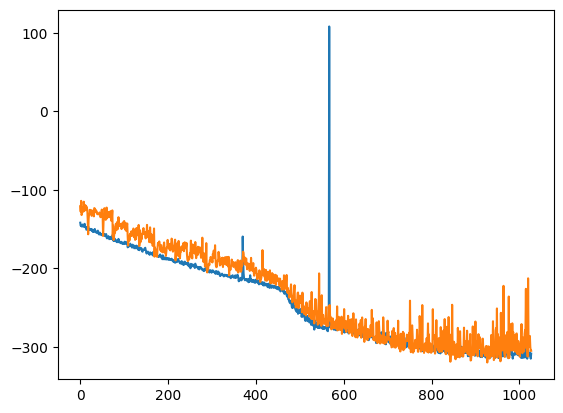

train_weighted_vae: enc
train: iter 0  trainloss -312.15500  validloss -304.68424±0.00000  bestvalidloss -304.68424  last_update 0
train: iter 1  trainloss -311.57781  validloss -289.87006±0.00000  bestvalidloss -304.68424  last_update 1
train: iter 2  trainloss -313.30431  validloss -299.44663±0.00000  bestvalidloss -304.68424  last_update 2
train: iter 3  trainloss -315.27794  validloss -288.86054±0.00000  bestvalidloss -304.68424  last_update 3
train: iter 4  trainloss -314.28212  validloss -308.99758±0.00000  bestvalidloss -308.99758  last_update 0
train: iter 5  trainloss -310.86505  validloss -300.15543±0.00000  bestvalidloss -308.99758  last_update 1
train: iter 6  trainloss -312.28663  validloss -270.95685±0.00000  bestvalidloss -308.99758  last_update 2
train: iter 7  trainloss -312.17136  validloss -297.25451±0.00000  bestvalidloss -308.99758  last_update 3
train: iter 8  trainloss -314.02089  validloss -307.44866±0.00000  bestvalidloss -308.99758  last_update 4
train: iter 9

train: iter 76  trainloss -314.58753  validloss -295.02202±0.00000  bestvalidloss -311.54972  last_update 55
train: iter 77  trainloss -313.12113  validloss -299.00913±0.00000  bestvalidloss -311.54972  last_update 56
train: iter 78  trainloss -317.76150  validloss -301.65636±0.00000  bestvalidloss -311.54972  last_update 57
train: iter 79  trainloss -315.54459  validloss -303.29573±0.00000  bestvalidloss -311.54972  last_update 58
train: iter 80  trainloss -316.91478  validloss -302.07855±0.00000  bestvalidloss -311.54972  last_update 59
train: iter 81  trainloss -310.52998  validloss -305.84762±0.00000  bestvalidloss -311.54972  last_update 60
train: iter 82  trainloss -315.86782  validloss -287.50611±0.00000  bestvalidloss -311.54972  last_update 61
train: iter 83  trainloss -310.53638  validloss -287.34340±0.00000  bestvalidloss -311.54972  last_update 62
train: iter 84  trainloss -314.43397  validloss -302.55858±0.00000  bestvalidloss -311.54972  last_update 63
train: iter 85  tra

train: iter 151  trainloss -314.53481  validloss -297.42459±0.00000  bestvalidloss -313.99145  last_update 66
train: iter 152  trainloss -308.46882  validloss -293.82185±0.00000  bestvalidloss -313.99145  last_update 67
train: iter 153  trainloss -317.04917  validloss -294.05191±0.00000  bestvalidloss -313.99145  last_update 68
train: iter 154  trainloss -312.13492  validloss -304.31999±0.00000  bestvalidloss -313.99145  last_update 69
train: iter 155  trainloss -316.14304  validloss -306.51480±0.00000  bestvalidloss -313.99145  last_update 70
train: iter 156  trainloss -314.38566  validloss -297.91555±0.00000  bestvalidloss -313.99145  last_update 71
train: iter 157  trainloss -316.08016  validloss -279.73541±0.00000  bestvalidloss -313.99145  last_update 72
train: iter 158  trainloss -315.45912  validloss -294.25163±0.00000  bestvalidloss -313.99145  last_update 73
train: iter 159  trainloss -314.62928  validloss -301.47131±0.00000  bestvalidloss -313.99145  last_update 74
train: ite

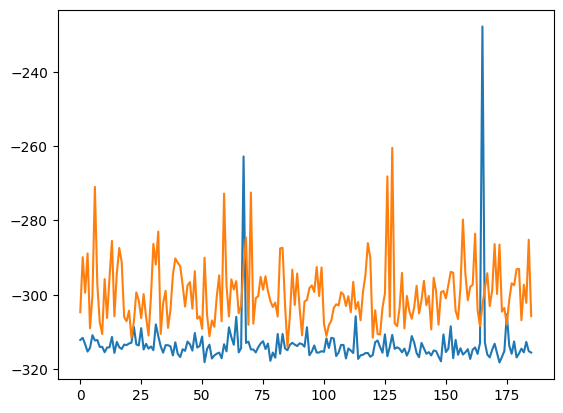

train_weighted_vae: dec
train: iter 0  trainloss -315.94731  validloss -301.46857±0.00000  bestvalidloss -301.46857  last_update 0
train: iter 1  trainloss -318.38264  validloss -307.77297±0.00000  bestvalidloss -307.77297  last_update 0
train: iter 2  trainloss -314.16226  validloss -305.84048±0.00000  bestvalidloss -307.77297  last_update 1
train: iter 3  trainloss -314.66654  validloss -275.32127±0.00000  bestvalidloss -307.77297  last_update 2
train: iter 4  trainloss -317.23239  validloss -270.72088±0.00000  bestvalidloss -307.77297  last_update 3
train: iter 5  trainloss -318.36035  validloss -290.49766±0.00000  bestvalidloss -307.77297  last_update 4
train: iter 6  trainloss -316.76333  validloss -291.79674±0.00000  bestvalidloss -307.77297  last_update 5
train: iter 7  trainloss -317.31039  validloss -287.85711±0.00000  bestvalidloss -307.77297  last_update 6
train: iter 8  trainloss -316.59457  validloss -275.40951±0.00000  bestvalidloss -307.77297  last_update 7
train: iter 9

train: iter 77  trainloss -318.95868  validloss -287.92170±0.00000  bestvalidloss -313.33154  last_update 63
train: iter 78  trainloss -320.48732  validloss -304.68938±0.00000  bestvalidloss -313.33154  last_update 64
train: iter 79  trainloss -318.00627  validloss -287.18062±0.00000  bestvalidloss -313.33154  last_update 65
train: iter 80  trainloss -320.39844  validloss -313.34002±0.00000  bestvalidloss -313.34002  last_update 0
train: iter 81  trainloss -316.79426  validloss -304.44575±0.00000  bestvalidloss -313.34002  last_update 1
train: iter 82  trainloss -315.64875  validloss -293.83790±0.00000  bestvalidloss -313.34002  last_update 2
train: iter 83  trainloss -316.47888  validloss -271.43915±0.00000  bestvalidloss -313.34002  last_update 3
train: iter 84  trainloss -318.24318  validloss -271.36789±0.00000  bestvalidloss -313.34002  last_update 4
train: iter 85  trainloss -320.06276  validloss -297.80039±0.00000  bestvalidloss -313.34002  last_update 5
train: iter 86  trainloss

train: iter 152  trainloss -321.47950  validloss -302.80454±0.00000  bestvalidloss -313.34002  last_update 72
train: iter 153  trainloss -322.12701  validloss -295.34507±0.00000  bestvalidloss -313.34002  last_update 73
train: iter 154  trainloss -318.91921  validloss -279.12557±0.00000  bestvalidloss -313.34002  last_update 74
train: iter 155  trainloss -316.74831  validloss -303.60471±0.00000  bestvalidloss -313.34002  last_update 75
train: iter 156  trainloss -320.14879  validloss -293.48991±0.00000  bestvalidloss -313.34002  last_update 76
train: iter 157  trainloss -319.70500  validloss -285.03809±0.00000  bestvalidloss -313.34002  last_update 77
train: iter 158  trainloss -324.12781  validloss -286.78848±0.00000  bestvalidloss -313.34002  last_update 78
train: iter 159  trainloss -315.98079  validloss -257.20809±0.00000  bestvalidloss -313.34002  last_update 79
train: iter 160  trainloss -318.58121  validloss -294.32062±0.00000  bestvalidloss -313.34002  last_update 80
train: ite

train: iter 227  trainloss -323.12437  validloss -282.38603±0.00000  bestvalidloss -313.40896  last_update 50
train: iter 228  trainloss -320.73038  validloss -278.23743±0.00000  bestvalidloss -313.40896  last_update 51
train: iter 229  trainloss -318.38329  validloss -254.27147±0.00000  bestvalidloss -313.40896  last_update 52
train: iter 230  trainloss -321.78364  validloss -293.81943±0.00000  bestvalidloss -313.40896  last_update 53
train: iter 231  trainloss -324.22699  validloss -272.65340±0.00000  bestvalidloss -313.40896  last_update 54
train: iter 232  trainloss -318.82771  validloss -294.21918±0.00000  bestvalidloss -313.40896  last_update 55
train: iter 233  trainloss -318.99121  validloss -314.41806±0.00000  bestvalidloss -314.41806  last_update 0
train: iter 234  trainloss -321.61869  validloss -293.73257±0.00000  bestvalidloss -314.41806  last_update 1
train: iter 235  trainloss -322.70268  validloss -296.38599±0.00000  bestvalidloss -314.41806  last_update 2
train: iter 2

train: iter 304  trainloss -320.45814  validloss -287.90701±0.00000  bestvalidloss -314.41806  last_update 71
train: iter 305  trainloss -323.00610  validloss -305.28215±0.00000  bestvalidloss -314.41806  last_update 72
train: iter 306  trainloss -320.04083  validloss -293.15291±0.00000  bestvalidloss -314.41806  last_update 73
train: iter 307  trainloss -324.43378  validloss -303.36537±0.00000  bestvalidloss -314.41806  last_update 74
train: iter 308  trainloss -322.68623  validloss -300.77170±0.00000  bestvalidloss -314.41806  last_update 75
train: iter 309  trainloss -321.03500  validloss -280.61615±0.00000  bestvalidloss -314.41806  last_update 76
train: iter 310  trainloss -318.03546  validloss -265.96693±0.00000  bestvalidloss -314.41806  last_update 77
train: iter 311  trainloss -319.34513  validloss -289.80503±0.00000  bestvalidloss -314.41806  last_update 78
train: iter 312  trainloss -319.12621  validloss -278.14637±0.00000  bestvalidloss -314.41806  last_update 79
train: ite

train: iter 379  trainloss -321.27441  validloss -287.44290±0.00000  bestvalidloss -316.61532  last_update 61
train: iter 380  trainloss -323.18200  validloss -273.23425±0.00000  bestvalidloss -316.61532  last_update 62
train: iter 381  trainloss -323.68284  validloss -313.35656±0.00000  bestvalidloss -316.61532  last_update 63
train: iter 382  trainloss -320.38323  validloss -293.72561±0.00000  bestvalidloss -316.61532  last_update 64
train: iter 383  trainloss -319.51973  validloss -307.19504±0.00000  bestvalidloss -316.61532  last_update 65
train: iter 384  trainloss -325.10851  validloss -288.73443±0.00000  bestvalidloss -316.61532  last_update 66
train: iter 385  trainloss -320.15064  validloss -311.94738±0.00000  bestvalidloss -316.61532  last_update 67
train: iter 386  trainloss -320.15442  validloss -277.34000±0.00000  bestvalidloss -316.61532  last_update 68
train: iter 387  trainloss -323.54439  validloss -297.63265±0.00000  bestvalidloss -316.61532  last_update 69
train: ite

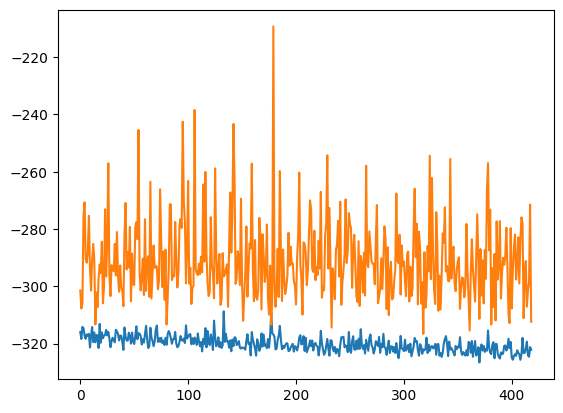

alpha 0.3 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.20534087958345404
1  c = 0.0740567357096577
2  c = 0.1404410427517666
3  c = 0.20117234269839127
4  c = 0.013938403035175883
5  c = 0.29500819718020055
6  c = 0.031665646760175324
7  c = 0.18190899118772483
8  c = 0.2777374422464309
9  c = 0.20171106462171026
10  c = 0.06199993885243635
11  c = 0.24247096077055444
12  c = 0.010395551650482181
13  c = 0.2703923804090848
14  c = 0.12039955886613532
15  c = 0.2685163634529598
16  c = 0.24929032876896023
17  c = 0.2504178348869055
18  c = 0.039003507619449325
19  c = 0.2850527432045068
20  c = 0.25694174780708007
21  c = 0.2665457522405091
22  c = 0.11070367084702977
23  c = 0.29006504842276903
24  c = 0.2524832441209644
25  c = 0.2677727197276234
26  c = 0.25707565258367626
27  c = 0.239584216199407
28  c = 0.06329453032338606
29  c = 0.10644789401813297
30  c = 0.049203042990572134
31  c = 0.027436808131261956
32  c = 0.10733375028017894
33  c = 0.20549668549573682
34  c = 0.1828253167839896
35  c = 0.2936165057705113
36  c = 0.

96  c = 0.15209652077279093
97  c = 0.15963793304220938
98  c = 0.17215891288892812
99  c = 0.163448194438249
 
実環境方策rollout vs Sim環境方策rollout


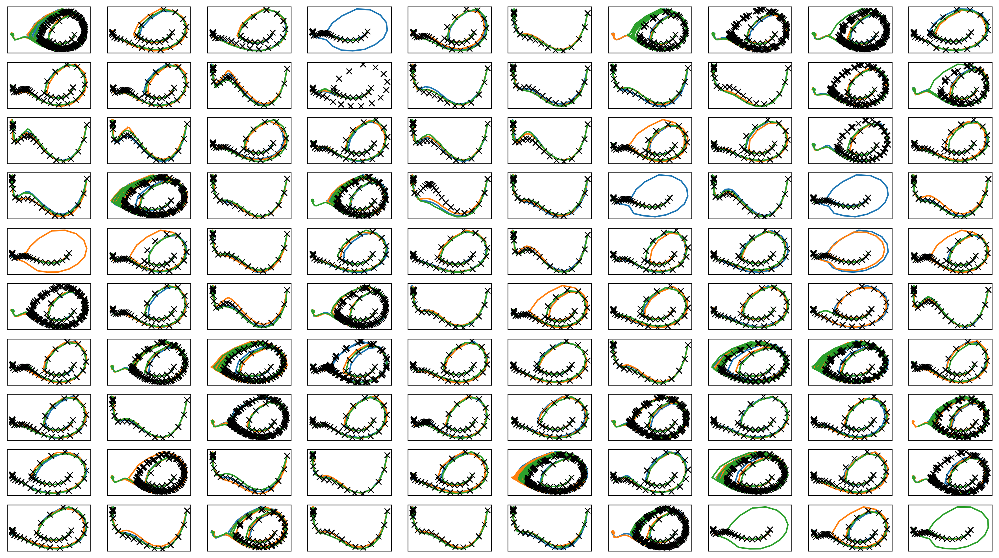

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

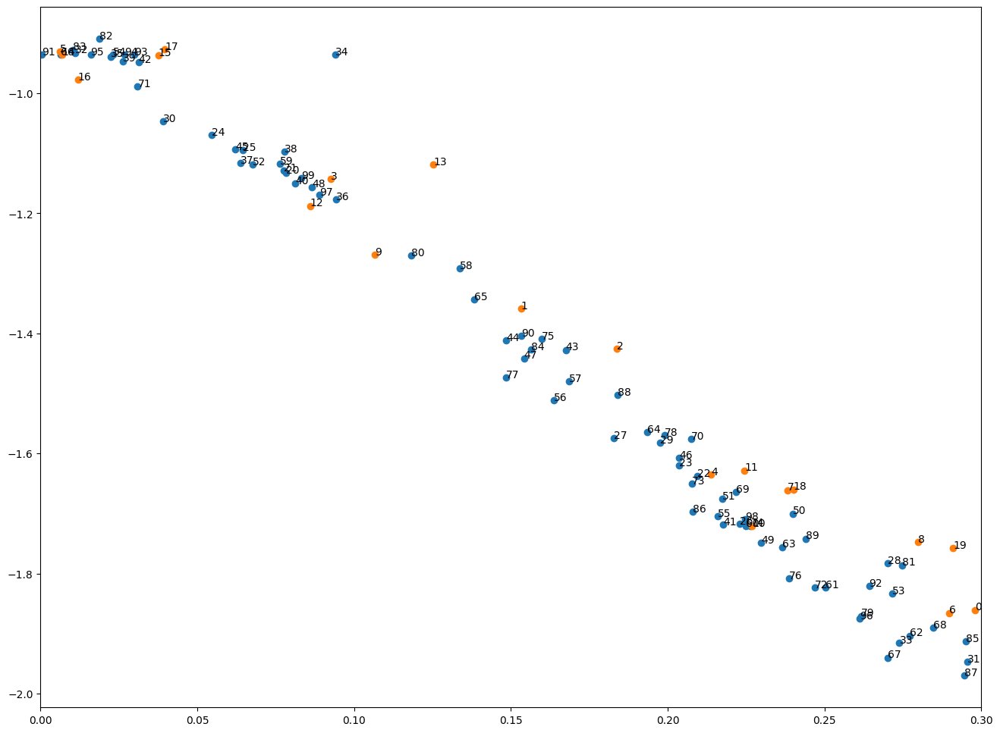

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-04-04 01:45:49.757907


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.2735614428593289
c = 0.19737632234231595
c = 0.24663490782727085
c = 0.0035345422851367657
c = 0.2138214998350688
c = 0.11712153491338158
c = 0.026382393829457784
c = 0.13753590733950216
c = 0.15512300780671862
c = 0.1043062674908136
c = 0.035461074056585995
c = 0.08564022264944944
c = 0.22483842647594376
1  c = 0.12164532229593572
c = 0.14477620463839433
c = 0.06125080109205028
c = 0.1740888597409452
c = 0.1009849463968301
2  c = 0.005493340718227679
c = 0.07216181595909328
c = 0.2290637577160764
c = 0.04373509185232009
c = 0.14449775033585244
c = 0.0070565020645093285
c = 0.2501012851067011
c = 0.17327267631023333
c = 0.12769009936150044
c = 0.04378156996329058
c = 0.15223125404611523
c = 0.17136318923694038
3  c = 0.11884327218636599
c = 0.24046260598496277
c = 0.17903701072660497
c = 0.2136129307934426
c = 0.1903076190304571
4  c = 0.23317945669240642
c = 0.259621630433307
c = 0.1402214363241976
c = 0.20393019335912893
c = 0.26155974665579906
c = 0.20404723320313325
c = 0.

c = 0.11006583967869761
c = 0.07526123597369357
c = 0.1302157093388894
c = 0.22349030030405526
c = 0.26481606586876666
c = 0.27263598394041666
c = 0.27473315651641833
38  c = 0.10016155875791793
c = 0.24867660754648796
c = 0.16775267023023702
c = 0.1304841740359288
c = 0.16863887928768762
c = 0.06091094790298213
c = 0.12667425868838
c = 0.08650565521174036
c = 0.06537933173771378
39  c = 0.021026007182114392
c = 0.030508015987150826
c = 0.2538313962288225
c = 0.2570778663794059
c = 0.13392588363799857
c = 0.09077134539859859
c = 0.13641888944380182
40  c = 0.25676751228754613
c = 0.15349358638982435
c = 0.031810985938634025
c = 0.23287922381327314
c = 0.13222264963458413
c = 0.17366192188513063
c = 0.06367661225233025
c = 0.23350412723737965
c = 0.019489177978912586
c = 0.26363215769311443
c = 0.024496090408954996
41  c = 0.018777433748862638
c = 0.25496874509860273
c = 0.23634460734105475
c = 0.2031565773618724
42  c = 0.1974063960663662
c = 0.2628673367119624
c = 0.09339274536524078


c = 0.0557182335361053
c = 0.1358470426595794
c = 0.22428388188044862
76  c = 0.1661717286406553
c = 0.024857694946325126
c = 0.252071885630258
c = 0.08729250329460249
c = 0.05185372226900141
c = 0.10107722689884245
c = 0.17335215972644663
77  c = 0.059871146315058375
c = 0.2841453353424276
c = 0.2158768047622705
c = 0.19066849525277366
c = 0.2853749726463039
c = 0.19893816545905443
c = 0.26313051817439237
c = 0.24841453540726643
c = 0.14410357064030993
78  c = 0.08258720678758866
c = 0.16912652281363674
c = 0.17030572535614388
c = 0.12538590569824937
79  c = 0.17861504349331941
c = 0.24510327605869373
c = 0.23086568000044314
c = 0.03498669642523173
c = 0.09671061270981508
c = 0.06753989892639457
c = 0.03381041027453215
c = 0.04127597985954335
c = 0.290655956794083
c = 0.17025938289363038
c = 0.0019776149374784668
c = 0.24777559153426937
c = 0.05039953661488537
c = 0.27559883421186043
c = 0.21974441408268258
c = 0.26009436467153846
c = 0.1571777895957095
80  c = 0.035062400287329896
c 

In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.18512  validloss 0.22197±0.00000  bestvalidloss 0.22197  last_update 0
train: iter 1  trainloss 0.16791  validloss 0.19031±0.00000  bestvalidloss 0.19031  last_update 0
train: iter 2  trainloss 0.16360  validloss 0.18430±0.00000  bestvalidloss 0.18430  last_update 0
train: iter 3  trainloss 0.16001  validloss 0.18288±0.00000  bestvalidloss 0.18288  last_update 0
train: iter 4  trainloss 0.15927  validloss 0.18082±0.00000  bestvalidloss 0.18082  last_update 0
train: iter 5  trainloss 0.15730  validloss 0.18071±0.00000  bestvalidloss 0.18071  last_update 0
train: iter 6  trainloss 0.15526  validloss 0.18024±0.00000  bestvalidloss 0.18024  last_update 0
train: iter 7  trainloss 0.15581  validloss 0.17842±0.00000  bestvalidloss 0.17842  last_update 0
train: iter 8  trainloss 0.15513  validloss 0.17990±0.00000  bestvalidloss 0.17842  last_update 1
train: iter 9  trainloss 0.15280  validloss 0.17656±0.00000  bestvalidloss 0.17656  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.14186  validloss 0.16490±0.00000  bestvalidloss 0.16412  last_update 3
train: iter 85  trainloss 0.14146  validloss 0.17082±0.00000  bestvalidloss 0.16412  last_update 4
train: iter 86  trainloss 0.14015  validloss 0.16474±0.00000  bestvalidloss 0.16412  last_update 5
train: iter 87  trainloss 0.14118  validloss 0.16395±0.00000  bestvalidloss 0.16395  last_update 0
train: iter 88  trainloss 0.13995  validloss 0.16663±0.00000  bestvalidloss 0.16395  last_update 1
train: iter 89  trainloss 0.14122  validloss 0.16380±0.00000  bestvalidloss 0.16380  last_update 0
train: iter 90  trainloss 0.14062  validloss 0.16787±0.00000  bestvalidloss 0.16380  last_update 1
train: iter 91  trainloss 0.13942  validloss 0.16489±0.00000  bestvalidloss 0.16380  last_update 2
train: iter 92  trainloss 0.14170  validloss 0.16771±0.00000  bestvalidloss 0.16380  last_update 3
train: iter 93  trainloss 0.14181  validloss 0.16730±0.00000  bestvalidloss 0.16380  last_update 4
train: ite

train: iter 168  trainloss 0.13953  validloss 0.17043±0.00000  bestvalidloss 0.15984  last_update 2
train: iter 169  trainloss 0.13786  validloss 0.16114±0.00000  bestvalidloss 0.15984  last_update 3
train: iter 170  trainloss 0.13919  validloss 0.16282±0.00000  bestvalidloss 0.15984  last_update 4
train: iter 171  trainloss 0.13564  validloss 0.17061±0.00000  bestvalidloss 0.15984  last_update 5
train: iter 172  trainloss 0.13591  validloss 0.16367±0.00000  bestvalidloss 0.15984  last_update 6
train: iter 173  trainloss 0.13607  validloss 0.16090±0.00000  bestvalidloss 0.15984  last_update 7
train: iter 174  trainloss 0.13780  validloss 0.16353±0.00000  bestvalidloss 0.15984  last_update 8
train: iter 175  trainloss 0.13800  validloss 0.15965±0.00000  bestvalidloss 0.15965  last_update 0
train: iter 176  trainloss 0.13741  validloss 0.16753±0.00000  bestvalidloss 0.15965  last_update 1
train: iter 177  trainloss 0.13683  validloss 0.16006±0.00000  bestvalidloss 0.15965  last_update 2


train: iter 252  trainloss 0.13401  validloss 0.15919±0.00000  bestvalidloss 0.15865  last_update 14
train: iter 253  trainloss 0.13624  validloss 0.15985±0.00000  bestvalidloss 0.15865  last_update 15
train: iter 254  trainloss 0.13320  validloss 0.15839±0.00000  bestvalidloss 0.15839  last_update 0
train: iter 255  trainloss 0.13414  validloss 0.15977±0.00000  bestvalidloss 0.15839  last_update 1
train: iter 256  trainloss 0.13286  validloss 0.16028±0.00000  bestvalidloss 0.15839  last_update 2
train: iter 257  trainloss 0.13362  validloss 0.16028±0.00000  bestvalidloss 0.15839  last_update 3
train: iter 258  trainloss 0.13344  validloss 0.16032±0.00000  bestvalidloss 0.15839  last_update 4
train: iter 259  trainloss 0.13357  validloss 0.15932±0.00000  bestvalidloss 0.15839  last_update 5
train: iter 260  trainloss 0.13271  validloss 0.15972±0.00000  bestvalidloss 0.15839  last_update 6
train: iter 261  trainloss 0.13352  validloss 0.16034±0.00000  bestvalidloss 0.15839  last_update 

train: iter 336  trainloss 0.13402  validloss 0.15913±0.00000  bestvalidloss 0.15813  last_update 19
train: iter 337  trainloss 0.13230  validloss 0.15861±0.00000  bestvalidloss 0.15813  last_update 20
train: iter 338  trainloss 0.13246  validloss 0.15888±0.00000  bestvalidloss 0.15813  last_update 21
train: iter 339  trainloss 0.13194  validloss 0.15917±0.00000  bestvalidloss 0.15813  last_update 22
train: iter 340  trainloss 0.13121  validloss 0.15805±0.00000  bestvalidloss 0.15805  last_update 0
train: iter 341  trainloss 0.13192  validloss 0.15981±0.00000  bestvalidloss 0.15805  last_update 1
train: iter 342  trainloss 0.13216  validloss 0.16013±0.00000  bestvalidloss 0.15805  last_update 2
train: iter 343  trainloss 0.13327  validloss 0.15898±0.00000  bestvalidloss 0.15805  last_update 3
train: iter 344  trainloss 0.13162  validloss 0.15992±0.00000  bestvalidloss 0.15805  last_update 4
train: iter 345  trainloss 0.13171  validloss 0.15954±0.00000  bestvalidloss 0.15805  last_updat

train: iter 420  trainloss 0.13149  validloss 0.15932±0.00000  bestvalidloss 0.15768  last_update 56
train: iter 421  trainloss 0.13082  validloss 0.15868±0.00000  bestvalidloss 0.15768  last_update 57
train: iter 422  trainloss 0.13237  validloss 0.16025±0.00000  bestvalidloss 0.15768  last_update 58
train: iter 423  trainloss 0.13213  validloss 0.15833±0.00000  bestvalidloss 0.15768  last_update 59
train: iter 424  trainloss 0.13029  validloss 0.15805±0.00000  bestvalidloss 0.15768  last_update 60
train: iter 425  trainloss 0.13065  validloss 0.15976±0.00000  bestvalidloss 0.15768  last_update 61
train: iter 426  trainloss 0.13026  validloss 0.16109±0.00000  bestvalidloss 0.15768  last_update 62
train: iter 427  trainloss 0.13065  validloss 0.16446±0.00000  bestvalidloss 0.15768  last_update 63
train: iter 428  trainloss 0.13084  validloss 0.16044±0.00000  bestvalidloss 0.15768  last_update 64
train: iter 429  trainloss 0.13072  validloss 0.15839±0.00000  bestvalidloss 0.15768  last_

train: iter 503  trainloss 0.13393  validloss 0.16107±0.00000  bestvalidloss 0.15672  last_update 65
train: iter 504  trainloss 0.12916  validloss 0.15739±0.00000  bestvalidloss 0.15672  last_update 66
train: iter 505  trainloss 0.13028  validloss 0.16586±0.00000  bestvalidloss 0.15672  last_update 67
train: iter 506  trainloss 0.12955  validloss 0.15823±0.00000  bestvalidloss 0.15672  last_update 68
train: iter 507  trainloss 0.12922  validloss 0.15931±0.00000  bestvalidloss 0.15672  last_update 69
train: iter 508  trainloss 0.12964  validloss 0.15881±0.00000  bestvalidloss 0.15672  last_update 70
train: iter 509  trainloss 0.12906  validloss 0.16239±0.00000  bestvalidloss 0.15672  last_update 71
train: iter 510  trainloss 0.13142  validloss 0.15714±0.00000  bestvalidloss 0.15672  last_update 72
train: iter 511  trainloss 0.13037  validloss 0.17240±0.00000  bestvalidloss 0.15672  last_update 73
train: iter 512  trainloss 0.12861  validloss 0.15712±0.00000  bestvalidloss 0.15672  last_

train: iter 588  trainloss 0.13049  validloss 0.16625±0.00000  bestvalidloss 0.15645  last_update 52
train: iter 589  trainloss 0.12845  validloss 0.15809±0.00000  bestvalidloss 0.15645  last_update 53
train: iter 590  trainloss 0.12747  validloss 0.15778±0.00000  bestvalidloss 0.15645  last_update 54
train: iter 591  trainloss 0.12891  validloss 0.15611±0.00000  bestvalidloss 0.15611  last_update 0
train: iter 592  trainloss 0.12910  validloss 0.15764±0.00000  bestvalidloss 0.15611  last_update 1
train: iter 593  trainloss 0.12813  validloss 0.15829±0.00000  bestvalidloss 0.15611  last_update 2
train: iter 594  trainloss 0.12759  validloss 0.15668±0.00000  bestvalidloss 0.15611  last_update 3
train: iter 595  trainloss 0.12929  validloss 0.15826±0.00000  bestvalidloss 0.15611  last_update 4
train: iter 596  trainloss 0.12967  validloss 0.15875±0.00000  bestvalidloss 0.15611  last_update 5
train: iter 597  trainloss 0.12898  validloss 0.15791±0.00000  bestvalidloss 0.15611  last_update

train: iter 671  trainloss 0.12655  validloss 0.15857±0.00000  bestvalidloss 0.15607  last_update 14
train: iter 672  trainloss 0.12730  validloss 0.16102±0.00000  bestvalidloss 0.15607  last_update 15
train: iter 673  trainloss 0.12705  validloss 0.15612±0.00000  bestvalidloss 0.15607  last_update 16
train: iter 674  trainloss 0.12716  validloss 0.15612±0.00000  bestvalidloss 0.15607  last_update 17
train: iter 675  trainloss 0.12795  validloss 0.16681±0.00000  bestvalidloss 0.15607  last_update 18
train: iter 676  trainloss 0.13261  validloss 0.15798±0.00000  bestvalidloss 0.15607  last_update 19
train: iter 677  trainloss 0.12700  validloss 0.15728±0.00000  bestvalidloss 0.15607  last_update 20
train: iter 678  trainloss 0.12725  validloss 0.15797±0.00000  bestvalidloss 0.15607  last_update 21
train: iter 679  trainloss 0.12634  validloss 0.15784±0.00000  bestvalidloss 0.15607  last_update 22
train: iter 680  trainloss 0.12613  validloss 0.15750±0.00000  bestvalidloss 0.15607  last_

train: iter 757  trainloss 0.12690  validloss 0.15645±0.00000  bestvalidloss 0.15450  last_update 25
train: iter 758  trainloss 0.12876  validloss 0.15610±0.00000  bestvalidloss 0.15450  last_update 26
train: iter 759  trainloss 0.12629  validloss 0.15724±0.00000  bestvalidloss 0.15450  last_update 27
train: iter 760  trainloss 0.12779  validloss 0.15919±0.00000  bestvalidloss 0.15450  last_update 28
train: iter 761  trainloss 0.12660  validloss 0.15902±0.00000  bestvalidloss 0.15450  last_update 29
train: iter 762  trainloss 0.12619  validloss 0.15749±0.00000  bestvalidloss 0.15450  last_update 30
train: iter 763  trainloss 0.12602  validloss 0.15538±0.00000  bestvalidloss 0.15450  last_update 31
train: iter 764  trainloss 0.12907  validloss 0.15749±0.00000  bestvalidloss 0.15450  last_update 32
train: iter 765  trainloss 0.12662  validloss 0.15628±0.00000  bestvalidloss 0.15450  last_update 33
train: iter 766  trainloss 0.12639  validloss 0.15780±0.00000  bestvalidloss 0.15450  last_

train: iter 842  trainloss 0.12538  validloss 0.15807±0.00000  bestvalidloss 0.15436  last_update 62
train: iter 843  trainloss 0.12498  validloss 0.15629±0.00000  bestvalidloss 0.15436  last_update 63
train: iter 844  trainloss 0.12666  validloss 0.15732±0.00000  bestvalidloss 0.15436  last_update 64
train: iter 845  trainloss 0.12525  validloss 0.15572±0.00000  bestvalidloss 0.15436  last_update 65
train: iter 846  trainloss 0.12516  validloss 0.15427±0.00000  bestvalidloss 0.15427  last_update 0
train: iter 847  trainloss 0.12488  validloss 0.15527±0.00000  bestvalidloss 0.15427  last_update 1
train: iter 848  trainloss 0.12419  validloss 0.15757±0.00000  bestvalidloss 0.15427  last_update 2
train: iter 849  trainloss 0.12504  validloss 0.15525±0.00000  bestvalidloss 0.15427  last_update 3
train: iter 850  trainloss 0.12568  validloss 0.15507±0.00000  bestvalidloss 0.15427  last_update 4
train: iter 851  trainloss 0.12631  validloss 0.15799±0.00000  bestvalidloss 0.15427  last_updat

train: iter 927  trainloss 0.12504  validloss 0.15927±0.00000  bestvalidloss 0.15397  last_update 24
train: iter 928  trainloss 0.12636  validloss 0.15529±0.00000  bestvalidloss 0.15397  last_update 25
train: iter 929  trainloss 0.12421  validloss 0.15464±0.00000  bestvalidloss 0.15397  last_update 26
train: iter 930  trainloss 0.12417  validloss 0.15553±0.00000  bestvalidloss 0.15397  last_update 27
train: iter 931  trainloss 0.12540  validloss 0.15487±0.00000  bestvalidloss 0.15397  last_update 28
train: iter 932  trainloss 0.12390  validloss 0.15635±0.00000  bestvalidloss 0.15397  last_update 29
train: iter 933  trainloss 0.12399  validloss 0.15576±0.00000  bestvalidloss 0.15397  last_update 30
train: iter 934  trainloss 0.12394  validloss 0.15604±0.00000  bestvalidloss 0.15397  last_update 31
train: iter 935  trainloss 0.12429  validloss 0.15651±0.00000  bestvalidloss 0.15397  last_update 32
train: iter 936  trainloss 0.12400  validloss 0.15451±0.00000  bestvalidloss 0.15397  last_

train: iter 1011  trainloss 0.12416  validloss 0.15530±0.00000  bestvalidloss 0.15380  last_update 20
train: iter 1012  trainloss 0.12314  validloss 0.15755±0.00000  bestvalidloss 0.15380  last_update 21
train: iter 1013  trainloss 0.12333  validloss 0.16092±0.00000  bestvalidloss 0.15380  last_update 22
train: iter 1014  trainloss 0.12393  validloss 0.15877±0.00000  bestvalidloss 0.15380  last_update 23
train: iter 1015  trainloss 0.12544  validloss 0.16991±0.00000  bestvalidloss 0.15380  last_update 24
train: iter 1016  trainloss 0.12350  validloss 0.15411±0.00000  bestvalidloss 0.15380  last_update 25
train: iter 1017  trainloss 0.12435  validloss 0.16263±0.00000  bestvalidloss 0.15380  last_update 26
train: iter 1018  trainloss 0.12430  validloss 0.15619±0.00000  bestvalidloss 0.15380  last_update 27
train: iter 1019  trainloss 0.12492  validloss 0.15474±0.00000  bestvalidloss 0.15380  last_update 28
train: iter 1020  trainloss 0.12382  validloss 0.15620±0.00000  bestvalidloss 0.15

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -174.99947201848028
valid_loss:  -251.11901848316194
train_loss:  -182.30914004802705
valid_loss:  -172.06234855651854


1e-08 1000.0


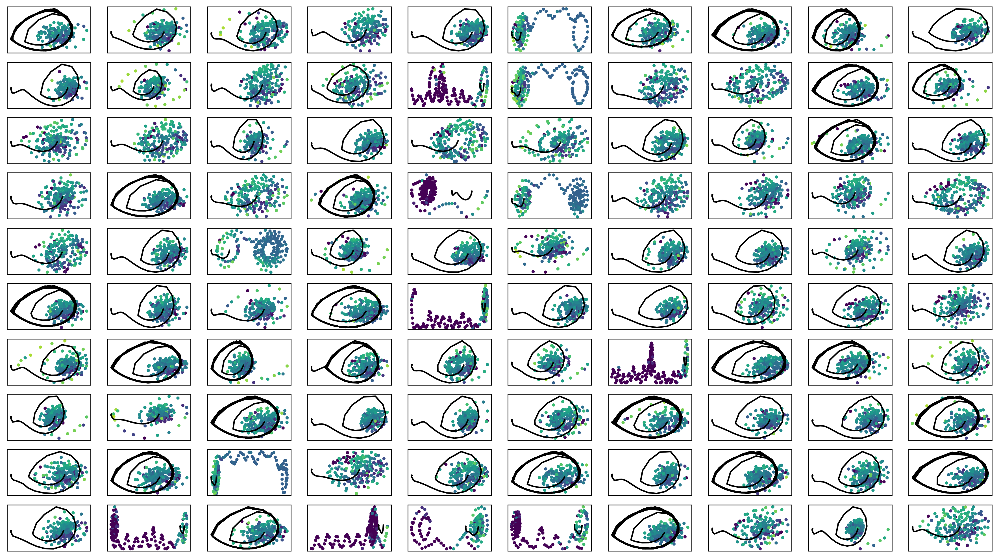

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -176.48944  validloss -171.00356±0.00000  bestvalidloss -171.00356  last_update 0
train: iter 1  trainloss -180.73448  validloss -170.01877±0.00000  bestvalidloss -171.00356  last_update 1
train: iter 2  trainloss -177.70742  validloss -168.98645±0.00000  bestvalidloss -171.00356  last_update 2
train: iter 3  trainloss -179.02264  validloss -169.38619±0.00000  bestvalidloss -171.00356  last_update 3
train: iter 4  trainloss -174.25264  validloss -175.91631±0.00000  bestvalidloss -175.91631  last_update 0
train: iter 5  trainloss -180.79617  validloss -172.53306±0.00000  bestvalidloss -175.91631  last_update 1
train: iter 6  trainloss -178.03459  validloss -185.90405±0.00000  bestvalidloss -185.90405  last_update 0
train: iter 7  trainloss -178.87309  validloss -173.76206±0.00000  bestvalidloss -185.90405  last_update 1
train: iter 8  trainloss -173.27756  validloss -162.73265±0.00000  bestvalidloss -185.90405  last_update 2
train: it

train: iter 76  trainloss -180.04123  validloss -149.31415±0.00000  bestvalidloss -189.33490  last_update 45
train: iter 77  trainloss -178.97494  validloss -170.67845±0.00000  bestvalidloss -189.33490  last_update 46
train: iter 78  trainloss -179.25460  validloss -147.85594±0.00000  bestvalidloss -189.33490  last_update 47
train: iter 79  trainloss -179.38732  validloss -175.87396±0.00000  bestvalidloss -189.33490  last_update 48
train: iter 80  trainloss -180.93228  validloss -179.50469±0.00000  bestvalidloss -189.33490  last_update 49
train: iter 81  trainloss -180.03406  validloss -181.25592±0.00000  bestvalidloss -189.33490  last_update 50
train: iter 82  trainloss -179.31876  validloss -191.24169±0.00000  bestvalidloss -191.24169  last_update 0
train: iter 83  trainloss -176.08447  validloss -177.07664±0.00000  bestvalidloss -191.24169  last_update 1
train: iter 84  trainloss -180.37885  validloss -177.50770±0.00000  bestvalidloss -191.24169  last_update 2
train: iter 85  trainl

train: iter 151  trainloss -180.06384  validloss -184.51619±0.00000  bestvalidloss -191.24169  last_update 69
train: iter 152  trainloss -178.51884  validloss -174.71573±0.00000  bestvalidloss -191.24169  last_update 70
train: iter 153  trainloss -180.96832  validloss -171.22657±0.00000  bestvalidloss -191.24169  last_update 71
train: iter 154  trainloss -180.34306  validloss -180.85908±0.00000  bestvalidloss -191.24169  last_update 72
train: iter 155  trainloss -173.10384  validloss -168.23955±0.00000  bestvalidloss -191.24169  last_update 73
train: iter 156  trainloss -179.36538  validloss -147.38395±0.00000  bestvalidloss -191.24169  last_update 74
train: iter 157  trainloss -181.24950  validloss -164.94018±0.00000  bestvalidloss -191.24169  last_update 75
train: iter 158  trainloss -178.37113  validloss -151.70065±0.00000  bestvalidloss -191.24169  last_update 76
train: iter 159  trainloss -174.85445  validloss -148.96017±0.00000  bestvalidloss -191.24169  last_update 77
train: ite

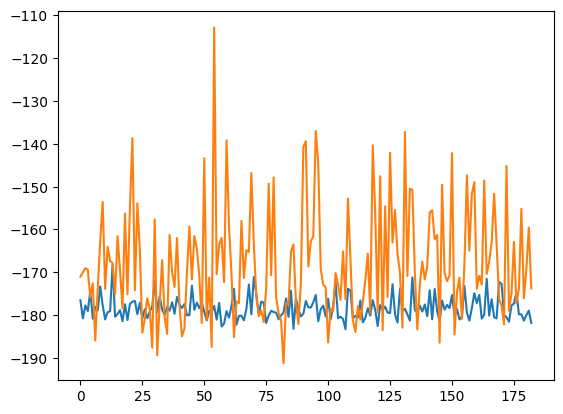

train_weighted_vae: enc
train: iter 0  trainloss -173.67126  validloss -135.43267±0.00000  bestvalidloss -135.43267  last_update 0
train: iter 1  trainloss -177.36497  validloss -168.77499±0.00000  bestvalidloss -168.77499  last_update 0
train: iter 2  trainloss -174.61418  validloss -142.36552±0.00000  bestvalidloss -168.77499  last_update 1
train: iter 3  trainloss -175.41279  validloss -144.25691±0.00000  bestvalidloss -168.77499  last_update 2
train: iter 4  trainloss -175.47294  validloss -158.79708±0.00000  bestvalidloss -168.77499  last_update 3
train: iter 5  trainloss -174.43892  validloss -154.34047±0.00000  bestvalidloss -168.77499  last_update 4
train: iter 6  trainloss -176.59971  validloss -151.53732±0.00000  bestvalidloss -168.77499  last_update 5
train: iter 7  trainloss -176.76540  validloss -164.85932±0.00000  bestvalidloss -168.77499  last_update 6
train: iter 8  trainloss -175.22984  validloss -156.27588±0.00000  bestvalidloss -168.77499  last_update 7
train: iter 9

train: iter 76  trainloss -176.89776  validloss -150.54331±0.00000  bestvalidloss -177.53476  last_update 52
train: iter 77  trainloss -177.94810  validloss -153.25336±0.00000  bestvalidloss -177.53476  last_update 53
train: iter 78  trainloss -176.12953  validloss -161.12714±0.00000  bestvalidloss -177.53476  last_update 54
train: iter 79  trainloss -175.17075  validloss -120.84462±0.00000  bestvalidloss -177.53476  last_update 55
train: iter 80  trainloss -175.06035  validloss -132.33025±0.00000  bestvalidloss -177.53476  last_update 56
train: iter 81  trainloss -174.39789  validloss -137.92278±0.00000  bestvalidloss -177.53476  last_update 57
train: iter 82  trainloss -174.54594  validloss -171.47113±0.00000  bestvalidloss -177.53476  last_update 58
train: iter 83  trainloss -173.89506  validloss -153.24414±0.00000  bestvalidloss -177.53476  last_update 59
train: iter 84  trainloss -165.97536  validloss -156.84418±0.00000  bestvalidloss -177.53476  last_update 60
train: iter 85  tra

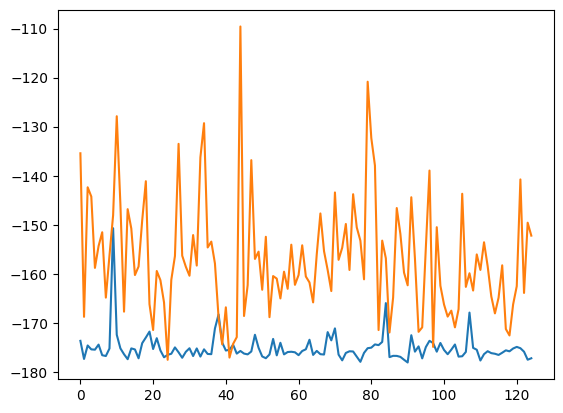

train_weighted_vae: dec
train: iter 0  trainloss -184.46346  validloss -157.90365±0.00000  bestvalidloss -157.90365  last_update 0
train: iter 1  trainloss -183.66053  validloss -172.92301±0.00000  bestvalidloss -172.92301  last_update 0
train: iter 2  trainloss -182.70105  validloss -162.76771±0.00000  bestvalidloss -172.92301  last_update 1
train: iter 3  trainloss -182.63678  validloss -141.74121±0.00000  bestvalidloss -172.92301  last_update 2
train: iter 4  trainloss -183.33226  validloss -146.60333±0.00000  bestvalidloss -172.92301  last_update 3
train: iter 5  trainloss -184.47436  validloss -165.74644±0.00000  bestvalidloss -172.92301  last_update 4
train: iter 6  trainloss -184.77065  validloss -170.63170±0.00000  bestvalidloss -172.92301  last_update 5
train: iter 7  trainloss -183.22049  validloss -148.27848±0.00000  bestvalidloss -172.92301  last_update 6
train: iter 8  trainloss -184.77559  validloss -160.34125±0.00000  bestvalidloss -172.92301  last_update 7
train: iter 9

train: iter 76  trainloss -184.13675  validloss -162.50958±0.00000  bestvalidloss -177.16567  last_update 66
train: iter 77  trainloss -184.40956  validloss -148.35385±0.00000  bestvalidloss -177.16567  last_update 67
train: iter 78  trainloss -184.55884  validloss -145.48944±0.00000  bestvalidloss -177.16567  last_update 68
train: iter 79  trainloss -182.47077  validloss -167.03339±0.00000  bestvalidloss -177.16567  last_update 69
train: iter 80  trainloss -182.05183  validloss -118.25380±0.00000  bestvalidloss -177.16567  last_update 70
train: iter 81  trainloss -184.87659  validloss -167.64291±0.00000  bestvalidloss -177.16567  last_update 71
train: iter 82  trainloss -186.43155  validloss -171.02400±0.00000  bestvalidloss -177.16567  last_update 72
train: iter 83  trainloss -185.65463  validloss -153.01960±0.00000  bestvalidloss -177.16567  last_update 73
train: iter 84  trainloss -180.29438  validloss -157.85233±0.00000  bestvalidloss -177.16567  last_update 74
train: iter 85  tra

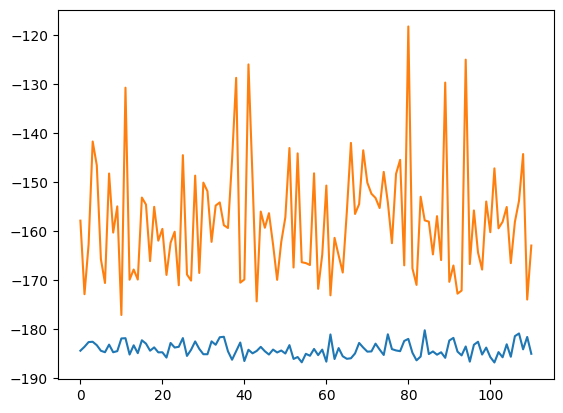

alpha 0.3 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.05184824304935028
1  c = 0.2529391340532123
2  c = 0.21376889785084127
3  c = 0.049242850021030314
4  c = 0.16347204767156714
5  c = 0.046266321936966524
6  c = 0.07298523868330284
7  c = 0.11594503856006243
8  c = 0.28948958889092186
9  c = 0.0909954389771499
10  c = 0.17319521138263477
11  c = 0.06307724053242084
12  c = 0.018607274027982533
13  c = 0.06577708016165242
14  c = 0.28078295434883027
15  c = 0.1855889792054566
16  c = 0.1046438020364191
17  c = 0.04320551789072944
18  c = 0.14863585755184278
19  c = 0.08767469010567959
20  c = 0.09772915530136912
21  c = 0.15682756907447862
22  c = 0.23348309301967343
23  c = 0.09953450322230079
24  c = 0.07772897787435175
25  c = 0.14677575037157922
26  c = 0.15102513994797848
27  c = 0.19555185810762096
28  c = 0.25356863125675777
29  c = 0.05422210287009758
30  c = 0.08144398896225649
31  c = 0.04195482389959269
32  c = 0.19768150169595647
33  c = 0.05169613877697882
34  c = 0.019792360038457444
35  c = 0.14072353866864032
36

95  c = 0.2742154466041417
96  c = 0.24843531467961727
97  c = 0.29649256804626567
98  c = 0.07426741897378726
99  c = 0.0034108935951333796
 
実環境方策rollout vs Sim環境方策rollout


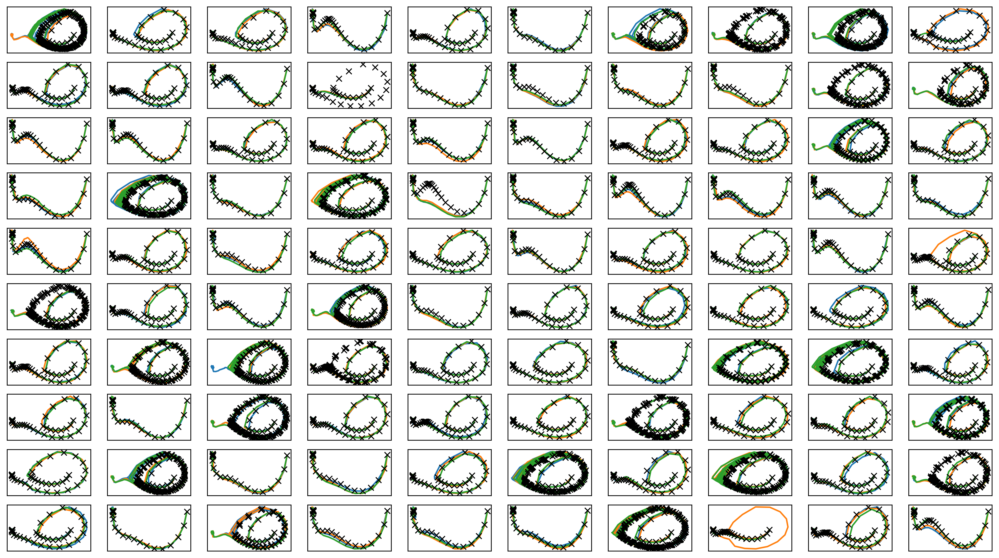

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

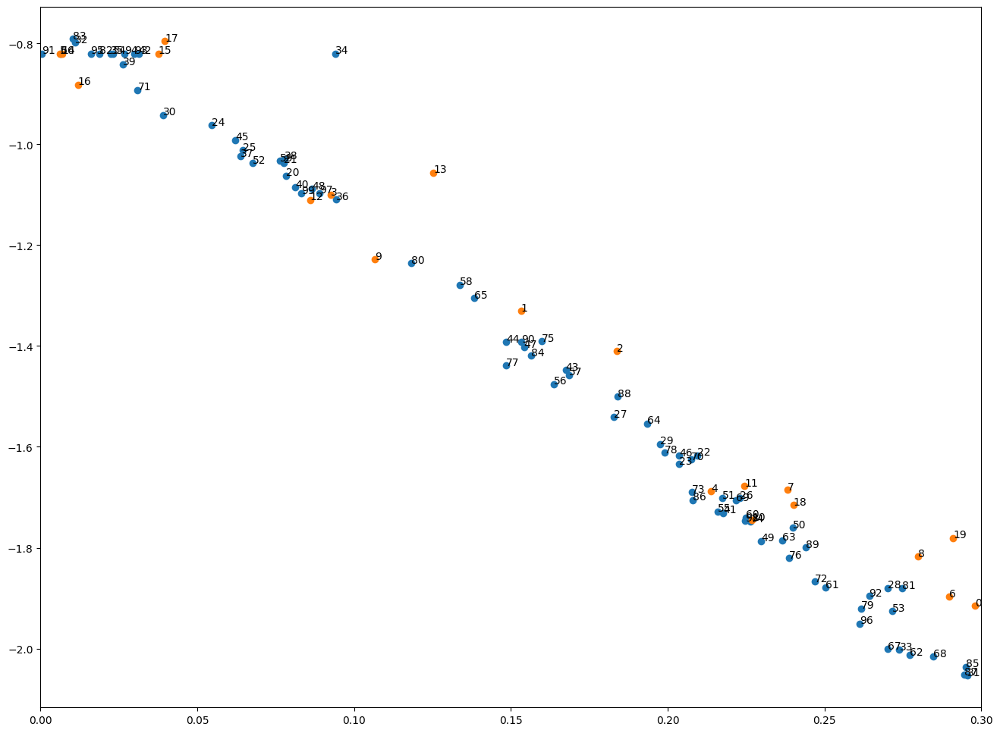

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-04-04 01:49:01.893649


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.1291416903324736
c = 0.04113112631306058
c = 0.17125202577141815
c = 0.21655731560520555
c = 0.059042082329986964
c = 0.2626902348210787
c = 0.2819918983400506
c = 0.2038275886670018
c = 0.2913163677031838
c = 0.2110655093748364
c = 0.1283572662870152
c = 0.0183477364851778
c = 0.17157822056335734
1  c = 0.2508005840107313
c = 0.11023634107649734
c = 0.17900302857242284
c = 0.2523260643595241
c = 0.06447531415786245
c = 0.14288262635126792
c = 0.2805254509335254
c = 0.20578259088291026
c = 0.1946622902209769
c = 0.2200925309038579
2  c = 0.06796860212693684
c = 0.1933800856311533
c = 0.12552678627528377
c = 0.06115402698841865
c = 0.22844931029942506
c = 0.26170772211176835
c = 0.10485382596289561
c = 0.20099666722493298
c = 0.23390988265757606
c = 0.07331758819729203
c = 0.03791677817306231
c = 0.19195498343581271
c = 0.06689745682612563
c = 0.2610548169126173
3  c = 0.29545643762616053
c = 0.225321800269851
c = 0.020682244513117752
c = 0.27340072917331026
c = 0.0225243193721

c = 0.2754942396910435
c = 0.19542432974473403
c = 0.1525121607683708
c = 0.1508023756740068
c = 0.001066179099139841
c = 0.21172272022099234
39  c = 0.1939547116737133
c = 0.211044350028902
c = 0.05094401816172543
c = 0.030442474355693114
c = 0.16878244679569904
c = 0.18396426817076242
c = 0.06283336843175953
c = 0.15698364978733217
c = 0.26833200457066475
c = 0.1789586352072164
c = 0.018639526806702333
c = 0.16748652908720477
c = 0.057564925425216705
c = 0.19063831395663497
c = 0.250983661590116
40  c = 0.05339204151791144
c = 0.12150705564738072
c = 0.25840082339546033
c = 0.22877884309539606
c = 0.025595563260796515
c = 0.29914268553254225
41  c = 0.15096029568742314
c = 0.28268754023907156
c = 0.039958764422120915
c = 0.004757557112478006
c = 0.05231533879955717
c = 0.2646314414140453
c = 0.2191277988927236
42  c = 0.05264991371438168
c = 0.17942692708258792
c = 0.27082192327828075
c = 0.15935718007188165
c = 0.1798914566182179
c = 0.026692816084455683
43  c = 0.058762002908849226

c = 0.2160958702524881
c = 0.060404338434346345
78  c = 0.17917828145064996
c = 0.19814159732737768
c = 0.11835575986169282
c = 0.2554213178454191
c = 0.18580259164029808
c = 0.1996634557100391
c = 0.2852305532851172
c = 0.07899928442219838
c = 0.13276044286715008
c = 0.03702735521816904
79  c = 0.2593323222159236
c = 0.28784114909062714
c = 0.27083544612114485
c = 0.021551801411887183
c = 0.25755530178639063
c = 0.049584015567754144
c = 0.05961360975000993
c = 0.004413370592018806
c = 0.22260457830804847
c = 0.21241897431166162
80  c = 0.012724063268569208
c = 0.15433342309009507
c = 0.22846136907952752
c = 0.09216358181194302
c = 0.19608010761327438
c = 0.18822038028969096
c = 0.2567373162468605
81  c = 0.21946246487445947
c = 0.2232857329494569
c = 0.2476686717660744
c = 0.2568522056659882
c = 0.22311697110571216
c = 0.2936607591937887
c = 0.1690751223581259
c = 0.14679871720618445
c = 0.18590867496795738
c = 0.23739816436217037
c = 0.20986211995829387
82  c = 0.2966514059093321
c =

In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.13660  validloss 0.16423±0.00000  bestvalidloss 0.16423  last_update 0
train: iter 1  trainloss 0.13228  validloss 0.16085±0.00000  bestvalidloss 0.16085  last_update 0
train: iter 2  trainloss 0.13000  validloss 0.16229±0.00000  bestvalidloss 0.16085  last_update 1
train: iter 3  trainloss 0.13065  validloss 0.16107±0.00000  bestvalidloss 0.16085  last_update 2
train: iter 4  trainloss 0.12969  validloss 0.16130±0.00000  bestvalidloss 0.16085  last_update 3
train: iter 5  trainloss 0.13074  validloss 0.15973±0.00000  bestvalidloss 0.15973  last_update 0
train: iter 6  trainloss 0.12844  validloss 0.16173±0.00000  bestvalidloss 0.15973  last_update 1
train: iter 7  trainloss 0.13051  validloss 0.16590±0.00000  bestvalidloss 0.15973  last_update 2
train: iter 8  trainloss 0.12891  validloss 0.15977±0.00000  bestvalidloss 0.15973  last_update 3
train: iter 9  trainloss 0.12813  validloss 0.16135±0.00000  bestvalidloss 0.15973  last_update 4
train: iter 10  trai

train: iter 84  trainloss 0.12538  validloss 0.15698±0.00000  bestvalidloss 0.15669  last_update 36
train: iter 85  trainloss 0.12555  validloss 0.15837±0.00000  bestvalidloss 0.15669  last_update 37
train: iter 86  trainloss 0.12535  validloss 0.15852±0.00000  bestvalidloss 0.15669  last_update 38
train: iter 87  trainloss 0.12459  validloss 0.15707±0.00000  bestvalidloss 0.15669  last_update 39
train: iter 88  trainloss 0.12454  validloss 0.15649±0.00000  bestvalidloss 0.15649  last_update 0
train: iter 89  trainloss 0.12562  validloss 0.15923±0.00000  bestvalidloss 0.15649  last_update 1
train: iter 90  trainloss 0.12508  validloss 0.16010±0.00000  bestvalidloss 0.15649  last_update 2
train: iter 91  trainloss 0.12588  validloss 0.16252±0.00000  bestvalidloss 0.15649  last_update 3
train: iter 92  trainloss 0.12493  validloss 0.15829±0.00000  bestvalidloss 0.15649  last_update 4
train: iter 93  trainloss 0.12503  validloss 0.15805±0.00000  bestvalidloss 0.15649  last_update 5
train:

train: iter 168  trainloss 0.12255  validloss 0.15788±0.00000  bestvalidloss 0.15537  last_update 62
train: iter 169  trainloss 0.12424  validloss 0.16184±0.00000  bestvalidloss 0.15537  last_update 63
train: iter 170  trainloss 0.12242  validloss 0.15684±0.00000  bestvalidloss 0.15537  last_update 64
train: iter 171  trainloss 0.12525  validloss 0.16169±0.00000  bestvalidloss 0.15537  last_update 65
train: iter 172  trainloss 0.12293  validloss 0.16177±0.00000  bestvalidloss 0.15537  last_update 66
train: iter 173  trainloss 0.12379  validloss 0.15820±0.00000  bestvalidloss 0.15537  last_update 67
train: iter 174  trainloss 0.12267  validloss 0.15703±0.00000  bestvalidloss 0.15537  last_update 68
train: iter 175  trainloss 0.12409  validloss 0.15617±0.00000  bestvalidloss 0.15537  last_update 69
train: iter 176  trainloss 0.12268  validloss 0.15553±0.00000  bestvalidloss 0.15537  last_update 70
train: iter 177  trainloss 0.12296  validloss 0.15874±0.00000  bestvalidloss 0.15537  last_

train: iter 252  trainloss 0.12215  validloss 0.16333±0.00000  bestvalidloss 0.15478  last_update 21
train: iter 253  trainloss 0.12167  validloss 0.15581±0.00000  bestvalidloss 0.15478  last_update 22
train: iter 254  trainloss 0.12142  validloss 0.15678±0.00000  bestvalidloss 0.15478  last_update 23
train: iter 255  trainloss 0.12318  validloss 0.15742±0.00000  bestvalidloss 0.15478  last_update 24
train: iter 256  trainloss 0.12216  validloss 0.15826±0.00000  bestvalidloss 0.15478  last_update 25
train: iter 257  trainloss 0.12281  validloss 0.15638±0.00000  bestvalidloss 0.15478  last_update 26
train: iter 258  trainloss 0.12146  validloss 0.15551±0.00000  bestvalidloss 0.15478  last_update 27
train: iter 259  trainloss 0.12145  validloss 0.15646±0.00000  bestvalidloss 0.15478  last_update 28
train: iter 260  trainloss 0.12201  validloss 0.15536±0.00000  bestvalidloss 0.15478  last_update 29
train: iter 261  trainloss 0.12398  validloss 0.15701±0.00000  bestvalidloss 0.15478  last_

In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -225.79623475015165
valid_loss:  -254.0834005594254
train_loss:  -174.2633027255535
valid_loss:  -139.36172540426253


1e-08 1000.0


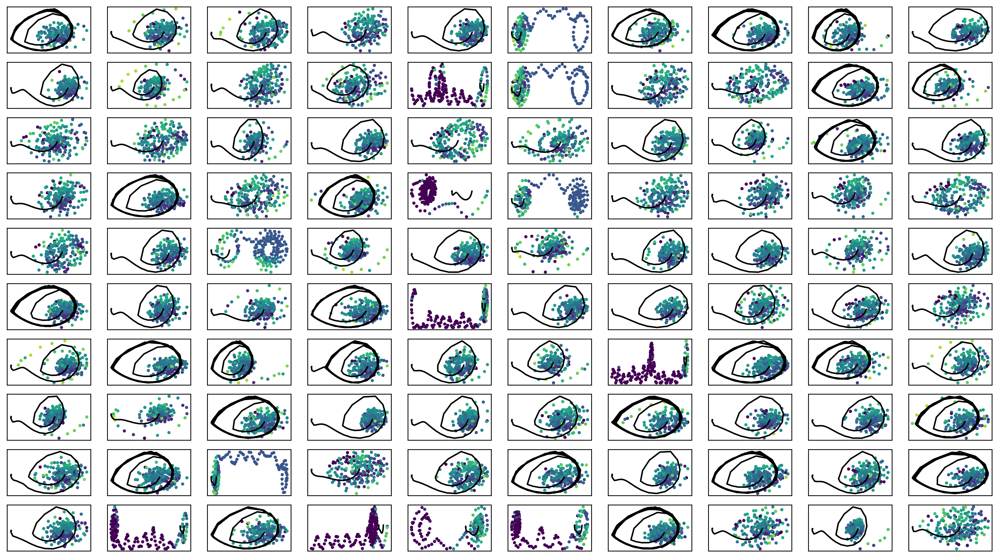

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -169.02100  validloss -144.98329±0.00000  bestvalidloss -144.98329  last_update 0
train: iter 1  trainloss -169.68460  validloss -149.99542±0.00000  bestvalidloss -149.99542  last_update 0
train: iter 2  trainloss -167.41929  validloss -157.36062±0.00000  bestvalidloss -157.36062  last_update 0
train: iter 3  trainloss -171.98010  validloss -143.18354±0.00000  bestvalidloss -157.36062  last_update 1
train: iter 4  trainloss -169.75639  validloss -163.99790±0.00000  bestvalidloss -163.99790  last_update 0
train: iter 5  trainloss -172.40854  validloss -168.16247±0.00000  bestvalidloss -168.16247  last_update 0
train: iter 6  trainloss -172.19335  validloss -162.24233±0.00000  bestvalidloss -168.16247  last_update 1
train: iter 7  trainloss -165.36453  validloss -156.89047±0.00000  bestvalidloss -168.16247  last_update 2
train: iter 8  trainloss -167.85196  validloss -134.27915±0.00000  bestvalidloss -168.16247  last_update 3
train: it

train: iter 77  trainloss -169.25620  validloss -160.73716±0.00000  bestvalidloss -182.23854  last_update 54
train: iter 78  trainloss -168.10314  validloss -155.53510±0.00000  bestvalidloss -182.23854  last_update 55
train: iter 79  trainloss -167.15203  validloss -157.14247±0.00000  bestvalidloss -182.23854  last_update 56
train: iter 80  trainloss -168.28421  validloss -140.36907±0.00000  bestvalidloss -182.23854  last_update 57
train: iter 81  trainloss -168.30394  validloss -153.52797±0.00000  bestvalidloss -182.23854  last_update 58
train: iter 82  trainloss -168.82177  validloss -144.74545±0.00000  bestvalidloss -182.23854  last_update 59
train: iter 83  trainloss -169.70323  validloss -148.87117±0.00000  bestvalidloss -182.23854  last_update 60
train: iter 84  trainloss -169.08761  validloss -140.64411±0.00000  bestvalidloss -182.23854  last_update 61
train: iter 85  trainloss -165.06970  validloss -152.20743±0.00000  bestvalidloss -182.23854  last_update 62
train: iter 86  tra

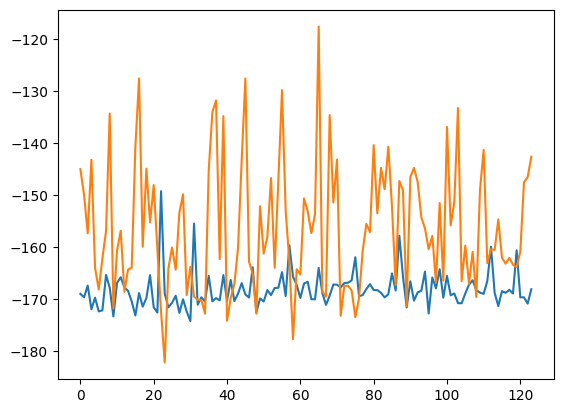

train_weighted_vae: enc
train: iter 0  trainloss -171.84164  validloss -160.85070±0.00000  bestvalidloss -160.85070  last_update 0
train: iter 1  trainloss -171.80459  validloss -159.25547±0.00000  bestvalidloss -160.85070  last_update 1
train: iter 2  trainloss -169.64040  validloss -157.49231±0.00000  bestvalidloss -160.85070  last_update 2
train: iter 3  trainloss -168.81231  validloss -162.84136±0.00000  bestvalidloss -162.84136  last_update 0
train: iter 4  trainloss -172.33723  validloss -148.91016±0.00000  bestvalidloss -162.84136  last_update 1
train: iter 5  trainloss -170.05256  validloss -162.37491±0.00000  bestvalidloss -162.84136  last_update 2
train: iter 6  trainloss -170.17267  validloss -155.82851±0.00000  bestvalidloss -162.84136  last_update 3
train: iter 7  trainloss -170.18954  validloss -148.46416±0.00000  bestvalidloss -162.84136  last_update 4
train: iter 8  trainloss -170.54419  validloss -163.52472±0.00000  bestvalidloss -163.52472  last_update 0
train: iter 9

train: iter 76  trainloss -168.05053  validloss -147.13339±0.00000  bestvalidloss -174.93312  last_update 45
train: iter 77  trainloss -172.14424  validloss -155.81706±0.00000  bestvalidloss -174.93312  last_update 46
train: iter 78  trainloss -168.82629  validloss -161.35091±0.00000  bestvalidloss -174.93312  last_update 47
train: iter 79  trainloss -172.84451  validloss -151.77858±0.00000  bestvalidloss -174.93312  last_update 48
train: iter 80  trainloss -171.35785  validloss -154.65653±0.00000  bestvalidloss -174.93312  last_update 49
train: iter 81  trainloss -172.69726  validloss -147.45262±0.00000  bestvalidloss -174.93312  last_update 50
train: iter 82  trainloss -171.01010  validloss -134.74453±0.00000  bestvalidloss -174.93312  last_update 51
train: iter 83  trainloss -173.96790  validloss -159.42889±0.00000  bestvalidloss -174.93312  last_update 52
train: iter 84  trainloss -173.70330  validloss -154.38368±0.00000  bestvalidloss -174.93312  last_update 53
train: iter 85  tra

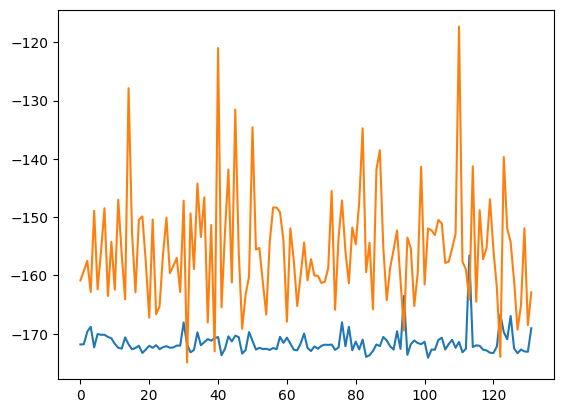

train_weighted_vae: dec
train: iter 0  trainloss -167.02415  validloss -153.89807±0.00000  bestvalidloss -153.89807  last_update 0
train: iter 1  trainloss -171.73231  validloss -154.61061±0.00000  bestvalidloss -154.61061  last_update 0
train: iter 2  trainloss -170.44758  validloss -139.71532±0.00000  bestvalidloss -154.61061  last_update 1
train: iter 3  trainloss -169.53157  validloss -138.68510±0.00000  bestvalidloss -154.61061  last_update 2
train: iter 4  trainloss -172.86688  validloss -143.70607±0.00000  bestvalidloss -154.61061  last_update 3
train: iter 5  trainloss -172.42740  validloss -139.92865±0.00000  bestvalidloss -154.61061  last_update 4
train: iter 6  trainloss -170.88148  validloss -142.54173±0.00000  bestvalidloss -154.61061  last_update 5
train: iter 7  trainloss -171.57390  validloss -143.21734±0.00000  bestvalidloss -154.61061  last_update 6
train: iter 8  trainloss -172.81009  validloss -143.70110±0.00000  bestvalidloss -154.61061  last_update 7
train: iter 9

train: iter 76  trainloss -169.85967  validloss -129.66974±0.00000  bestvalidloss -161.51884  last_update 31
train: iter 77  trainloss -171.04307  validloss -118.57446±0.00000  bestvalidloss -161.51884  last_update 32
train: iter 78  trainloss -166.92481  validloss -123.92732±0.00000  bestvalidloss -161.51884  last_update 33
train: iter 79  trainloss -170.52094  validloss -121.78282±0.00000  bestvalidloss -161.51884  last_update 34
train: iter 80  trainloss -171.43021  validloss -141.39102±0.00000  bestvalidloss -161.51884  last_update 35
train: iter 81  trainloss -171.59701  validloss -154.52260±0.00000  bestvalidloss -161.51884  last_update 36
train: iter 82  trainloss -173.28452  validloss -158.53787±0.00000  bestvalidloss -161.51884  last_update 37
train: iter 83  trainloss -171.71505  validloss -147.52274±0.00000  bestvalidloss -161.51884  last_update 38
train: iter 84  trainloss -168.89718  validloss -132.54401±0.00000  bestvalidloss -161.51884  last_update 39
train: iter 85  tra

train: iter 152  trainloss -172.20513  validloss -141.00226±0.00000  bestvalidloss -166.78067  last_update 31
train: iter 153  trainloss -172.16540  validloss -126.25844±0.00000  bestvalidloss -166.78067  last_update 32
train: iter 154  trainloss -171.62848  validloss -146.71737±0.00000  bestvalidloss -166.78067  last_update 33
train: iter 155  trainloss -173.87546  validloss -130.67733±0.00000  bestvalidloss -166.78067  last_update 34
train: iter 156  trainloss -173.04738  validloss -115.84776±0.00000  bestvalidloss -166.78067  last_update 35
train: iter 157  trainloss -171.14861  validloss -130.08883±0.00000  bestvalidloss -166.78067  last_update 36
train: iter 158  trainloss -168.55857  validloss -157.26317±0.00000  bestvalidloss -166.78067  last_update 37
train: iter 159  trainloss -172.27834  validloss -147.21911±0.00000  bestvalidloss -166.78067  last_update 38
train: iter 160  trainloss -172.19178  validloss -148.37387±0.00000  bestvalidloss -166.78067  last_update 39
train: ite

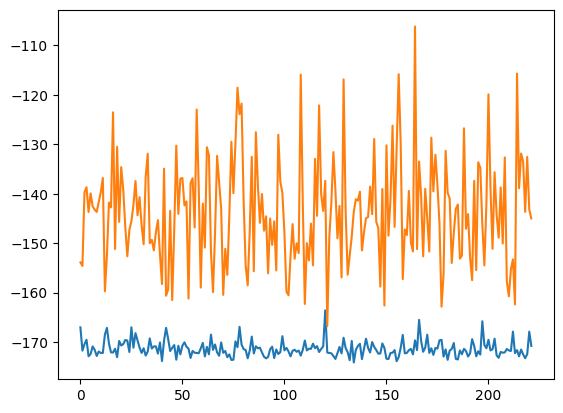

alpha 0.3 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.09148385821339329
1  c = 0.19677822148600232
2  c = 0.2273337713615298
3  c = 0.0792087102897038
4  c = 0.20555015683793504
5  c = 0.19176888264455483
6  c = 0.18267177166236348
7  c = 0.24402681472422738
8  c = 0.29423821451915294
9  c = 0.023790697391420857
10  c = 0.2020342306054244
11  c = 0.20684945695371632
12  c = 0.02913033904059362
13  c = 0.2978413218792869
14  c = 0.2747758512269614
15  c = 0.006994386212546632
16  c = 0.03535076766836032
17  c = 0.13544357115059946
18  c = 0.18210899671614134
19  c = 0.13599612539277364
20  c = 0.1247768865398707
21  c = 0.23814998276729366
22  c = 0.015975780921363047
23  c = 0.09585999466227044
24  c = 0.052946875921209564
25  c = 0.2663765731372429
26  c = 0.019230877798626898
27  c = 0.16076296690239142
28  c = 0.11395892260656697
29  c = 0.14109895294644367
30  c = 0.04506000808804537
31  c = 0.19249165795189413
32  c = 0.1524980033145635
33  c = 0.019390904569831568
34  c = 0.17628406257221338
35  c = 0.12850286406606606
36  

98  c = 0.05520951816998426
99  c = 0.1600013164038132
 
実環境方策rollout vs Sim環境方策rollout


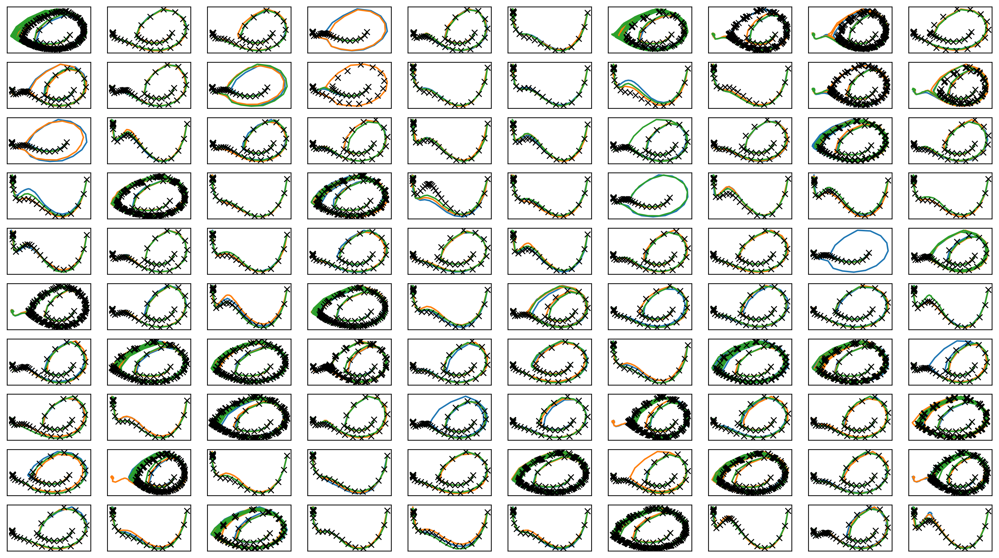

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

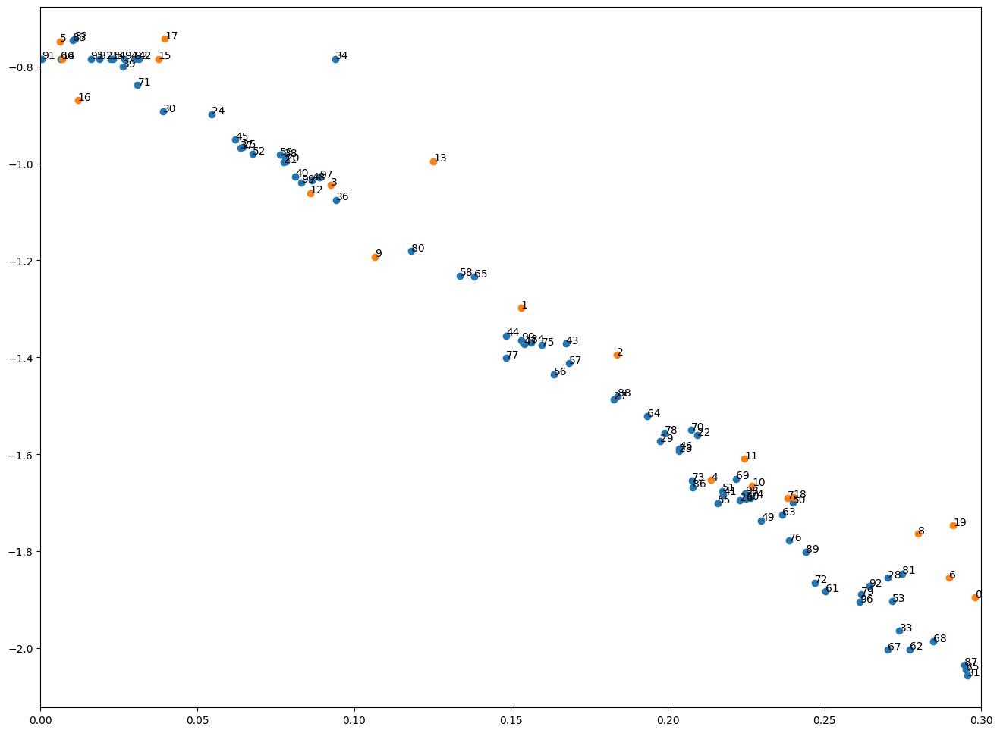

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-04-04 01:51:17.795782


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.02086387098206499
c = 0.010841425089774991
c = 0.19952530784024688
c = 0.13236779507673982
c = 0.027383800804752046
c = 0.14859421135292844
c = 0.008492157920843079
c = 0.06272295209971333
c = 0.06320585566195969
c = 0.09557938217925227
1  c = 0.05355934967882665
c = 0.25272044250494147
c = 0.10495840319545593
c = 0.15041436943832429
c = 0.21583365041233932
c = 0.04835363212909542
c = 0.13361158844159823
c = 0.19696429710976768
c = 0.0440683099094029
2  c = 0.18516227389484946
c = 0.016589603945366516
c = 0.08019316480839411
c = 0.15594445693933306
c = 0.01091022441269056
c = 0.0982906633429967
c = 0.12127372931560455
3  c = 0.15066683174515602
c = 0.12940211359665266
c = 0.005909638108446791
c = 0.1842423727004404
c = 0.14986092567860695
c = 0.08783565319428578
c = 0.13180667849292102
c = 0.1596390141406685
4  c = 0.13768198008353655
c = 0.24777067313955703
c = 0.17363351075424804
c = 0.008048397716354882
c = 0.16908084956331082
c = 0.1618174444593938
c = 0.26228129500680486


c = 0.14841286859714634
38  c = 0.040019066833930306
c = 0.03280545320881882
c = 0.09632354297690514
39  c = 0.269953842749464
c = 0.04033404150413065
c = 0.15821912013972741
c = 0.08641963761057107
c = 0.13851721483558074
c = 0.2475939017036386
c = 0.267436619608427
40  c = 0.14341513800415973
c = 0.2710748764864809
c = 0.031465914791562695
c = 0.20796462526146656
c = 0.06648608115111661
c = 0.15542868300508286
c = 0.23758423721468513
41  c = 0.1052409433250557
c = 0.08104611892500675
c = 0.17610091424193391
c = 0.29012332260432483
c = 0.2577968403583737
c = 0.014194820703049081
42  c = 0.2587599288969001
c = 0.2537616430690584
c = 0.06507518026106124
c = 0.056421706479945766
c = 0.037207994124354146
c = 0.23166334701344585
c = 0.10169173922102016
c = 0.27272397959300737
c = 0.08015461345560763
c = 0.044365762800049564
43  c = 0.14657773533857332
c = 0.141644762505809
c = 0.2505782142276811
c = 0.25547140206991664
44  c = 0.14237146220549493
c = 0.05175016618622181
c = 0.1085666273456

c = 0.06766094903759702
c = 0.10367971020407628
c = 0.059909812565362014
82  c = 0.010517973113360378
c = 0.20825082061847874
c = 0.22777840390455306
c = 0.20477909024649418
c = 0.17134435558594963
c = 0.1281793671623723
c = 0.29976425936496703
c = 0.2092049156631375
c = 0.16872948976529045
c = 0.08646509200145648
c = 0.17251462247690771
c = 0.09637075696810038
83  c = 0.09755674105449393
c = 0.27538558871246066
c = 0.130644685277917
c = 0.2844779079305362
c = 0.18927005119838367
c = 0.24603443927635196
c = 0.24666374748543185
c = 0.019521535646287013
c = 0.034351991196242236
84  c = 0.04651426466498419
c = 0.2542805006845653
c = 0.013527858392407976
c = 0.16013105984167406
c = 0.16617168850058772
c = 0.25217207290676963
c = 0.021301693778758134
c = 0.07172914782326507
c = 0.0446228854644433
c = 0.06601682859531419
c = 0.07582324685686527
c = 0.13772334898156385
c = 0.05463929731200732
c = 0.06587693731537393
85  c = 0.27786793184400005
c = 0.25064498007932473
c = 0.2635073154043643
c 

In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.12993  validloss 0.14954±0.00000  bestvalidloss 0.14954  last_update 0
train: iter 1  trainloss 0.12751  validloss 0.14669±0.00000  bestvalidloss 0.14669  last_update 0
train: iter 2  trainloss 0.12738  validloss 0.14681±0.00000  bestvalidloss 0.14669  last_update 1
train: iter 3  trainloss 0.12887  validloss 0.14846±0.00000  bestvalidloss 0.14669  last_update 2
train: iter 4  trainloss 0.12746  validloss 0.14624±0.00000  bestvalidloss 0.14624  last_update 0
train: iter 5  trainloss 0.12741  validloss 0.14651±0.00000  bestvalidloss 0.14624  last_update 1
train: iter 6  trainloss 0.12740  validloss 0.15030±0.00000  bestvalidloss 0.14624  last_update 2
train: iter 7  trainloss 0.12579  validloss 0.14788±0.00000  bestvalidloss 0.14624  last_update 3
train: iter 8  trainloss 0.12662  validloss 0.14706±0.00000  bestvalidloss 0.14624  last_update 4
train: iter 9  trainloss 0.12602  validloss 0.14495±0.00000  bestvalidloss 0.14495  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.12368  validloss 0.14859±0.00000  bestvalidloss 0.14121  last_update 9
train: iter 85  trainloss 0.12327  validloss 0.14425±0.00000  bestvalidloss 0.14121  last_update 10
train: iter 86  trainloss 0.12273  validloss 0.14353±0.00000  bestvalidloss 0.14121  last_update 11
train: iter 87  trainloss 0.12520  validloss 0.14473±0.00000  bestvalidloss 0.14121  last_update 12
train: iter 88  trainloss 0.12276  validloss 0.14430±0.00000  bestvalidloss 0.14121  last_update 13
train: iter 89  trainloss 0.12317  validloss 0.14325±0.00000  bestvalidloss 0.14121  last_update 14
train: iter 90  trainloss 0.12307  validloss 0.14472±0.00000  bestvalidloss 0.14121  last_update 15
train: iter 91  trainloss 0.12364  validloss 0.14294±0.00000  bestvalidloss 0.14121  last_update 16
train: iter 92  trainloss 0.12354  validloss 0.14194±0.00000  bestvalidloss 0.14121  last_update 17
train: iter 93  trainloss 0.12267  validloss 0.14261±0.00000  bestvalidloss 0.14121  last_update 18
t

train: iter 169  trainloss 0.12167  validloss 0.14952±0.00000  bestvalidloss 0.14121  last_update 94
train: iter 170  trainloss 0.12131  validloss 0.14271±0.00000  bestvalidloss 0.14121  last_update 95
train: iter 171  trainloss 0.12126  validloss 0.14184±0.00000  bestvalidloss 0.14121  last_update 96
train: iter 172  trainloss 0.12133  validloss 0.14400±0.00000  bestvalidloss 0.14121  last_update 97
train: iter 173  trainloss 0.12139  validloss 0.14137±0.00000  bestvalidloss 0.14121  last_update 98
train: iter 174  trainloss 0.12156  validloss 0.14458±0.00000  bestvalidloss 0.14121  last_update 99
train: iter 175  trainloss 0.12086  validloss 0.14136±0.00000  bestvalidloss 0.14121  last_update 100
train: fin


In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -210.7763668614626
valid_loss:  -281.4547026062011
train_loss:  -187.89946450471876
valid_loss:  -164.4879168701172


1e-08 1000.0


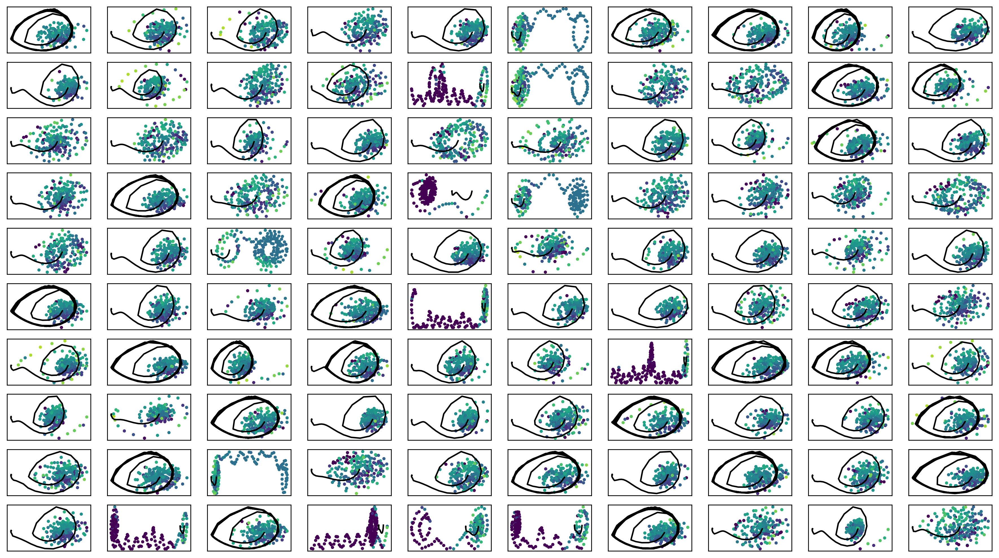

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -177.69741  validloss -159.05479±0.00000  bestvalidloss -159.05479  last_update 0
train: iter 1  trainloss -180.93461  validloss -191.14144±0.00000  bestvalidloss -191.14144  last_update 0
train: iter 2  trainloss -183.26630  validloss -178.24014±0.00000  bestvalidloss -191.14144  last_update 1
train: iter 3  trainloss -183.86473  validloss -166.30905±0.00000  bestvalidloss -191.14144  last_update 2
train: iter 4  trainloss -178.13601  validloss -160.73553±0.00000  bestvalidloss -191.14144  last_update 3
train: iter 5  trainloss -184.63851  validloss -180.78659±0.00000  bestvalidloss -191.14144  last_update 4
train: iter 6  trainloss -184.10626  validloss -172.04060±0.00000  bestvalidloss -191.14144  last_update 5
train: iter 7  trainloss -178.38469  validloss -160.14546±0.00000  bestvalidloss -191.14144  last_update 6
train: iter 8  trainloss -183.72036  validloss -146.17821±0.00000  bestvalidloss -191.14144  last_update 7
train: it

train: iter 76  trainloss -182.30291  validloss -180.23764±0.00000  bestvalidloss -191.14144  last_update 75
train: iter 77  trainloss -182.00559  validloss -161.83607±0.00000  bestvalidloss -191.14144  last_update 76
train: iter 78  trainloss -181.92571  validloss -173.67573±0.00000  bestvalidloss -191.14144  last_update 77
train: iter 79  trainloss -180.08153  validloss -153.06693±0.00000  bestvalidloss -191.14144  last_update 78
train: iter 80  trainloss -174.57614  validloss -125.13595±0.00000  bestvalidloss -191.14144  last_update 79
train: iter 81  trainloss -177.70711  validloss -167.55827±0.00000  bestvalidloss -191.14144  last_update 80
train: iter 82  trainloss -178.54528  validloss -162.40464±0.00000  bestvalidloss -191.14144  last_update 81
train: iter 83  trainloss -181.52920  validloss -165.87212±0.00000  bestvalidloss -191.14144  last_update 82
train: iter 84  trainloss -179.60060  validloss -172.27772±0.00000  bestvalidloss -191.14144  last_update 83
train: iter 85  tra

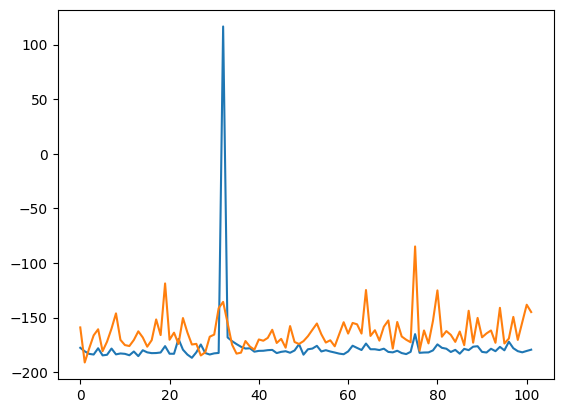

train_weighted_vae: enc
train: iter 0  trainloss -178.26283  validloss -170.52211±0.00000  bestvalidloss -170.52211  last_update 0
train: iter 1  trainloss -179.15195  validloss -149.61900±0.00000  bestvalidloss -170.52211  last_update 1
train: iter 2  trainloss -178.76732  validloss -170.11455±0.00000  bestvalidloss -170.52211  last_update 2
train: iter 3  trainloss -179.67257  validloss -167.09223±0.00000  bestvalidloss -170.52211  last_update 3
train: iter 4  trainloss -181.44560  validloss -173.66856±0.00000  bestvalidloss -173.66856  last_update 0
train: iter 5  trainloss -181.67439  validloss -167.68343±0.00000  bestvalidloss -173.66856  last_update 1
train: iter 6  trainloss -179.73605  validloss -162.04503±0.00000  bestvalidloss -173.66856  last_update 2
train: iter 7  trainloss -181.48499  validloss -140.98773±0.00000  bestvalidloss -173.66856  last_update 3
train: iter 8  trainloss -180.37492  validloss -166.03106±0.00000  bestvalidloss -173.66856  last_update 4
train: iter 9

train: iter 77  trainloss -180.93306  validloss -152.03095±0.00000  bestvalidloss -175.65180  last_update 6
train: iter 78  trainloss -180.88826  validloss -157.87739±0.00000  bestvalidloss -175.65180  last_update 7
train: iter 79  trainloss -181.23701  validloss -167.96750±0.00000  bestvalidloss -175.65180  last_update 8
train: iter 80  trainloss -181.13701  validloss -159.44246±0.00000  bestvalidloss -175.65180  last_update 9
train: iter 81  trainloss -180.93834  validloss -158.86167±0.00000  bestvalidloss -175.65180  last_update 10
train: iter 82  trainloss -181.97172  validloss -173.77871±0.00000  bestvalidloss -175.65180  last_update 11
train: iter 83  trainloss -181.07221  validloss -156.33890±0.00000  bestvalidloss -175.65180  last_update 12
train: iter 84  trainloss -181.91937  validloss -162.76142±0.00000  bestvalidloss -175.65180  last_update 13
train: iter 85  trainloss -181.43660  validloss -167.14089±0.00000  bestvalidloss -175.65180  last_update 14
train: iter 86  trainlo

train: iter 153  trainloss -180.46116  validloss -173.97154±0.00000  bestvalidloss -177.45008  last_update 19
train: iter 154  trainloss -178.37352  validloss -155.09995±0.00000  bestvalidloss -177.45008  last_update 20
train: iter 155  trainloss -179.86391  validloss -160.04559±0.00000  bestvalidloss -177.45008  last_update 21
train: iter 156  trainloss -180.46562  validloss -150.46150±0.00000  bestvalidloss -177.45008  last_update 22
train: iter 157  trainloss -178.99561  validloss -149.55271±0.00000  bestvalidloss -177.45008  last_update 23
train: iter 158  trainloss -176.15907  validloss -166.66548±0.00000  bestvalidloss -177.45008  last_update 24
train: iter 159  trainloss -178.62804  validloss -138.45935±0.00000  bestvalidloss -177.45008  last_update 25
train: iter 160  trainloss -180.89009  validloss -172.40413±0.00000  bestvalidloss -177.45008  last_update 26
train: iter 161  trainloss -181.52633  validloss -166.11968±0.00000  bestvalidloss -177.45008  last_update 27
train: ite

train: iter 229  trainloss -181.13171  validloss -166.72410±0.00000  bestvalidloss -177.45008  last_update 95
train: iter 230  trainloss -179.91505  validloss -159.80880±0.00000  bestvalidloss -177.45008  last_update 96
train: iter 231  trainloss -181.76223  validloss -172.81383±0.00000  bestvalidloss -177.45008  last_update 97
train: iter 232  trainloss -179.78783  validloss -151.45303±0.00000  bestvalidloss -177.45008  last_update 98
train: iter 233  trainloss -180.01904  validloss -145.65439±0.00000  bestvalidloss -177.45008  last_update 99
train: iter 234  trainloss -182.45304  validloss -161.88978±0.00000  bestvalidloss -177.45008  last_update 100
train: fin


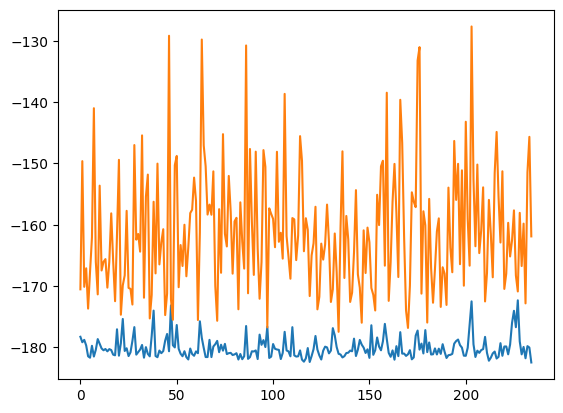

train_weighted_vae: dec
train: iter 0  trainloss -182.79395  validloss -171.57313±0.00000  bestvalidloss -171.57313  last_update 0
train: iter 1  trainloss -184.49354  validloss -164.88667±0.00000  bestvalidloss -171.57313  last_update 1
train: iter 2  trainloss -184.11443  validloss -169.35587±0.00000  bestvalidloss -171.57313  last_update 2
train: iter 3  trainloss -182.41456  validloss -148.40529±0.00000  bestvalidloss -171.57313  last_update 3
train: iter 4  trainloss -183.07241  validloss -132.06390±0.00000  bestvalidloss -171.57313  last_update 4
train: iter 5  trainloss -183.70035  validloss -157.67114±0.00000  bestvalidloss -171.57313  last_update 5
train: iter 6  trainloss -184.18563  validloss -157.69001±0.00000  bestvalidloss -171.57313  last_update 6
train: iter 7  trainloss -183.27072  validloss -140.66827±0.00000  bestvalidloss -171.57313  last_update 7
train: iter 8  trainloss -182.84510  validloss -166.36533±0.00000  bestvalidloss -171.57313  last_update 8
train: iter 9

train: iter 76  trainloss -183.54577  validloss -155.22779±0.00000  bestvalidloss -171.57313  last_update 76
train: iter 77  trainloss -182.17421  validloss -163.10300±0.00000  bestvalidloss -171.57313  last_update 77
train: iter 78  trainloss -180.70094  validloss -147.65329±0.00000  bestvalidloss -171.57313  last_update 78
train: iter 79  trainloss -184.13874  validloss -161.81440±0.00000  bestvalidloss -171.57313  last_update 79
train: iter 80  trainloss -184.43863  validloss -151.36118±0.00000  bestvalidloss -171.57313  last_update 80
train: iter 81  trainloss -183.56009  validloss -150.99161±0.00000  bestvalidloss -171.57313  last_update 81
train: iter 82  trainloss -185.83484  validloss -159.19685±0.00000  bestvalidloss -171.57313  last_update 82
train: iter 83  trainloss -184.41383  validloss -153.86771±0.00000  bestvalidloss -171.57313  last_update 83
train: iter 84  trainloss -184.68890  validloss -138.81911±0.00000  bestvalidloss -171.57313  last_update 84
train: iter 85  tra

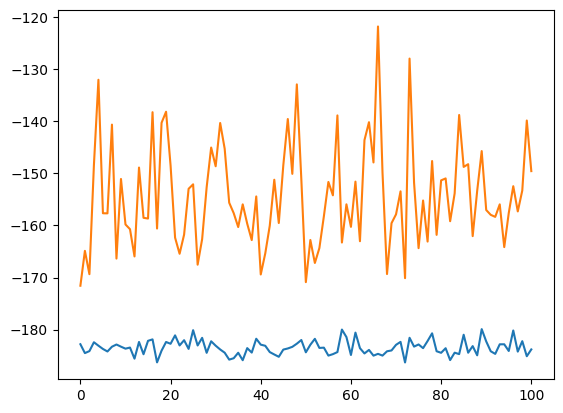

alpha 0.3 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.04431516984872743
1  c = 0.10874927172983001
2  c = 0.21685009479950498
3  c = 0.11434808139118496
4  c = 0.19207418560607595
5  c = 0.0027267896249776103
6  c = 0.08084131396785284
7  c = 0.17566554457815667
8  c = 0.04892792937525887
9  c = 0.02855364593235461
10  c = 0.057193687323415794
11  c = 0.1453220577465025
12  c = 0.24622010383455115
13  c = 0.004289638385519501
14  c = 0.18085585989094402
15  c = 0.2755911585973103
16  c = 0.09562927521152759
17  c = 0.20294890816553027
18  c = 0.1014635702292359
19  c = 0.2116287567127008
20  c = 0.2060594942312159
21  c = 0.2854798523937928
22  c = 0.05596825765204788
23  c = 0.014738224621019112
24  c = 0.08058004729867632
25  c = 0.028079292696132897
26  c = 0.13635539512374065
27  c = 0.13575420538107172
28  c = 0.04618397146287257
29  c = 0.23169298841797006
30  c = 0.1468505863544505
31  c = 0.07499828532381753
32  c = 0.294809867186907
33  c = 0.03308870423444743
34  c = 0.23512460846050545
35  c = 0.04858226493017169
36  c

99  c = 0.2875387588174908
 
実環境方策rollout vs Sim環境方策rollout


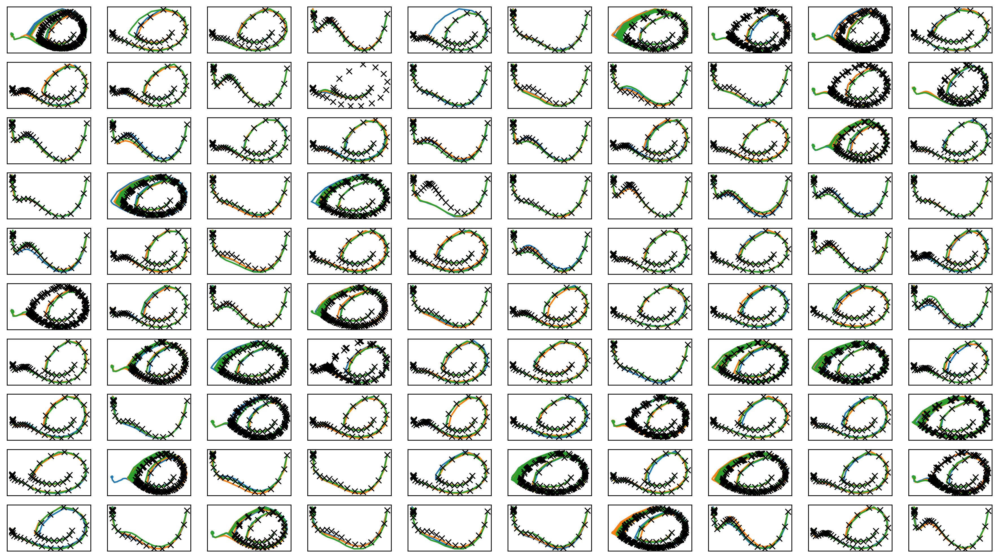

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

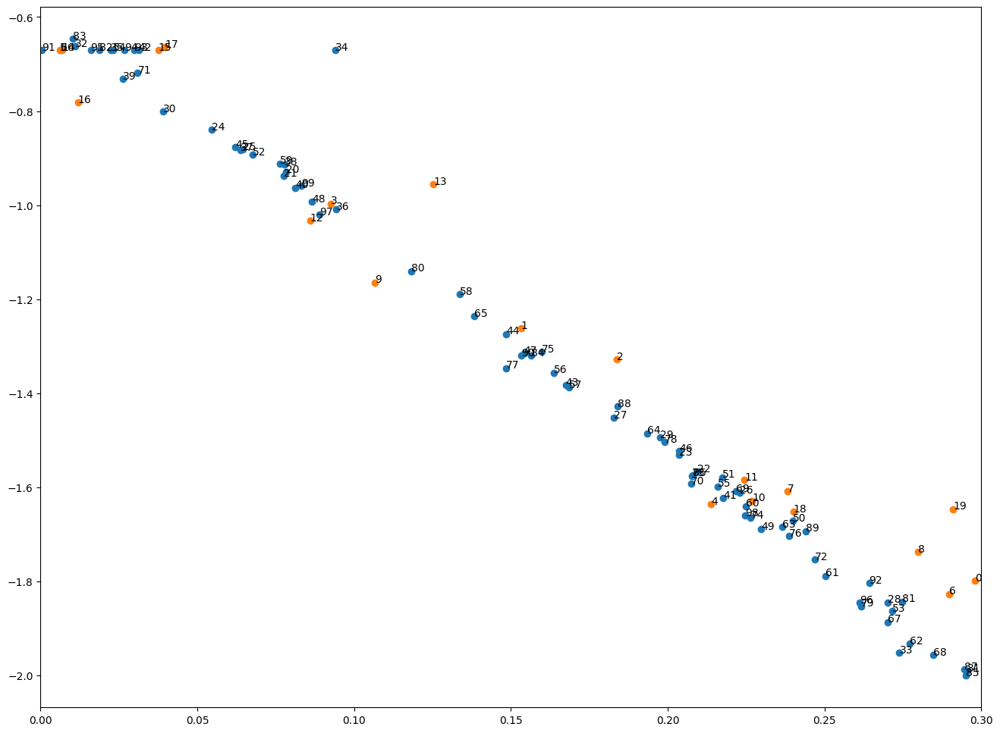

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-04-04 01:53:28.169121


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.057530368951230454
c = 0.12786648047122678
c = 0.10691667951159768
c = 0.045502322717939005
c = 0.10682224675591317
c = 0.2875710153960633
c = 0.16864951138662324
c = 0.05744351993381869
c = 0.023253553079672685
c = 0.28779542040917905
1  c = 0.14155072192217943
c = 0.07993687542695642
c = 0.24592709336035884
c = 0.008887647494890337
c = 0.06442433967763651
c = 0.17058263275753857
c = 0.08767514861655869
c = 0.29629215506595197
c = 0.28881875617122715
c = 0.0522162376293258
2  c = 0.03950575663061277
c = 0.13694020238176002
c = 0.19760450351027675
c = 0.2905728262984227
c = 0.1650823544062542
c = 0.2679641124681452
c = 0.01830248096460737
c = 0.016947378652839493
c = 0.23502338437641374
c = 0.18294199633673203
c = 0.060061558392056874
3  c = 0.2855461948951609
c = 0.2160885043888056
c = 0.17445894451405608
c = 0.2083755806907642
c = 0.058697910356699495
c = 0.2176626430183115
c = 0.2708622529635024
c = 0.060365487776253196
c = 0.2542419659312831
c = 0.2355636047057502
4  c = 0

c = 0.22388855841604552
c = 0.08829320291287422
c = 0.10122357974346066
37  c = 0.0985350974099181
c = 0.1024669130023008
c = 0.0011884610174187293
c = 0.07647126980624276
c = 0.05051982071004398
c = 0.06645044648938307
c = 0.2084197340273864
c = 0.24400293900462683
c = 0.2675403313161017
c = 0.28358192401409016
38  c = 0.05700830692546951
c = 0.19563668246424798
c = 0.2837759715895195
c = 0.0692614461420218
c = 0.2762774031526268
c = 0.2687435575460893
c = 0.14963951571892456
c = 0.13023395338659957
c = 0.042525987009671605
39  c = 0.21105262762016266
c = 0.1313262163130439
c = 0.11253843346931965
c = 0.023777195252672023
c = 0.02918953826509424
c = 0.03313632006610634
c = 0.26377071269804975
c = 0.1295850628841528
40  c = 0.0701982365281323
c = 0.04143904821998856
c = 0.2808229651159681
c = 0.028294918015714154
c = 0.07413631667528316
c = 0.09476177902475909
c = 0.24457616207756533
c = 0.028887957450752608
41  c = 0.21939902819856666
c = 0.14692948533374006
c = 0.28516774029563136
c 

c = 0.014647396210614816
c = 0.12412823739328056
c = 0.25180037438000824
c = 0.13229236288659277
c = 0.08649488436978682
75  c = 0.07477537881234195
c = 0.29705475135759934
c = 0.025769058572540936
c = 0.2653841061277332
c = 0.013669890310833377
76  c = 0.09633685684410202
c = 0.1763368264860363
c = 0.2927065563293984
c = 0.16108978731510798
c = 0.07088148354134818
c = 0.09398669491170272
c = 0.04567670616124185
c = 0.20545302677025312
c = 0.22166554406358752
c = 0.1522765803943546
c = 0.1634952750502924
c = 0.04661067033107664
c = 0.29028891718953237
c = 0.2831838417714458
c = 0.22228440820976256
c = 0.20552298409620384
c = 0.21503196235158376
77  c = 0.2608208735099767
c = 0.06307720164376777
c = 0.17840654740047943
c = 0.1264350351872475
c = 0.017657751120454167
c = 0.16443896876009886
c = 0.02779847167849785
78  c = 0.01185414631921906
c = 0.07142071637153509
c = 0.180468835298187
c = 0.04003959441652931
c = 0.1271023942466509
79  c = 0.14973983798165888
c = 0.02509129910470551
c =

In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.12719  validloss 0.14778±0.00000  bestvalidloss 0.14778  last_update 0
train: iter 1  trainloss 0.12331  validloss 0.14661±0.00000  bestvalidloss 0.14661  last_update 0
train: iter 2  trainloss 0.12429  validloss 0.14576±0.00000  bestvalidloss 0.14576  last_update 0
train: iter 3  trainloss 0.12353  validloss 0.15032±0.00000  bestvalidloss 0.14576  last_update 1
train: iter 4  trainloss 0.12277  validloss 0.14679±0.00000  bestvalidloss 0.14576  last_update 2
train: iter 5  trainloss 0.12264  validloss 0.14514±0.00000  bestvalidloss 0.14514  last_update 0
train: iter 6  trainloss 0.12207  validloss 0.14824±0.00000  bestvalidloss 0.14514  last_update 1
train: iter 7  trainloss 0.12302  validloss 0.14698±0.00000  bestvalidloss 0.14514  last_update 2
train: iter 8  trainloss 0.12185  validloss 0.14561±0.00000  bestvalidloss 0.14514  last_update 3
train: iter 9  trainloss 0.12184  validloss 0.14593±0.00000  bestvalidloss 0.14514  last_update 4
train: iter 10  trai

train: iter 87  trainloss 0.11959  validloss 0.15174±0.00000  bestvalidloss 0.14514  last_update 82
train: iter 88  trainloss 0.11953  validloss 0.15060±0.00000  bestvalidloss 0.14514  last_update 83
train: iter 89  trainloss 0.11894  validloss 0.14983±0.00000  bestvalidloss 0.14514  last_update 84
train: iter 90  trainloss 0.11909  validloss 0.14649±0.00000  bestvalidloss 0.14514  last_update 85
train: iter 91  trainloss 0.11979  validloss 0.14732±0.00000  bestvalidloss 0.14514  last_update 86
train: iter 92  trainloss 0.11870  validloss 0.14800±0.00000  bestvalidloss 0.14514  last_update 87
train: iter 93  trainloss 0.11914  validloss 0.14894±0.00000  bestvalidloss 0.14514  last_update 88
train: iter 94  trainloss 0.11885  validloss 0.14977±0.00000  bestvalidloss 0.14514  last_update 89
train: iter 95  trainloss 0.11930  validloss 0.15211±0.00000  bestvalidloss 0.14514  last_update 90
train: iter 96  trainloss 0.11987  validloss 0.15026±0.00000  bestvalidloss 0.14514  last_update 91


In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -181.3097454124689
valid_loss:  -196.2833339869976
train_loss:  -189.40599064916373
valid_loss:  -139.279209690094


In [66]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


train: iter 0  trainloss 4.91801  validloss 5.33852±0.00000  bestvalidloss 5.33852  last_update 0
train: iter 1  trainloss 4.46089  validloss 4.80345±0.00000  bestvalidloss 4.80345  last_update 0
train: iter 2  trainloss 4.07822  validloss 4.40107±0.00000  bestvalidloss 4.40107  last_update 0
train: iter 3  trainloss 3.75997  validloss 4.04314±0.00000  bestvalidloss 4.04314  last_update 0
train: iter 4  trainloss 3.49713  validloss 3.71714±0.00000  bestvalidloss 3.71714  last_update 0
train: iter 5  trainloss 3.26713  validloss 3.47105±0.00000  bestvalidloss 3.47105  last_update 0
train: iter 6  trainloss 3.07013  validloss 3.24975±0.00000  bestvalidloss 3.24975  last_update 0
train: iter 7  trainloss 2.89607  validloss 3.05246±0.00000  bestvalidloss 3.05246  last_update 0
train: iter 8  trainloss 2.75249  validloss 2.89536±0.00000  bestvalidloss 2.89536  last_update 0
train: iter 9  trainloss 2.61788  validloss 2.76494±0.00000  bestvalidloss 2.76494  last_update 0
train: iter 10  trai

train: iter 90  trainloss 0.58483  validloss 0.56779±0.00000  bestvalidloss 0.55589  last_update 7
train: iter 91  trainloss 0.59493  validloss 0.55215±0.00000  bestvalidloss 0.55215  last_update 0
train: iter 92  trainloss 0.58724  validloss 0.56346±0.00000  bestvalidloss 0.55215  last_update 1
train: iter 93  trainloss 0.59265  validloss 0.54827±0.00000  bestvalidloss 0.54827  last_update 0
train: iter 94  trainloss 0.58135  validloss 0.54336±0.00000  bestvalidloss 0.54336  last_update 0
train: iter 95  trainloss 0.58686  validloss 0.55535±0.00000  bestvalidloss 0.54336  last_update 1
train: iter 96  trainloss 0.58937  validloss 0.55573±0.00000  bestvalidloss 0.54336  last_update 2
train: iter 97  trainloss 0.59132  validloss 0.55139±0.00000  bestvalidloss 0.54336  last_update 3
train: iter 98  trainloss 0.58913  validloss 0.55690±0.00000  bestvalidloss 0.54336  last_update 4
train: iter 99  trainloss 0.58214  validloss 0.55244±0.00000  bestvalidloss 0.54336  last_update 5
train: ite

train: iter 172  trainloss 0.59014  validloss 0.56175±0.00000  bestvalidloss 0.53630  last_update 26
train: iter 173  trainloss 0.58548  validloss 0.54895±0.00000  bestvalidloss 0.53630  last_update 27
train: iter 174  trainloss 0.59416  validloss 0.55083±0.00000  bestvalidloss 0.53630  last_update 28
train: iter 175  trainloss 0.58421  validloss 0.55370±0.00000  bestvalidloss 0.53630  last_update 29
train: iter 176  trainloss 0.58083  validloss 0.53727±0.00000  bestvalidloss 0.53630  last_update 30
train: iter 177  trainloss 0.58266  validloss 0.56289±0.00000  bestvalidloss 0.53630  last_update 31
train: iter 178  trainloss 0.59699  validloss 0.53625±0.00000  bestvalidloss 0.53625  last_update 0
train: iter 179  trainloss 0.58649  validloss 0.54754±0.00000  bestvalidloss 0.53625  last_update 1
train: iter 180  trainloss 0.59473  validloss 0.55309±0.00000  bestvalidloss 0.53625  last_update 2
train: iter 181  trainloss 0.59249  validloss 0.56670±0.00000  bestvalidloss 0.53625  last_upd

train: iter 270  trainloss 0.59410  validloss 0.53682±0.00000  bestvalidloss 0.53625  last_update 92
train: iter 271  trainloss 0.58764  validloss 0.56340±0.00000  bestvalidloss 0.53625  last_update 93
train: iter 272  trainloss 0.58832  validloss 0.56536±0.00000  bestvalidloss 0.53625  last_update 94
train: iter 273  trainloss 0.58555  validloss 0.55109±0.00000  bestvalidloss 0.53625  last_update 95
train: iter 274  trainloss 0.58847  validloss 0.56600±0.00000  bestvalidloss 0.53625  last_update 96
train: iter 275  trainloss 0.58923  validloss 0.55876±0.00000  bestvalidloss 0.53625  last_update 97
train: iter 276  trainloss 0.58298  validloss 0.56110±0.00000  bestvalidloss 0.53625  last_update 98
train: iter 277  trainloss 0.58246  validloss 0.56258±0.00000  bestvalidloss 0.53625  last_update 99
train: iter 278  trainloss 0.58697  validloss 0.54805±0.00000  bestvalidloss 0.53625  last_update 100
train: fin


In [67]:
print(iwvi.initial_belief)


Parameter containing:
tensor([-1.3193, -1.6650], requires_grad=True)


In [69]:
train_curve, valid_curve = iwvi.train_penalty(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100)

train: iter 0  trainloss 26.13968  validloss 29.94281±0.00000  bestvalidloss 29.94281  last_update 0
train: iter 1  trainloss 14.52728  validloss 21.34975±0.00000  bestvalidloss 21.34975  last_update 0
train: iter 2  trainloss 8.52536  validloss 14.75043±0.00000  bestvalidloss 14.75043  last_update 0
train: iter 3  trainloss 5.80848  validloss 11.09100±0.00000  bestvalidloss 11.09100  last_update 0
train: iter 4  trainloss 4.38100  validloss 11.18259±0.00000  bestvalidloss 11.09100  last_update 1
train: iter 5  trainloss 3.59398  validloss 11.56646±0.00000  bestvalidloss 11.09100  last_update 2
train: iter 6  trainloss 3.23011  validloss 10.80379±0.00000  bestvalidloss 10.80379  last_update 0
train: iter 7  trainloss 2.99630  validloss 11.72249±0.00000  bestvalidloss 10.80379  last_update 1
train: iter 8  trainloss 2.88885  validloss 9.13359±0.00000  bestvalidloss 9.13359  last_update 0
train: iter 9  trainloss 2.84564  validloss 10.49564±0.00000  bestvalidloss 9.13359  last_update 1
t

train: iter 82  trainloss 1.88500  validloss 10.94580±0.00000  bestvalidloss 8.29371  last_update 27
train: iter 83  trainloss 1.84720  validloss 10.21576±0.00000  bestvalidloss 8.29371  last_update 28
train: iter 84  trainloss 1.91379  validloss 11.08067±0.00000  bestvalidloss 8.29371  last_update 29
train: iter 85  trainloss 1.86899  validloss 8.97819±0.00000  bestvalidloss 8.29371  last_update 30
train: iter 86  trainloss 1.82925  validloss 12.63146±0.00000  bestvalidloss 8.29371  last_update 31
train: iter 87  trainloss 1.85521  validloss 10.34160±0.00000  bestvalidloss 8.29371  last_update 32
train: iter 88  trainloss 1.83494  validloss 14.20780±0.00000  bestvalidloss 8.29371  last_update 33
train: iter 89  trainloss 1.82115  validloss 10.66772±0.00000  bestvalidloss 8.29371  last_update 34
train: iter 90  trainloss 1.84445  validloss 9.90287±0.00000  bestvalidloss 8.29371  last_update 35
train: iter 91  trainloss 1.83257  validloss 10.71955±0.00000  bestvalidloss 8.29371  last_up

train: iter 163  trainloss 1.77397  validloss 8.84147±0.00000  bestvalidloss 8.04213  last_update 38
train: iter 164  trainloss 1.75079  validloss 10.93607±0.00000  bestvalidloss 8.04213  last_update 39
train: iter 165  trainloss 1.75096  validloss 8.70337±0.00000  bestvalidloss 8.04213  last_update 40
train: iter 166  trainloss 1.77394  validloss 9.12244±0.00000  bestvalidloss 8.04213  last_update 41
train: iter 167  trainloss 1.81199  validloss 8.68176±0.00000  bestvalidloss 8.04213  last_update 42
train: iter 168  trainloss 1.76657  validloss 12.05234±0.00000  bestvalidloss 8.04213  last_update 43
train: iter 169  trainloss 1.82302  validloss 12.11956±0.00000  bestvalidloss 8.04213  last_update 44
train: iter 170  trainloss 1.76247  validloss 10.95250±0.00000  bestvalidloss 8.04213  last_update 45
train: iter 171  trainloss 1.77493  validloss 9.88670±0.00000  bestvalidloss 8.04213  last_update 46
train: iter 172  trainloss 1.80997  validloss 11.17323±0.00000  bestvalidloss 8.04213  

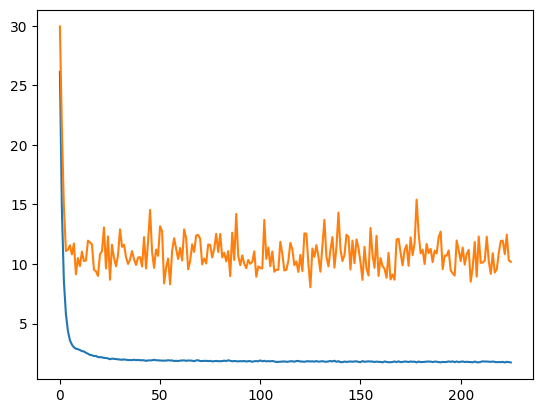

In [70]:
plt.plot(train_curve)
plt.plot(valid_curve)

In [71]:
iwvi.save()

In [72]:
loss_array = np.array(loss_list)

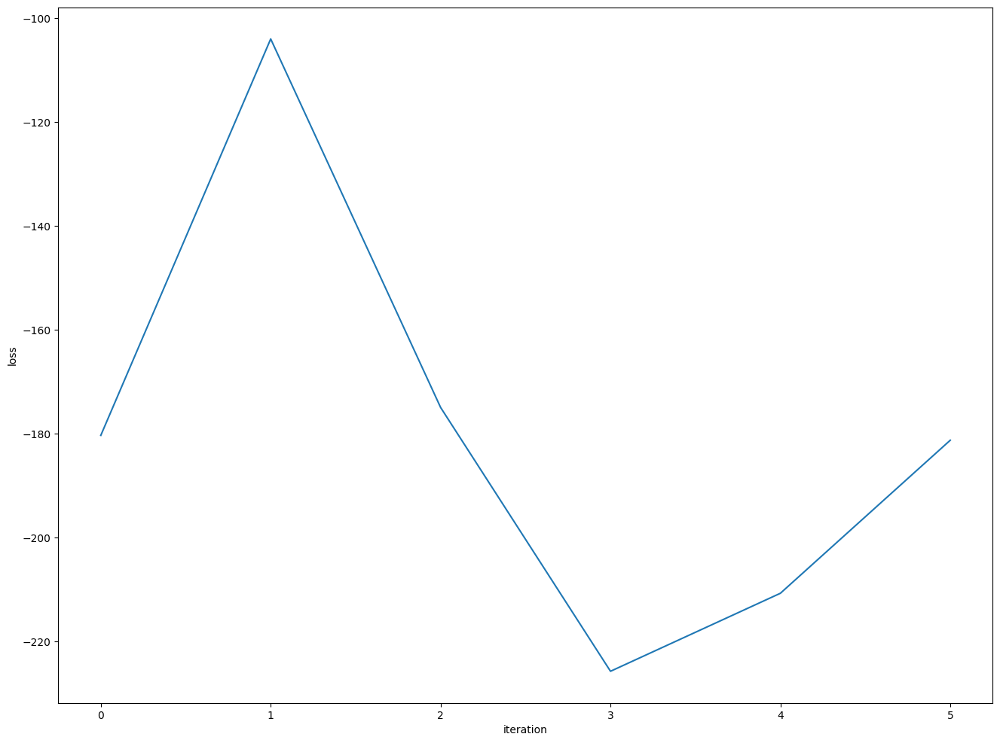

In [73]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.png")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.eps")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

Text(0, 0.5, 'loss')

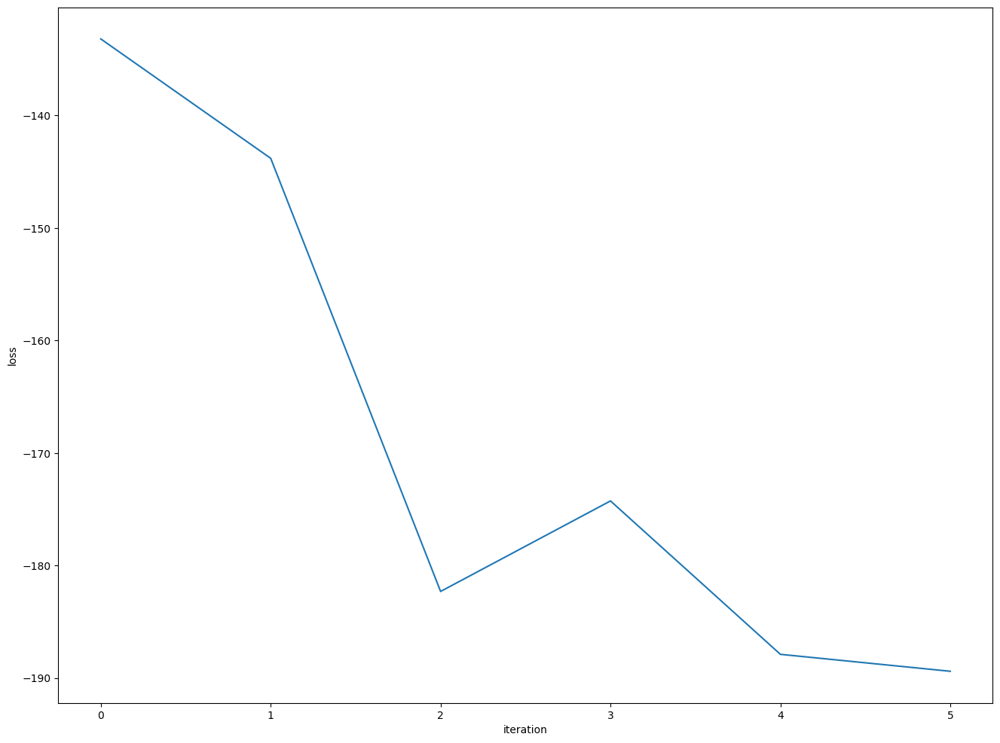

In [74]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")